# Loading Packages

In [170]:
import re 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn.model_selection import train_test_split
import random 
import math
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.utils as torch_utils
from torch.utils.data import TensorDataset, DataLoader, Dataset
from tqdm import tqdm_notebook
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import torch.nn.functional as F
import d2l
import time
import traceback
import fastprogress
from torchmetrics.classification import BinaryAccuracy, Accuracy 
import torch.nn.init as init
import torch.optim.lr_scheduler as lr_scheduler
from itertools import repeat
from torch.optim.lr_scheduler import ReduceLROnPlateau
import datetime
import h5py
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [171]:
from datetime import datetime

# Get the current date and time
current_datetime = datetime.now()

# Format the date and time
current_datetime = current_datetime.strftime('%d%m%y')

print(current_datetime)


041024


In [172]:
seed = 100
torch.manual_seed(seed)
np.random.seed(seed)

In [173]:
# Check if CUDA (GPU support) is available
if torch.cuda.is_available():
    # Set the device to the first available GPU
    device = torch.device("cuda:0")
else:
    # If GPU is not available, use the CPU
    device = torch.device("cpu")

In [15]:
# Get the current working directory
current_dir = os.getcwd()

# Define the relative path to the desired directory
relative_path = "data"

# Combine the current directory with the relative path to get the absolute path
absolute_path = os.path.join(current_dir, relative_path)
os.chdir(absolute_path)
#print(os.getcwd())

FileNotFoundError: [WinError 2] The system cannot find the file specified: 'c:\\Users\\kacpe\\Desktop\\lab_rotation_git\\data\\data'

In [8]:
os.getcwd()

'c:\\Users\\kacpe\\Desktop\\lab_rotation_git\\data'

In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cpu


# HDF5 data

In [ ]:
# Open the HDF5 file
file_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/data/hdf_fixed/HVM_20220916_v2.hdf5'
with h5py.File(file_path, 'r') as hdf:
    # List all groups
    print("Keys: %s" % hdf.keys())
    
    # Get the dataset
    dataset = hdf['mapped/arWrist']
    
    # Convert dataset to numpy array
    data = dataset[:]
    
    print(data)

In [ ]:
data.T.shape

In [ ]:
def get_dataset_names(group, prefix=''):
    datasets = []
    for key in group.keys():
        item = group[key]
        if isinstance(item, h5py.Dataset):
            datasets.append(prefix + key)
        elif isinstance(item, h5py.Group):
            datasets.extend(get_dataset_names(item, prefix + key + '/'))
    return datasets

# Path to your HDF5 file
file_path = 'HVM_20220916_v2.hdf5'

# Open the HDF5 file
with h5py.File(file_path, 'r') as hdf:
    # Get all dataset names
    dataset_names = get_dataset_names(hdf)
    print("Datasets:", dataset_names)

In [ ]:
import pandas as pd

# Define the file paths
csv_file_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/data/hdf_fixed/data_h_trials_20220915.csv'
hdf5_file_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/data/hdf_fixed/data_h_trials_20220915.h5'

# Read the CSV file into a pandas DataFrame
df = pd.read_csv(csv_file_path)

# Create a new HDF5 file and add datasets
with h5py.File(hdf5_file_path, 'w') as hdf:
    for column in df.columns:
        data = df[column].values
        dataset = hdf.create_dataset(column, data=data)
        dataset.attrs['column_name'] = column

print("Transformation from CSV to HDF5 with the correct structure completed successfully.")

In [23]:
import h5py
import pandas as pd
import os
import numpy as np  # Make sure to import numpy if you haven't already

# Assuming HVM is defined and is a list or array-like object
for i in np.arange(len(HVM)):
    # Use f-string correctly
    hdf5_file_path = f'C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/{HVM[i]}_compatibleSessions.hdf5'
    output_dir = f'C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/{HVM[i]}'
    
    # Create the output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    # Open the HDF5 file
    with h5py.File(hdf5_file_path, 'r') as hdf:
        # Access the 'relpos' group inside 'mocap'
        relpos_group = hdf['mocap']['relpos']
        
        # Iterate through all datasets inside 'relpos'
        for dataset_name in relpos_group.keys():
            dataset = relpos_group[dataset_name][:]
            
            # Convert the dataset to a pandas DataFrame
            df = pd.DataFrame(dataset)
            
            # Replace NaN values with the string 'NaN'
            #df.fillna('NaN', inplace=True)
            
            # Define CSV output file path
            csv_output_path = os.path.normpath(os.path.join(output_dir, f"{dataset_name}.csv"))
            
            # Save DataFrame to a CSV file
            try:
                df.to_csv(csv_output_path, index=False)
                print(f"Saved dataset '{dataset_name}' to {csv_output_path} (NaN values replaced with 'NaN').")
            except PermissionError as e:
                print(f"Permission denied when trying to save '{csv_output_path}': {e}")
            except Exception as e:
                print(f"An error occurred while saving '{csv_output_path}': {e}")

print("All datasets in 'relpos' have been processed.")


Saved dataset 'aAngHGFeed' to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\HVM_20220907\aAngHGFeed.csv (NaN values replaced with 'NaN').
Saved dataset 'aAngHG_oHead' to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\HVM_20220907\aAngHG_oHead.csv (NaN values replaced with 'NaN').
Saved dataset 'aAngHG_oMid' to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\HVM_20220907\aAngHG_oMid.csv (NaN values replaced with 'NaN').
Saved dataset 'aAngHG_oReach' to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\HVM_20220907\aAngHG_oReach.csv (NaN values replaced with 'NaN').
Saved dataset 'aDistReach' to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\HVM_20220907\aDistReach.csv (NaN values replaced with 'NaN').
Saved dataset 'aNeHp' to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\HVM_20220907\aNeHp.csv (NaN values replaced with 'NaN').
Saved dataset 'aNeNo' to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\HVM_20220907\aNeNo.csv (NaN values replaced with 'NaN').
Saved dataset 

In [2]:
import os
import pandas as pd

# Folder containing the CSV files
folder_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907'

# List to hold dataframes
df_list = []

# Loop through all files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.csv'):
        file_path = os.path.join(folder_path, filename)
        print(f"Reading file: {file_path}")  # Debugging line
        try:
            df = pd.read_csv(file_path)
            df_list.append(df)
        except Exception as e:
            print(f"Error reading {file_path}: {e}")  # Debugging line

# Concatenate all dataframes
if df_list:
    combined_df = pd.concat(df_list, ignore_index=True)
    # Save the combined dataframe to a new CSV file
    combined_df.to_csv('HVM_20220907.csv', index=False)
    print("Combined CSV saved successfully.")
else:
    print("No CSV files found or all files failed to read.")


Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\aAngHGFeed.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\aAngHG_oHead.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\aAngHG_oMid.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\aAngHG_oReach.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\aDistReach.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\aNeHp.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\aNeNo.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\oAngHGFeed.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\oDistReach.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\oHpNe.csv
Reading file: C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907\omEar.csv
Re

KeyboardInterrupt: 

In [19]:
import h5py
import pandas as pd
import os

# Define the file paths
hdf5_file_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220916_compatibleSessions.hdf5'
output_file_path = "C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220916.csv"

# List of datasets to process
datasets_to_process = ['aAngHGFeed', 'aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aDistReach', 'oDistReach', 'oAngHGFeed']  # Replace with your actual dataset names

# Create the output directory if it doesn't exist
# os.makedirs(output_file_path, exist_ok=True)

# Open the HDF5 file
with h5py.File(hdf5_file_path, 'r') as hdf:
    # Access the 'relpos' group inside 'mocap'
    relpos_group = hdf['mocap']['relpos']
    
    # Create an empty DataFrame to hold all datasets
    combined_df = pd.DataFrame()
    
    # Iterate through the specified datasets
    for dataset_name in datasets_to_process:
        if dataset_name in relpos_group:
            dataset = relpos_group[dataset_name][:]
            
            # Convert the dataset to a pandas DataFrame
            df = pd.DataFrame(dataset)
            
            # Transpose the DataFrame if the dataset name is 'oDistReach'
            if dataset_name == 'oDistReach':
                df = df.transpose()
            
            # Rename columns to include dataset name and index
            if df.shape[1] > 1:
                df.columns = [f"{dataset_name}_{i+1}" for i in range(df.shape[1])]
            else:
                df.columns = [f"{dataset_name}"]
            
            # Concatenate the dataset to the combined DataFrame
            combined_df = pd.concat([combined_df, df], axis=1)
            
            print(f"Added dataset '{dataset_name}' to the combined DataFrame.")
        else:
            print(f"Dataset '{dataset_name}' not found in 'relpos' group.")
    
    if 'trialInd' in hdf:
        triallnd_data = hdf['trialInd'][:]
        
        # Convert 'triallnd' to a pandas DataFrame and add it as a single column
        triallnd_df = pd.DataFrame(triallnd_data, columns=['triallnd'])
        
        # Concatenate the 'triallnd' dataset to the combined DataFrame
        combined_df = pd.concat([combined_df, triallnd_df], axis=1)
        
        print(f"Added 'triallnd' dataset to the combined DataFrame.")
    else:
        print("Dataset 'triallnd' not found in the HDF5 file.")


# Save the combined DataFrame to a single CSV file
combined_df.to_csv(output_file_path, index=False)
print(f"All specified datasets and 'tirallnd' have been successfully saved to {output_file_path} (including NaN values).")


Added dataset 'aAngHGFeed' to the combined DataFrame.
Added dataset 'aAngHG_oHead' to the combined DataFrame.
Added dataset 'aAngHG_oMid' to the combined DataFrame.
Added dataset 'aAngHG_oReach' to the combined DataFrame.
Added dataset 'aDistReach' to the combined DataFrame.
Added dataset 'oDistReach' to the combined DataFrame.
Added dataset 'oAngHGFeed' to the combined DataFrame.
Added 'triallnd' dataset to the combined DataFrame.
All specified datasets and 'tirallnd' have been successfully saved to C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220916.csv (including NaN values).


In [22]:
import pandas as pd
import os

# Define the directory containing your CSV files
csv_directory = r'C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\datasets'  # Use raw string for Windows paths

# List all CSV files in the directory
csv_files = [f for f in os.listdir(csv_directory) if f.endswith('.csv')]

# Create an empty list to hold DataFrames
dataframes = []

# Iterate through the list of CSV files and read them into DataFrames
for csv_file in csv_files:
    file_path = os.path.join(csv_directory, csv_file)  # Full path to the CSV file
    df = pd.read_csv(file_path)  # Read the CSV file
    dataframes.append(df)  # Append the DataFrame to the list

# Concatenate all DataFrames in the list into a single DataFrame
combined_df = pd.concat(dataframes, ignore_index=True)

# Drop rows where the 'trial' column has no value (NaN)
combined_df = combined_df.dropna(subset=['trial'])

# Save the combined DataFrame to a new CSV file in the same directory
output_file_path = os.path.join(csv_directory, 'combined_dataset.csv')
combined_df.to_csv(output_file_path, index=False)

# Print a message indicating success
print(f"Combined DataFrame saved to {output_file_path}")


Combined DataFrame saved to C:\Users\kacpe\Desktop\lab_rotation_git\forKacper\datasets\combined_dataset.csv


In [8]:
import h5py
import pandas as pd
import os

# Define the file paths
hdf5_file_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220912_compatibleSessions.hdf5'
output_file_path = "C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220912/HVM_20220912_trial.csv"


# List of datasets to process
datasets_to_process = ['aAngHGFeed', 'aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach','aDistReach','oDistReach','oAngHGFeed','triallnd']  # Replace with your actual dataset names

# Create the output directory if it doesn't exist
#os.makedirs(output_file_path, exist_ok=True)

# Open the HDF5 file
with h5py.File(hdf5_file_path, 'r') as hdf:
    # Access the 'relpos' group inside 'mocap'
    relpos_group = hdf['mocap']['relpos']
    
    # Create an empty DataFrame to hold all datasets
    combined_df = pd.DataFrame()
    
    # Iterate through the specified datasets
    for dataset_name in datasets_to_process:
        if dataset_name in relpos_group:
            dataset = relpos_group[dataset_name][:]
            
            # Convert the dataset to a pandas DataFrame
            df = pd.DataFrame(dataset)
            
            # Transpose the DataFrame if the dataset name is 'oDistReach'
            if dataset_name == 'oDistReach':
                df = df.transpose()
            
            # Rename columns to include dataset name and index
            if df.shape[1] > 1:
                df.columns = [f"{dataset_name}_{i+1}" for i in range(df.shape[1])]
            else:
                df.columns = [f"{dataset_name}"]
            
            # Concatenate the dataset to the combined DataFrame
            combined_df = pd.concat([combined_df, df], axis=1)
            
            print(f"Added dataset '{dataset_name}' to the combined DataFrame.")
        else:
            print(f"Dataset '{dataset_name}' not found in 'relpos' group.")

# Save the combined DataFrame to a single CSV file
combined_df.to_csv(output_file_path, index=False)
print(f"All specified datasets in 'relpos' have been successfully saved to {output_file_path} (including NaN values).")


Added dataset 'aAngHGFeed' to the combined DataFrame.
Added dataset 'aAngHG_oHead' to the combined DataFrame.
Added dataset 'aAngHG_oMid' to the combined DataFrame.
Added dataset 'aAngHG_oReach' to the combined DataFrame.
Added dataset 'aDistReach' to the combined DataFrame.
Added dataset 'oDistReach' to the combined DataFrame.
Added dataset 'oAngHGFeed' to the combined DataFrame.
Dataset 'triallnd' not found in 'relpos' group.
All specified datasets in 'relpos' have been successfully saved to C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220912/HVM_20220912_trial.csv (including NaN values).


In [9]:
print(combined_df)

       aAngHGFeed_0  aAngHGFeed_1  aAngHGFeed_2  aAngHGFeed_3  aAngHG_oHead  \
0               NaN           NaN           NaN           NaN           NaN   
1               NaN           NaN           NaN           NaN           NaN   
2               NaN           NaN           NaN           NaN           NaN   
3               NaN           NaN           NaN           NaN           NaN   
4               NaN           NaN           NaN           NaN           NaN   
...             ...           ...           ...           ...           ...   
20739           NaN           NaN           NaN           NaN           NaN   
20740           NaN           NaN           NaN           NaN           NaN   
20741           NaN           NaN           NaN           NaN           NaN   
20742           NaN           NaN           NaN           NaN           NaN   
20743           NaN           NaN           NaN           NaN           NaN   

       aAngHG_oMid  aAngHG_oReach  aDistReach_0  aD

In [3]:
import h5py
import pandas as pd
import os

# Define the file paths
hdf5_file_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/HVM_20220907_compatibleSessions.hdf5'
output_file_path = 'C:/Users/kacpe/Desktop/lab_rotation_git/forKacper/combined_relpos_datasets.csv'

# Open the HDF5 file
with h5py.File(hdf5_file_path, 'r') as hdf:
    # Access the 'relpos' group inside 'mocap'
    relpos_group = hdf['mocap']['relpos']
    
    # Create an empty DataFrame to hold all datasets
    combined_df = pd.DataFrame()
    
    # Iterate through all datasets inside 'relpos'
    for dataset_name in relpos_group.keys():
        dataset = relpos_group[dataset_name][:]
        
        # Convert the dataset to a pandas DataFrame
        df = pd.DataFrame(dataset, columns=[f"{dataset_name}_{i}" for i in range(dataset.shape[1])])
        
        # Concatenate the dataset to the combined DataFrame
        combined_df = pd.concat([combined_df, df], axis=1)
        
        print(f"Added dataset '{dataset_name}' to the combined DataFrame.")

# Save the combined DataFrame to a single CSV file
combined_df.to_csv(output_file_path, index=False)
print(f"All datasets in 'relpos' have been successfully saved to {output_file_path} (including NaN values).")


Added dataset 'aAngHGFeed' to the combined DataFrame.
Added dataset 'aAngHG_oHead' to the combined DataFrame.
Added dataset 'aAngHG_oMid' to the combined DataFrame.
Added dataset 'aAngHG_oReach' to the combined DataFrame.
Added dataset 'aDistReach' to the combined DataFrame.
Added dataset 'aNeHp' to the combined DataFrame.
Added dataset 'aNeNo' to the combined DataFrame.
Added dataset 'oAngHGFeed' to the combined DataFrame.
Added dataset 'oDistReach' to the combined DataFrame.
Added dataset 'oHpNe' to the combined DataFrame.
Added dataset 'oNeEar' to the combined DataFrame.
Added dataset 'oNeHe' to the combined DataFrame.
Added dataset 'omEar' to the combined DataFrame.


KeyboardInterrupt: 

In [ ]:
data = "data_model_v1.csv"
df = pd.read_csv(data)

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['aAngHG_oHead', 'aAngHG_oMid', 
       'oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

In [ ]:
target_data = df[labels]


In [ ]:
labels

In [ ]:
for column in target_data.columns:
    plt.figure()
    target_data[column].hist()
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

In [ ]:
# Define your chosen path
output_path = 'C:/Users/kacpe/Desktop/histograms_data'

# Create the directory if it doesn't exist
os.makedirs(output_path, exist_ok=True)

# Loop through columns and save each plot
for column in target_data.columns:
    plt.figure()
    target_data[column].hist()
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.savefig(os.path.join(output_path, f'{column}_histogram.png'))
    plt.close()  # Close the figure to avoid memory leaks

print(f"Plots saved to {output_path}")

# Model Architecture

In [185]:
class GRUCellNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers # no of stacked GRU Cells -> layers
        
        self.gru_cells = nn.ModuleList([
            nn.GRUCell(input_dim if i == 0 else hidden_dim, hidden_dim)
            for i in range(num_layers)                                                           # Initialize GRU cell if first layer then dim (input_dim,hidden_dim)
        ])                                                                  
        self.layer_norms = nn.ModuleList([nn.LayerNorm(hidden_dim) for _ in range(num_layers)])  # Layer normalization for each GRU cell
        
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x, h=None):
        if h is None:
            h = [torch.zeros(x.size(0), self.hidden_dim, device=x.device) for _ in range(self.num_layers)] # Initiate first hidden state with zeros 
        
        for t in range(x.size(1)):
            input_t = x[:, t, :]
            for layer_idx, (gru_cell, layer_norm) in enumerate(zip(self.gru_cells, self.layer_norms)):
                h[layer_idx] = gru_cell(input_t, h[layer_idx]) # compute new hidden state
                h[layer_idx] = layer_norm(h[layer_idx])  # Apply layer normalization
                input_t = h[layer_idx] # normalized hidden state becomes input for next step 

        out = self.fc(h[-1]) # get output of size output_dim 

        return out, h

In [16]:
# With XaVier
import torch
import torch.nn as nn
import torch.nn.init as init

class GRUCellNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers  # Number of stacked GRU cells (layers)
        
        # Initialize GRU cells
        self.gru_cells = nn.ModuleList([
            nn.GRUCell(input_dim if i == 0 else hidden_dim, hidden_dim)
            for i in range(num_layers)
        ])
        
        # Layer normalization for each GRU cell
        self.layer_norms = nn.ModuleList([nn.LayerNorm(hidden_dim) for _ in range(num_layers)])
        
        # Fully connected layer for output
        self.fc = nn.Linear(hidden_dim, output_dim)

        # Apply Xavier initialization
        self.init_weights()

    def init_weights(self):
        for gru_cell in self.gru_cells:
            for weight in gru_cell.parameters():
                if len(weight.shape) >= 2:  # Check if the weight is a matrix
                    init.xavier_uniform_(weight)  # Apply Xavier initialization
                else:
                    init.zeros_(weight)  # Initialize biases to zero
        
        # Initialize the fully connected layer weights
        init.xavier_uniform_(self.fc.weight)
        init.zeros_(self.fc.bias)  # Initialize biases to zero

    def forward(self, x, h=None):
        if h is None:
            h = [torch.zeros(x.size(0), self.hidden_dim, device=x.device) for _ in range(self.num_layers)]  # Initialize hidden state with zeros 
        
        for t in range(x.size(1)):
            input_t = x[:, t, :]  # Get input for the current time step
            for layer_idx, (gru_cell, layer_norm) in enumerate(zip(self.gru_cells, self.layer_norms)):
                h[layer_idx] = gru_cell(input_t, h[layer_idx])  # Compute new hidden state
                h[layer_idx] = layer_norm(h[layer_idx])  # Apply layer normalization
                input_t = h[layer_idx]  # Normalized hidden state->input for the next step 

        out = self.fc(h[-1])  # Get output of size output_dim 

        return out, h


# Loading h5 data

In [12]:
os.chdir("c:\\Users\\kacpe\\Desktop\\lab_rotation_git\\data")

In [ ]:
import h5py
import pandas as pd

# Specify the file path
file_path = r'C:\Users\kacpe\Desktop\study\thesis\h5_data\HVM_20220916_v0p2.hdf5'

# Open the HDF5 file
with h5py.File(file_path, 'r') as f:
    # List all groups
    
    # Assuming you want to convert a specific dataset
    dataset_name = 'mocap/relpos/oDistReach' # Replace with your actual dataset name
    data = f[dataset_name][:]
    
    # Convert to DataFrame
    df = pd.DataFrame(data)
    
    # Save to CSV
    df.to_csv('omEar.csv', index=False)

In [ ]:
import numpy as np 

# Specify the file path
file_path = r'C:\Users\kacpe\Desktop\study\thesis\h5_data\HVM_20220916_v0p2.hdf5'

# Open the HDF5 file
with h5py.File(file_path, 'r') as f:
    # List all groups
    print("Keys: %s" % list(f.keys()))
    
    # Assuming you want to convert a specific dataset
    dataset_name = 'mocap/relpos/oDistReach'  # Replace with your actual dataset name
    data = f[dataset_name][:]
    
    # Convert to DataFrame
    df = pd.DataFrame(data)
    
    # Transpose the DataFrame
    df = df.transpose()
    
    # Replace empty spaces with NaN
    df.replace(r'^\s*$', np.nan, regex=True, inplace=True)
    
    # Save to CSV
    df.to_csv('oDistReach.csv', index=False)

In [ ]:
import h5py

# Specify the file path
file_path = r'C:\Users\kacpe\Desktop\study\thesis\h5_data\HVM_20220916_v0p2.hdf5'

# Open the HDF5 file
with h5py.File(file_path, 'r') as f:
    # Print all root level object names (keys)
    print("Keys: %s" % list(f.keys()))

In [ ]:
def print_hdf5_structure(name, obj):
    if name.startswith('mocap/relpos'):
        print(name)

file_path = r'C:\Users\kacpe\Desktop\study\thesis\h5_data\HVM_20220916_v0p2.hdf5'

with h5py.File(file_path, 'r') as f:
    f.visititems(print_hdf5_structure)

# Training functions

In [174]:
# Custom Dataset class for loading data
class MyDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        # Implement data retrieval for each index
        input_data = self.X[idx]
        target_data = self.y[idx]
        input_data = input_data.unsqueeze(0)
        
        # Convert data to torch tensors if required
        input_tensor = torch.Tensor(input_data)
        target_tensor = torch.Tensor(target_data)
        
        return input_tensor, target_tensor

In [175]:
def accuracy(correct, total):
    return float(correct)/total


In [176]:
def train(dataloader, model, optimizer, loss_fn, scheduler=None, device=None):
    epoch_loss = []
    epoch_correct, epoch_total = 0, 0
    model = model.to(device)
    model.train()
    #predicted_probs = []
    predicted_labels = []
    hidden_states = []
    for x, y in dataloader:
        x = x.to(device).float()
        y = y.to(device).float()
        
        optimizer.zero_grad()
        hidden_states_batch = []  # Initialize a list to store hidden states for the current batch        
        out, last_hidden_states = model(x) 
        # Append the predicted probabilities to the list
        predicted_labels.append(out.cpu().detach().numpy())
        loss = loss_fn(out, y)
        epoch_loss.append(loss.item())

        
        
        #y_pred = torch.round(y_prob)
        # Append the batch's hidden states to the list
        for layer_state in last_hidden_states:
            hidden_states_batch.append(layer_state.cpu().detach().numpy())
        epoch_total+=  y.numel()
        # Append the batch's hidden states to the overall hidden_states list
        hidden_states.append(hidden_states_batch)
        
        loss.backward()
        torch_utils.clip_grad_norm_(model.parameters(), max_norm=10)
        optimizer.step()

        #predicted_labels.extend(zip(y_pred.cpu().detach().cpu().numpy(), y.cpu().numpy()))
    mean_loss = sum(epoch_loss)/len(epoch_loss)
    scheduler.step(mean_loss) 
    
    return mean_loss, predicted_labels 

In [177]:
def validate(dataloader, model, loss_fn, device=None):
    epoch_loss = []
    epoch_correct, epoch_total = 0, 0
    model = model.to(device).float()
    model.eval()
    #predicted_probs = []
    predicted_labels = []
    #hidden_states = []
    with torch.no_grad():
        for x, y in dataloader:
            x = x.to(device).float()
            y = y.to(device).float()
            
            out, last_hidden_states = model(x)
            
            loss = loss_fn(out, y)
            epoch_loss.append(loss.item())

            #hidden_states.append(hidden) 
            predicted_labels.append(out.cpu().detach().numpy())
            epoch_total += y.numel()
    
    return np.mean(epoch_loss), predicted_labels

In [178]:
def run_training(train_dataloader, val_dataloader, model, optimizer, loss_fn, num_epochs, scheduler=None, device=None, schedule_on_train=True, verbose=True):
    train_losses = []
    val_losses = []

    #train_hidden_states, val_hidden_states = [], []
    
    for epoch in range(num_epochs):
        epoch_train_loss, train_preds = train(train_dataloader, model, optimizer, loss_fn, scheduler, device)
        
        train_losses.append(epoch_train_loss)
        #train_accs.append(epoch_train_acc)

        #train_hidden_states.extend(train_hidden)
        
        if val_dataloader is not None:
            epoch_val_loss, val_preds = validate(val_dataloader, model, loss_fn, device)
        
            val_losses.append(epoch_val_loss)
            #val_accs.append(epoch_val_acc)
         #if isinstance(scheduler, ReduceLROnPlateau):
            # scheduler.step(epoch_train_loss if schedule_on_train or val_dataloader is None else epoch_val_loss)
        if epoch % 100 == 0:
            val_str = f", val loss: {epoch_val_loss}, val acc: {epoch_val_acc}" if val_dataloader is not None else ""
            print(f"Epoch {epoch}, train loss: {epoch_train_loss}")
            for param_group in optimizer.param_groups:
               print(f'Current learning rate: {param_group["lr"]}')
        if epoch == num_epochs - 1:  # Store values only for the final epoch
            train_predicted_labels = train_preds
            #val_predicted_labels = val_preds
            #train_probs_final = train_probs
            #val_probs_final = val_probs
            if val_dataloader is not None:
                val_predicted_labels = val_preds
                
    if val_dataloader is not None:        
        return train_losses, val_losses, train_predicted_labels, val_predicted_labels
    else: 
        return train_losses, train_predicted_labels

In [179]:
def evaluate_model(model, dataloader, y):
    """
    Evaluate the given model using the provided train dataloader and labels.
    
    Args:
    - model: The PyTorch model to evaluate.
    - train_dataloader: The DataLoader for training data.
    - y_train: The ground truth labels for training data.
    - current_datetime: The current date and time for folder naming.

    Returns:
    - mean_accuracy: Mean accuracy for each output state.
    """
    # Set model to evaluation mode
    model.eval()

    # Initialize empty lists to store predictions
    all_preds = []

    # Iterate through the train data batches
    for inputs, _ in dataloader:
        inputs = inputs.float()
        with torch.no_grad():
            preds, _ = model(inputs)
            

        # Append predictions to the list
        all_preds.append(preds.numpy())

    # Concatenate the predicted batches
    all_preds_array = np.concatenate(all_preds, axis=0)

    predictions_df = pd.DataFrame(all_preds_array, columns=y.columns, index=y.index)

    # Calculate mean squared error for each output state
    mse_values = []
    for column in y.columns:
        mse = mean_squared_error(y[column], predictions_df[column])
        mse_values.append(mse)

    # Calculate mean MSE
    mean_mse = np.mean(mse_values)
    print("Mean Squared Error for each output state:")
    print(mean_mse)

    return mean_mse, all_preds_array 

In [180]:
def evaluate_model(model, dataloader, y, eval_functions):
    """
    Evaluate the given model using the provided dataloader and labels with multiple evaluation functions.
    
    Args:
    - model: The PyTorch model to evaluate.
    - dataloader: The DataLoader for data.
    - y: The ground truth labels for data.
    - eval_functions: A dictionary of evaluation functions with their names as keys.

    Returns:
    - results: A dictionary with evaluation function names as keys and their calculated values as values.
    """
    # Set model to evaluation mode
    model.eval()

    # Initialize empty lists to store predictions
    all_preds = []

    # Iterate through the data batches
    for inputs, _ in dataloader:
        inputs = inputs.float()
        with torch.no_grad():
            preds, _ = model(inputs)
            
        # Append predictions to the list
        all_preds.append(preds.numpy())

    # Concatenate the predicted batches
    all_preds_array = np.concatenate(all_preds, axis=0)

    predictions_df = pd.DataFrame(all_preds_array, columns=y.columns, index=y.index)

    # Initialize a dictionary to store results
    results = {name: [] for name in eval_functions.keys()}

    # Calculate each evaluation metric for each output state
    for column in y.columns:
        for name, func in eval_functions.items():
            result = func(y[column], predictions_df[column])
            results[name].append(result)

    # Calculate mean of each evaluation metric
    mean_results = {name: np.mean(values) for name, values in results.items()}
    
    print("Evaluation results for each output state:")
    for name, value in mean_results.items():
        print(f"{name}: {value}")

    return mean_results, all_preds_array



In [181]:
def create_heatmap(all_probs_array, y_val, y_labels, trial, shift, file_path='plot.png', show_plot=False):
    # Create a figure with a grid of subplots (2 rows, 1 column)

    fig, axs = plt.subplots(2, 1, figsize=(8, 20))

    # Create the heatmap plot in the first subplot
    heatmap = axs[0].imshow(all_probs_array.T, cmap='coolwarm', aspect='auto', interpolation='none')
    heatmap2 = axs[1].imshow(y_val.T, cmap='coolwarm', aspect='auto', interpolation='none')
    
    # Add colorbars to the heatmap subplots
    cbar = plt.colorbar(heatmap, ax=axs[0])
    cbar = plt.colorbar(heatmap2, ax=axs[1])

    # Set the axis labels and title for the heatmap subplot
    axs[0].set_xlabel('Time Step')
    #axs[0].set_ylabel('Predicted State')
    axs[0].set_title(f'Predicted values for test trial {trial} and lag {shift}')
    axs[1].set_title(f'True values for test trial {trial} and lag {shift}')

    # Set the y-axis ticks and labels for the heatmap subplot
    axs[0].set_yticks(np.arange(len(y_labels)))
    axs[0].set_yticklabels(y_labels)
    axs[1].set_yticks(np.arange(len(y_labels)))
    axs[1].set_yticklabels(y_labels)

    # Adjust spacing between subplots
    
    #plt.tight_layout()

    # Save the plot to a file
    plt.savefig(file_path)

    # Show the plots if requested
    if not show_plot:
        plt.close()

In [182]:
def create_lineplots(all_probs_array, y_val, y_labels, trial, shift, file_path='lineplots.png', size=(10,16), show_plot=False):
    # Create a figure with subplots for each variable
    fig, axs = plt.subplots(len(y_labels), 1, figsize=size,linewidth=0.01)

    for i, label in enumerate(y_labels):
        ax = axs[i]
        ax.plot(y_val[:, i], marker='o', label='True',linewidth=0.000001)
        ax.plot(all_probs_array[:, i], marker='o', label='Predicted',linewidth=0.00001)

        # Set titles and labels
        ax.set_title(f'{label} (trial {trial}, lag {shift})')
        ax.set_xlabel('Time Step')
        ax.set_ylabel(label)

        # Add legend
        ax.legend()

        # Adjust spacing between subplots
        #plt.tight_layout()

    # Save the plots to a file
    plt.savefig(file_path)

    # Show the plots if requested
    if show_plot:
        plt.show()




In [183]:
def save_results(full_dir_path, current_datetime, model_name, accs_train):
    # Define the file name
    file_name = 's_results_train' + current_datetime + '.txt'

    # Create the full file path by joining the directory path and the file name
    file_path = os.path.join(full_dir_path, file_name)

    # Define the value you want to save
    value_to_save = model_name + ": " + str(accs_train)

    try:
        # Open the file in append mode (create if it doesn't exist)
        with open(file_path, "a+") as file:
            # Move the file cursor to the beginning to check if the file is empty
            file.seek(0)
            # Read the first character of the file
            first_char = file.read(1)
            # If the first character is empty (file is empty), write a new line
            if not first_char:
                file.write('\n')
            # Write the value to the file
            file.write(value_to_save + '\n')
            print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
    except Exception as e:
        print(f"An error occurred: {e}")


In [184]:
def save_results(full_dir_path, model_name, accs_train):
    # Define the file name
    file_name = 's_results_train.txt'

    # Create the full file path by joining the directory path and the file name
    file_path = os.path.join(full_dir_path, file_name)

    # Define the value you want to save
    value_to_save = model_name + ": " + str(accs_train)

    try:
        # Open the file in append mode (create if it doesn't exist)
        with open(file_path, "a+") as file:
            # Move the file cursor to the beginning to check if the file is empty
            file.seek(0)
            # Read the first character of the file
            first_char = file.read(1)
            # If the first character is empty (file is empty), write a new line
            if not first_char:
                file.write('\n')
            # Write the value to the file
            file.write(value_to_save + '\n')
            print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
    except Exception as e:
        print(f"An error occurred: {e}")


# Toy data example

In [22]:
class GRUCellNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        self.gru_cells = nn.ModuleList([
            nn.GRUCell(input_dim if i == 0 else hidden_dim, hidden_dim)
            for i in range(num_layers)
        ])
        self.layer_norms = nn.ModuleList([nn.LayerNorm(hidden_dim) for _ in range(num_layers)])  # Layer normalization for each GRU cell
        
        self.fc = nn.Linear(hidden_dim, output_dim)
        
        # Apply weight initialization
        self._initialize_weights()

    def forward(self, x, h=None):
        if h is None:
            h = [torch.zeros(x.size(0), self.hidden_dim, device=x.device) for _ in range(self.num_layers)] # Initiate first hidden state with zeros 
        
        for t in range(x.size(1)):
            input_t = x[:, t, :]
            for layer_idx, (gru_cell, layer_norm) in enumerate(zip(self.gru_cells, self.layer_norms)):
                h[layer_idx] = gru_cell(input_t, h[layer_idx])
                h[layer_idx] = layer_norm(h[layer_idx])  # Apply layer normalization
                input_t = h[layer_idx]

        out = self.fc(h[-1]) # get output of size output_dim 

        return out, h

    def _initialize_weights(self):
        # Initialize GRUCell weights
        for gru_cell in self.gru_cells:
            for name, param in gru_cell.named_parameters():
                if 'weight' in name:
                    nn.init.xavier_uniform_(param)  # Xavier initialization for weights
                elif 'bias' in name:
                    nn.init.zeros_(param)  # Initialize biases to zero
        
        # Initialize the fully connected layer weights
        nn.init.xavier_uniform_(self.fc.weight)  # Xavier initialization for the fc layer
        nn.init.zeros_(self.fc.bias)  # Initialize fc layer bias to zero

In [23]:
# Hyperparameters
input_dim = 1
hidden_dim = 32
output_dim = 1
num_layers = 1
n_epochs =1000
lr = 0.01

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters for the toy dataset
n_points = 1000  # Number of time steps/data points
noise_level = 5  # Level of noise to add to the data

# Generate a time vector
t = np.linspace(0, 1000, n_points)

# Generate sine waves with different frequencies
sin_wave1 = 50 * np.sin(0.2 * t)  # First sine wave
sin_wave2 = 30 * np.sin(0.4 * t)  # Second sine wave

# Combine the sine waves and add some noise
y = sin_wave1  

# Plot the data
plt.figure(figsize=(10, 5))
plt.plot(t, true_values, label='True Values')
plt.title('Toy Dataset: Sine Waves with Noise')
plt.xlabel('Time')
plt.ylabel('Value')
plt.legend()
plt.show()

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Step 1: Generate sinusoidal data
x = np.linspace(0, 100, 1000)
y = np.sin(x)

# Step 2: Create windowed data for time series prediction
window_size = 10
X = []
Y = []

for i in range(len(x) - window_size):
    X.append(y[i:i+window_size])  # Input: window of past points
    Y.append(y[i+window_size])    # Output: next point

X = np.array(X)
Y = np.array(Y)

# Split into train and test sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)

# Convert data to PyTorch tensors
X_train = torch.tensor(X_train, dtype=torch.float32)
Y_train = torch.tensor(Y_train, dtype=torch.float32).view(-1, 1)
X_test = torch.tensor(X_test, dtype=torch.float32)
Y_test = torch.tensor(Y_test, dtype=torch.float32).view(-1, 1)

# Step 3: Define a simple neural network model
class SimpleNN(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(SimpleNN, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size, 1)
        
    def forward(self, x):
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        return x

# Set up the model, loss function, and optimizer
input_size = window_size
hidden_size = 50
# Hyperparameters
input_dim = 16
hidden_dim = 36
output_dim = 11
num_layers = 1
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Step 4: Train the model
num_epochs = 200
for epoch in range(num_epochs):
    model.train()
    # Forward pass
    outputs = model(X_train)
    loss = criterion(outputs, Y_train)
    
    # Backward pass and optimization
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    
    if (epoch+1) % 20 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

# Step 5: Make predictions on the test set
model.eval()
with torch.no_grad():
    predicted_train = model(X_train).numpy()
    predicted_test = model(X_test).numpy()

# Step 6: Plot the results
plt.figure(figsize=(10,6))

# Plot training predictions
plt.plot(x[:len(predicted_train)], Y_train.numpy(), label='True Train', color='blue')
plt.plot(x[:len(predicted_train)], predicted_train, label='Predicted Train', color='orange')

# Plot testing predictions
plt.plot(x[len(predicted_train):len(predicted_train) + len(predicted_test)], Y_test.numpy(), label='True Test', color='green')
plt.plot(x[len(predicted_train):len(predicted_train) + len(predicted_test)], predicted_test, label='Predicted Test', color='red')

plt.legend()
plt.show()

In [ ]:
x = np.linspace(0, 100, 10000)
print(x)

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Step 1: Generate sinusoidal data
x = np.linspace(0, 100, 10000)
print(x)
y = np.sin(x)

# Step 2: Create windowed data for time series prediction with a shift of 5
window_size = 10
shift = 5  # Shift by 5 steps
X = []
Y = []

for i in range(len(x) - window_size - shift):
    X.append(y[i:i + window_size])      # Input: window of past points
    Y.append(y[i + window_size + shift])  # Output: value shifted by 5 steps

X = np.array(X)
Y = np.array(Y)

# Split into train and test sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)

# Convert data to PyTorch tensors and reshape for GRU (batch_size, sequence_length, input_dim)
X_train = torch.tensor(X_train, dtype=torch.float32).unsqueeze(-1)  # (batch_size, sequence_length, input_dim)
Y_train = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(-1)
X_test = torch.tensor(X_test, dtype=torch.float32).unsqueeze(-1)
Y_test = torch.tensor(Y_test, dtype=torch.float32).unsqueeze(-1)

# Define the GRUCellNet class (same as before)
class GRUCellNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        # Multiple GRU Cells
        self.gru_cells = nn.ModuleList([
            nn.GRUCell(input_dim if i == 0 else hidden_dim, hidden_dim)
            for i in range(num_layers)
        ])
        
        # Layer normalization for each GRU cell
        self.layer_norms = nn.ModuleList([nn.LayerNorm(hidden_dim) for _ in range(num_layers)])
        
        # Fully connected output layer
        self.fc = nn.Linear(hidden_dim, output_dim)
        
        # Initialize weights
        self._initialize_weights()

    def forward(self, x, h=None):
        batch_size = x.size(0)
        seq_len = x.size(1)

        # Initialize hidden states if not provided
        if h is None:
            h = [torch.zeros(batch_size, self.hidden_dim, device=x.device) for _ in range(self.num_layers)]
        
        # Process each timestep
        for t in range(seq_len):
            input_t = x[:, t, :]  # Get the t-th input across the batch
            for layer_idx, (gru_cell, layer_norm) in enumerate(zip(self.gru_cells, self.layer_norms)):
                h[layer_idx] = gru_cell(input_t, h[layer_idx])  # Update hidden state
                h[layer_idx] = layer_norm(h[layer_idx])  # Apply layer normalization
                input_t = h[layer_idx]  # Use the output as the next input

        # Use the final hidden state of the last GRU layer to generate the output
        out = self.fc(h[-1])
        
        return out, h

    def _initialize_weights(self):
        # Initialize GRUCell weights
        for gru_cell in self.gru_cells:
            for name, param in gru_cell.named_parameters():
                if 'weight' in name:
                    nn.init.xavier_uniform_(param)  # Xavier initialization for weights
                elif 'bias' in name:
                    nn.init.zeros_(param)  # Initialize biases to zero
        
        # Initialize the fully connected layer weights
        nn.init.xavier_uniform_(self.fc.weight)  # Xavier initialization for the fc layer
        nn.init.zeros_(self.fc.bias)  # Initialize fc layer bias to zero

# Step 3: Instantiate the GRU model
input_dim = 1  # One feature per timestep (the sine wave values)
hidden_dim = 50
output_dim = 1  # Predict the next value in the sequence
num_layers = 2  # Two layers of GRU cells

model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

# Set up loss and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Step 4: Train the model
num_epochs = 50
for epoch in range(num_epochs):
    model.train()
    
    # Forward pass
    outputs, _ = model(X_train)
    loss = criterion(outputs, Y_train)
    
    # Backward pass and optimization
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    
    if (epoch+1) % 20 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

# Step 5: Make predictions on the test set
model.eval()
with torch.no_grad():
    predicted_train, _ = model(X_train)
    predicted_test, _ = model(X_test)

# Step 6: Plot the results
plt.figure(figsize=(10,6))

# Plot training predictions
plt.plot(x[:len(predicted_train)], Y_train.numpy(), label='True Train', color='blue')
plt.plot(x[:len(predicted_train)], predicted_train.numpy(), label='Predicted Train', color='orange')

# Plot testing predictions
plt.plot(x[len(predicted_train):len(predicted_train) + len(predicted_test)], Y_test.numpy(), label='True Test', color='green')
plt.plot(x[len(predicted_train):len(predicted_train) + len(predicted_test)], predicted_test.numpy(), label='Predicted Test', color='red')

plt.legend()
plt.show()


# training loop new data

In [ ]:

data = "data_model_v1.csv"
df = pd.read_csv(data)
df.columns
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']



In [ ]:
# Hyperparameters
input_dim = 16
hidden_dim = 36
output_dim = 11
num_layers = 1
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

In [ ]:
# Example usage
eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

In [ ]:
current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/scaled_dyadic_2507_o11_h36"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)

In [169]:

data = "data_model_v1.csv"
df = pd.read_csv(data)

labels = ['aDistReach_3']
columns_to_shift = ['aDistReach_3']

# Hyperparameters
input_dim = 1
hidden_dim = 1
output_dim = 1
num_layers = 1
n_epochs = 100
lr = 0.001

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/u_h36_e750_l1_lr001_scchange_p50"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for i in np.arange(10,101,step=10):
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        print(shifted_df.columns)

        selected_columns = ['trial','aDistReach_3', 'aDistReach_3_minus_10']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch
            y_train_true = []
            y_train_pred = []

            # Training phase
            for X_batch, y_batch in train_dataloader:
                # Move inputs and targets to the same device
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                #nn.utils.clip_grad_norm_(model.parameters(), clip_value)
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss
                y_train_true.append(y_batch.detach().cpu().numpy())  # Append the true values
                y_train_pred.append(y_pred.detach().cpu().numpy())  # Append the predicted values

            # Calculate metrics for training
            y_train_true = np.concatenate(y_train_true, axis=0)
            y_train_pred = np.concatenate(y_train_pred, axis=0)
            avg_mae = mean_absolute_error(y_train_true, y_train_pred)
            avg_r2 = r2_score(y_train_true, y_train_pred)
            avg_loss = total_loss / len(train_dataloader)

            mse_train[model_name].append(avg_loss)
            mae_train[model_name].append(avg_mae)
            r2_train[model_name].append(avg_r2)

            # Validation phase
            model.eval()  # Set the model to evaluation mode
            total_val_loss = 0
            y_val_true = []
            y_val_pred = []

            with torch.no_grad():  # Disable gradient calculation for validation
                for X_val_batch, y_val_batch in val_dataloader:
                    # Move inputs and targets to the same device
                    X_val_batch, y_val_batch = X_val_batch.to(device), y_val_batch.to(device)

                    y_pred, _ = model(X_val_batch)
                    val_loss = loss_fn(y_pred, y_val_batch)  # Calculate validation loss
                    total_val_loss += val_loss.item()  # Accumulate validation loss

                    y_val_true.append(y_val_batch.detach().cpu().numpy())
                    y_val_pred.append(y_pred.detach().cpu().numpy())

            # Calculate validation metrics
            y_val_true = np.concatenate(y_val_true, axis=0)
            y_val_pred = np.concatenate(y_val_pred, axis=0)
            avg_val_loss = total_val_loss / len(val_dataloader)
            avg_val_mae = mean_absolute_error(y_val_true, y_val_pred)
            avg_val_r2 = r2_score(y_val_true, y_val_pred)

            mse_val[model_name].append(avg_val_loss)
            mae_val[model_name].append(avg_val_mae)
            r2_val[model_name].append(avg_val_r2)

            if (epoch + 1) % 10 == 0:
                print(f'Epoch {epoch + 1}/{n_epochs}, Training Loss: {avg_loss}, Validation Loss: {avg_val_loss}')

        # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
                y_test_pred, _ = model(X_test_batch)
                test_loss = loss_fn(y_test_pred, y_test_batch)  # Calculate test loss
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)
                y_train_pred, _ = model(X_train_batch)
                train_loss = loss_fn(y_train_pred, y_train_batch)
        line_train_dir = "line_plots_train/"
        #line_test_dir = "line_plots_test/"
        line_val_dir = "line_plots_val/"

        line_plots_train_path = os.path.join(current_dir, line_train_dir)
        #line_plots_test_path = os.path.join(current_dir, line_test_dir)
        line_plots_val_path = os.path.join(current_dir, line_val_dir)

        #if not os.path.exists(line_plots_test_path):
         #   os.makedirs(line_plots_test_path)
        if not os.path.exists(line_plots_train_path):
            os.makedirs(line_plots_train_path)

        if not os.path.exists(line_plots_val_path):
            os.makedirs(line_plots_val_path)

        train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
        #test_plot_path = os.path.join(line_plots_test_path, plot_test_name)
        val_plot_path = os.path.join(line_plots_val_path, plot_val_name)
        # Save the results and metrics
        #create_lineplots(np.exp(y_test_pred.cpu().detach().numpy()), np.exp(y_test_batch.cpu().detach().numpy()), labels, trial=test_set, shift=shift, file_path=test_plot_path, size=(12, 18), show_plot=True)
        create_lineplots(np.exp(y_train_pred.cpu().detach().numpy()), np.exp(y_train_batch.cpu().detach().numpy()), labels, trial=test_set, shift=shift, file_path=train_plot_path, size=(12, 18), show_plot=True)
        create_lineplots(np.exp(y_val_pred), np.exp(y_val_true), labels, trial=val_set, shift=shift, file_path=val_plot_path, size=(12, 18), show_plot=True)

        # Saving metrics
        save_metrics_to_csv('MSE_train', model_name, mse_train[model_name], current_dir)
        save_metrics_to_csv('MAE_train', model_name, mae_train[model_name], current_dir)
        save_metrics_to_csv('R2_train', model_name, r2_train[model_name], current_dir)

        save_metrics_to_csv('MSE_val', model_name, mse_val[model_name], current_dir)
        save_metrics_to_csv('MAE_val', model_name, mae_val[model_name], current_dir)
        save_metrics_to_csv('R2_val', model_name, r2_val[model_name], current_dir)

        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        #results_test_dir = "results_test/"
        results_val_dir = "results_val/"

        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        #results_test_dir_path = os.path.join(current_dir, results_test_dir)
        results_val_dir_path = os.path.join(current_dir, results_val_dir)
        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(results_val_dir_path):
            os.makedirs(results_val_dir_path)

        plot_train_name = model_name + '_train_.png'
        #plot_test_name = model_name + "_test_.png"
        # Save training results into txt file
        save_results(results_val_dir_path, model_name, avg_val_loss)
        save_results(results_train_dir_path, model_name, train_loss)
        #save_results(results_test_dir_path, model_name, test_loss)
        

Index(['id', 'trial', 'aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach',
       'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4',
       'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4',
       'oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4',
       'aDistReach_3_minus_10'],
      dtype='object')


RuntimeError: expected scalar type Float but found Double

In [187]:

data = "data_model_v1.csv"
df = pd.read_csv(data)

labels = ['aDistReach_3']
columns_to_shift = ['aDistReach_3']

# Hyperparameters
input_dim = 1
hidden_dim = 1
output_dim = 1
num_layers = 1
n_epochs = 100
lr = 0.001

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/u_h36_e750_l1_lr001_scchange_p50"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for i in np.arange(10,11,step=10):
    for j in np.arange(6,7):
        shift = 10
        set_values = 6
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        print(shifted_df.columns)

        selected_columns = ['trial','aDistReach_3', 'aDistReach_3_minus_10']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)

Index(['id', 'trial', 'aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach',
       'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4',
       'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4',
       'oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4',
       'aDistReach_3_minus_10'],
      dtype='object')


In [ ]:

data = "data_model_v1.csv"
df = pd.read_csv(data)
df.columns
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Hyperparameters
input_dim = 16
hidden_dim = 20
output_dim = 11
num_layers = 1
n_epochs =100
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/scaled_dyadic_2507_o11_h20"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial', 'oAngHGFeed1_minus_'+str(shift), 'oAngHGFeed2_minus_'+str(shift), 
                            'oAngHGFeed3_minus_'+str(shift), 'oAngHGFeed4_minus_'+str(shift), 
                            'oDistReach1_minus_'+str(shift), 'oDistReach2_minus_'+str(shift), 'oDistReach3_minus_'+str(shift), 'oDistReach4_minus_'+str(shift), 's_1_minus_'+str(shift),
                            's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift), 'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),
                            'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "scaled_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_HG_o/"
        plots_test_dir = "scaled_plots_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:

data = "data_model_v1.csv"
df = pd.read_csv(data)
df.columns
#data_to_scale = df.drop(columns=['trial'])
#scaler = MinMaxScaler()
#scaled_data = scaler.fit_transform(data_to_scale)
#scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
#scaled_df[['trial']] = df[['trial']]

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Hyperparameters
input_dim = 16
hidden_dim = 24
output_dim = 11
num_layers = 2
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/unscaled_dyadic_o11_h24_l2_e150"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial', 'oAngHGFeed1_minus_'+str(shift), 'oAngHGFeed2_minus_'+str(shift), 
                            'oAngHGFeed3_minus_'+str(shift), 'oAngHGFeed4_minus_'+str(shift), 
                            'oDistReach1_minus_'+str(shift), 'oDistReach2_minus_'+str(shift), 'oDistReach3_minus_'+str(shift), 'oDistReach4_minus_'+str(shift), 's_1_minus_'+str(shift),
                            's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift), 'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),
                            'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "test_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "plots_train_HG_feeder/"
        plots_test_dir = "plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "plots_train_HG_o/"
        plots_test_dir = "plots_test_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:

data = "data_model_v1.csv"
df = pd.read_csv(data)
df.columns
#data_to_scale = df.drop(columns=['trial'])
#scaler = MinMaxScaler()
#scaled_data = scaler.fit_transform(data_to_scale)
#scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
#scaled_df[['trial']] = df[['trial']]

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Hyperparameters
input_dim = 16
hidden_dim = 48
output_dim = 11
num_layers = 1
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/unscaled_dyadic_2507_o11_h48"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial', 'oAngHGFeed1_minus_'+str(shift), 'oAngHGFeed2_minus_'+str(shift), 
                            'oAngHGFeed3_minus_'+str(shift), 'oAngHGFeed4_minus_'+str(shift), 
                            'oDistReach1_minus_'+str(shift), 'oDistReach2_minus_'+str(shift), 'oDistReach3_minus_'+str(shift), 'oDistReach4_minus_'+str(shift), 's_1_minus_'+str(shift),
                            's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift), 'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),
                            'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "test_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_train_HG_o/"
        plots_test_dir = "scaled_plots_test_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:

data = "data_model_v1.csv"
df = pd.read_csv(data)
df.columns
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Hyperparameters
input_dim = 16
hidden_dim = 48
output_dim = 11
num_layers = 2
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/scaled_dyadic_2507_o11_h48_l2"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for i in np.arange(10,101,step=10):
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial', 'oAngHGFeed1_minus_'+str(shift), 'oAngHGFeed2_minus_'+str(shift), 
                            'oAngHGFeed3_minus_'+str(shift), 'oAngHGFeed4_minus_'+str(shift), 
                            'oDistReach1_minus_'+str(shift), 'oDistReach2_minus_'+str(shift), 'oDistReach3_minus_'+str(shift), 'oDistReach4_minus_'+str(shift), 's_1_minus_'+str(shift),
                            's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift), 'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),
                            'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "scaled_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_HG_o/"
        plots_test_dir = "scaled_plots_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:

data = "data_model_v1.csv"
df = pd.read_csv(data)
df.columns
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Hyperparameters
input_dim = 16
hidden_dim = 48
output_dim = 11
num_layers = 1
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/scaled_dyadic_2507_o11_h48"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial', 'oAngHGFeed1_minus_'+str(shift), 'oAngHGFeed2_minus_'+str(shift), 
                            'oAngHGFeed3_minus_'+str(shift), 'oAngHGFeed4_minus_'+str(shift), 
                            'oDistReach1_minus_'+str(shift), 'oDistReach2_minus_'+str(shift), 'oDistReach3_minus_'+str(shift), 'oDistReach4_minus_'+str(shift), 's_1_minus_'+str(shift),
                            's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift), 'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),
                            'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "scaled_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_HG_o/"
        plots_test_dir = "scaled_plots_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:
data = "data_model_v1.csv"
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]
df = pd.read_csv(data)
df.columns
labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['s_1','s_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']


# Hyperparameters
input_dim = 8
hidden_dim = 14
output_dim = 11
num_layers = 1
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/scaled_baseline_2507_o11_h14"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift),
                            'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 
                            'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "scaled_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_HG_o/"
        plots_test_dir = "scaled_plots_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:
data = "data_model_v1.csv"
#data_to_scale = df.drop(columns=['trial'])
#scaler = MinMaxScaler()
#scaled_data = scaler.fit_transform(data_to_scale)
#scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
#scaled_df[['trial']] = df[['trial']]
df = pd.read_csv(data)
df.columns
labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['s_1','s_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']


# Hyperparameters
input_dim = 8
hidden_dim = 36
output_dim = 11
num_layers = 1
n_epochs =100
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/unscaled_baseline_2507_o11_h36"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift),
                            'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 
                            'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "scaled_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_train_HG_o/"
        plots_test_dir = "scaled_plots_test_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:
data = "data_model_v1.csv"
"""" 
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']] """
df = pd.read_csv(data)
df.columns
labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['s_1','s_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']


# Hyperparameters
input_dim = 8
hidden_dim = 24
output_dim = 11
num_layers = 1
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/unscaled_baseline_2507_o11_h24"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift),
                            'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 
                            'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "scaled_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_HG_o/"
        plots_test_dir = "scaled_plots_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:
data = "data_model_v1.csv"
"""" 
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']] """
df = pd.read_csv(data)
df.columns
labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['s_1','s_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']


# Hyperparameters
input_dim = 8
hidden_dim = 24
output_dim = 11
num_layers = 1
n_epochs =100
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/unscaled_baseline_2507_o11_h24_e100"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift),
                            'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 
                            'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs_test, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities[model_name] = test_probs
        model_probabilities_train[model_name] = train_probs
        
        
        if not os.path.exists(current_dir):
            os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"
        plots_train_dir = "train_aDistReach/"
        plots_test_dir = "scaled_aDistReach/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        # Transform target to numpy array so that it can be plotted
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        # Create and save heatmaps predicted vs target data 
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_HG_o/"
        plots_test_dir = "scaled_plots_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        

        

In [ ]:

data = "data_model_v1.csv"
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]
df = pd.read_csv(data)
df.columns
labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['s_1','s_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']



In [ ]:
# Hyperparameters
input_dim = 8
hidden_dim = 14
output_dim = 11
num_layers = 1
n_epochs =150
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

In [ ]:
current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/baseline_scaled_o11h14"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)

In [ ]:
model_probabilities_baseline_train = {}
model_probabilities_baseline_test = {}
for j in np.arange(1,16):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']


        selected_columns = ['trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift), 'b_1_minus_'+str(shift), 'b_2_minus_'+str(shift),
                            'b_3_minus_'+str(shift), 'b_4_minus_'+str(shift),'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 
                            'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, val_losses, train_predicted_labels = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()
        
        accs, test_probs = evaluate_model(model, test_dataloader, y_test, eval_functions)
        model_probabilities_baseline_test[model_name] = test_probs
        accs_train, train_probs = evaluate_model(model, train_dataloader, y_train, eval_functions)
        model_probabilities_baseline_train[model_name] = train_probs
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "baseline_results_train/"
        results_test_dir = "baseline_results_test"
        plots_train_dir = "baseline_plots_train_1_4_/"
        plots_test_dir = "baseline_plots_test_1_4_/"
        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)         
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
    # Create the full file path by joining the directory path and the file name
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        y_train = y_train.to_numpy()
        y_test = y_test.to_numpy()
        create_heatmap(train_probs[:,:4], y_train[:,:4], labels[:4], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,:4], y_test[:,:4], labels[:4], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
        plots_train_dir = "scaled_plots_train_HG_feeder/"
        plots_test_dir = "scaled_plots_test_HG_feeder/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,4:8], y_train[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,4:8], y_test[:,4:8], labels[4:8], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)
            
        
        plots_train_dir = "scaled_plots_HG_o/"
        plots_test_dir = "scaled_plots_HG_o/"
        
        plots_train_dir_path = os.path.join(current_dir, plots_train_dir)
        plots_test_dir_path = os.path.join(current_dir, plots_test_dir)
        
        if not os.path.exists(plots_train_dir_path):
            os.makedirs(plots_train_dir_path)
        if not os.path.exists(plots_test_dir_path):
            os.makedirs(plots_test_dir_path)    
            
        train_plot_path = os.path.join(plots_train_dir_path, plot_train_name)
        test_plot_path = os.path.join(plots_test_dir_path,plot_test_name)
        
        create_heatmap(train_probs[:,8:], y_train[:,8:], labels[8:], trial=set_values, shift=shift, file_path=train_plot_path, show_plot=False)
        create_heatmap(test_probs[:,8:], y_test[:,8:], labels[8:], trial=set_values, shift=shift, file_path=test_plot_path, show_plot=False)

        

In [ ]:
model_probabilities['model_100_val2'].shape

# New training loop

In [128]:
# Load your DataFrame
file = 'data_model_v1.csv'
df = pd.read_csv(file)

# Columns that you want to shift
columns_to_shift = [
    'oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
    'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 
    's_1', 's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4'
]

shift_value = 50  # Example shift value

def shift_dataframe(df,shift_value,columns_to_shift):
    shifted_df = df.copy()
        
    # Shift specified columns using np.roll and create new columns
    for col in columns_to_shift:
        # Shift the column and create a new column with the same name
        shifted_df[col] = np.roll(shifted_df[col], shift_value)
        # Set the first `shift_value` entries to NaN
        shifted_df.loc[:shift_value - 1, col] = np.nan
    
    # Append the processed trial_df to shifted_df
    shifted_df = pd.concat([shifted_df, trial_df], ignore_index=True)
    return shifted_df

In [ ]:
# Load your DataFrame
# Columns that you want to shift
columns_to_shift = [
    'oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
    'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 
    's_1', 's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4'
]

file = 'data_model_v1.csv'
df = pd.read_csv(file)
def shuffle_trials(shifted_df):
    trial_groups = shifted_df.groupby('trial')
            
    # Get a list of trial group names (trial IDs)
    trial_ids = list(trial_groups.groups.keys())
    
    # Shuffle the trial IDs randomly 
    random.shuffle(trial_ids)
    # Create an empty list to store shuffled trial DataFrames
    shuffled_trial_dfs = []
    
    # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
    for trial_id in trial_ids:
        shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
        
    return shuffled_trial_dfs
print(df.shape)
shifted_df = shift_dataframe(df,shift_value=50,columns_to_shift=columns_to_shift)
print(shifted_df.shape)

In [ ]:
def shift_dataframe(df, shift_value, columns_to_shift):
    # Create a copy of the original DataFrame to avoid modifying it
    shifted_df = df.copy()

    # Shift specified columns
    for col in columns_to_shift:
        shifted_df[col] = np.roll(shifted_df[col], shift_value)
    
    # Set the first `shift_value` entries to NaN
    shifted_df.loc[:shift_value - 1, columns_to_shift] = np.nan

    # Drop rows with NaN values
    shifted_df.dropna(inplace=True)

    return shifted_df

# Example usage
df = pd.read_csv('data_model_v1.csv')
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
                    'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4',
                    's_1', 's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

shift_value = 50
shifted_df = shift_dataframe(df, shift_value, columns_to_shift)

print("Original shape:", df.shape)
print("Shifted shape:", shifted_df.shape)

In [107]:
a = [torch.tensor([1,2,3]), torch.tensor([3,4])]
b = torch.nn.utils.rnn.pad_sequence(a, batch_first=True)
torch.nn.utils.rnn.pack_padded_sequence(b, batch_first=True, lengths=[3,2])
df = pd.read_csv("data_model_v1.csv")


In [153]:
a = [torch.tensor([1,2,3]), torch.tensor([3,4])]
b = torch.nn.utils.rnn.pad_sequence(a, batch_first=True)
torch.nn.utils.rnn.pack_padded_sequence(b, batch_first=True, lengths=[3,2])
df = pd.read_csv("data_model_v1.csv")



batches = {}
batch_len = {}
for i in np.arange(1,15):
    batches[f'batch_{i}'] = df[df['trial']==i]
    batch_len[f'batch_{i}'] = len(batches[f'batch_{i}'])
    
    


First Item: (batch_3,          id  trial  aAngHG_oHead  aAngHG_oMid  aAngHG_oReach  aAngHGFeed1  \
898   36516      3     59.869289    55.382509      56.384460    25.701938   
899   36517      3     61.047954    57.028193      58.339089    27.026249   
900   36518      3     60.113261    55.844023      57.147449    26.432590   
901   36519      3     60.655764    57.092441      59.194540    27.004442   
902   36520      3     59.900793    56.408380      58.521219    26.582103   
...     ...    ...           ...          ...            ...          ...   
1421  37039      3     47.097343    29.971480      16.804131    37.972963   
1422  37040      3     48.181320    28.020819      17.750375    41.080148   
1423  37041      3     49.893250    26.962168      22.755477    45.736876   
1424  37042      3     50.434818    29.128775      26.008498    48.969010   
1425  37043      3     52.136173    33.844673      29.442533    52.656923   

      aAngHGFeed2  aAngHGFeed3  aAngHGFeed4  aDistRea

In [30]:
class MyDataset(Dataset):
    def __init__(self, X, y, seq_length):
        """
        Args:
            X (torch.Tensor): Input features of shape (num_samples, num_features).
            y (torch.Tensor): Targets of shape (num_samples, num_targets).
            seq_length (int): The length of the sequences (number of time steps).
        """
        self.X = X
        self.y = y
        self.seq_length = seq_length

    def __len__(self):
        """Returns the total number of sequences in the dataset."""
        # Ensure we don't go out of bounds, subtract seq_length from dataset length
        return len(self.X) - self.seq_length + 1

    def __getitem__(self, idx):
        """
        Generates a single sequence of length `seq_length` and its corresponding target.
        
        Args:
            idx (int): The index from which the sequence starts.
        
        Returns:
            tuple: A tuple containing:
                - X_seq (torch.Tensor): A sequence of inputs with shape (seq_length, num_features).
                - y_target (torch.Tensor): The target value corresponding to the end of the sequence.
        """
        X_seq = self.X[idx:idx + self.seq_length]  # Get the input sequence
        y_target = self.y[idx + self.seq_length - 1]  # Get the target at the last time step of the sequence
        
        return X_seq, y_target

# Function to create dataloaders with full batch size (entire dataset in one batch)
def create_dataloaders(df, labels, seq_length, test_set, val_set):
    # Assuming `shifted_df` is your preprocessed DataFrame containing the shifted data
    shifted_df = df.copy()  # You might need to include preprocessing steps before this

    # Group data by trials
    trial_groups = shifted_df.groupby('trial')
    trial_ids = list(trial_groups.groups.keys())
    random.shuffle(trial_ids)

    # Split the data into training and test sets based on 'trial' column
    train_set = shifted_df[(shifted_df['trial'] != test_set)&(shifted_df['trial'] != val_set)].drop(columns=['trial'])
    val_set = shifted_df[shifted_df['trial'] == val_set].drop(columns=['trial'])
    test_set = shifted_df[shifted_df['trial'] == test_set].drop(columns=['trial'])
    full_set = shifted_df.drop(columns=['trial'])

    # Split data into X (features) and y (labels)
    X_train, y_train = train_set.drop(columns=labels), train_set[labels]
    X_val, y_val = val_set.drop(columns=labels), val_set[labels]
    X_test, y_test = test_set.drop(columns=labels), test_set[labels]
    X, y = full_set.drop(columns=labels), full_set[labels]
    # Reset index for consistency
    X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
    X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
    X_val, y_val = X_val.reset_index(drop=True), y_val.reset_index(drop=True)
    X, y = X.reset_index(drop=True), y.reset_index(drop=True)

    # Convert to torch tensors
    X_train_tensor = torch.tensor(X_train.values, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train.values, dtype=torch.float32)
    X_test_tensor = torch.tensor(X_test.values, dtype=torch.float32)
    y_test_tensor = torch.tensor(y_test.values, dtype=torch.float32)
    X_val_tensor = torch.tensor(X_val.values, dtype=torch.float32)
    y_val_tensor = torch.tensor(y_val.values, dtype=torch.float32)
    X_tensor = torch.tensor(X.values, dtype=torch.float32)
    y_tensor = torch.tensor(y.values, dtype=torch.float32)

    # Create datasets using sequences
    full_dataset = MyDataset(X_tensor, y_tensor, seq_length)
    train_dataset = MyDataset(X_train_tensor, y_train_tensor, seq_length)
    val_dataset = MyDataset(X_val_tensor, y_val_tensor, seq_length)
    test_dataset = MyDataset(X_test_tensor, y_test_tensor, seq_length)

    # Set batch_size to the full dataset size
    full_batch_size = len(full_dataset)
    train_batch_size = len(train_dataset)
    val_batch_size = len(val_dataset)
    test_batch_size = len(test_dataset)

    # Create DataLoaders with full batch size
    fullset_dataloader = DataLoader(full_dataset, batch_size=full_batch_size, shuffle=False)
    val_dataloader = DataLoader(val_dataset, batch_size=val_batch_size, shuffle=False)
    train_dataloader = DataLoader(train_dataset, batch_size=train_batch_size, shuffle=False)
    test_dataloader = DataLoader(test_dataset, batch_size=test_batch_size, shuffle=False)

    return train_dataloader, test_dataloader, val_dataloader, fullset_dataloader

def shift_dataframe(df, shift_value, columns_to_shift):
    # Create a copy of the original DataFrame to avoid modifying it
    shifted_df = df.copy()

    # Shift specified columns
    for col in columns_to_shift:
        shifted_df[col] = np.roll(shifted_df[col], shift_value)
    
    # Set the first `shift_value` entries to NaN
    shifted_df.loc[:shift_value - 1, columns_to_shift] = np.nan

    # Drop rows with NaN values
    shifted_df.dropna(inplace=True)

    return shifted_df

def shuffle_trials(df):
    # Group the DataFrame by the 'trial' column
    trial_groups = df.groupby('trial')
    
    # Get a list of trial group names (trial IDs)
    trial_ids = list(trial_groups.groups.keys())
    
    # Shuffle the trial IDs randomly
    random.shuffle(trial_ids)
    
    # Create an empty list to store shuffled trial DataFrames
    shuffled_trial_dfs = []
    
    # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
    for trial_id in trial_ids:
        shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
        
    # Concatenate the list of DataFrames into a single DataFrame
    shuffled_df = pd.concat(shuffled_trial_dfs, ignore_index=True)
    
    return shuffled_df

In [227]:

file = 'data_model_v1.csv'
df = pd.read_csv(file)
df = df.drop(columns='id')
shifted_df = shift_dataframe(df, shift_value, columns_to_shift)
shuffled_df = shuffle_trials(shifted_df)
train_dataloader, test_dataloader, fullset_dataloader = create_dataloaders(shifted_df, labels, 1, set_values=10)




In [ ]:
data = "data_model_v1.csv"
df = pd.read_csv(data)
df = df.drop(columns='id')

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Columns you want to apply log transformation to
columns_to_transform = ['aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aAngHGFeed1',
'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4', 'aDistReach_1',
'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'oAngHGFeed1',
'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4', 'oDistReach1',
'oDistReach2', 'oDistReach3', 'oDistReach4']

# Apply log transformation (natural log)
df[columns_to_transform] = df[columns_to_transform].apply(np.log)


# Hyperparameters
input_dim = 16
hidden_dim = 64
output_dim = 11
num_layers = 2
n_epochs = 250
lr = 0.01
seq_length = 50
# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/log_uh64_l2_s50_e250"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
values = [10]
model_probabilities = {}
model_probabilities_train = {}
for i in values:
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)
        
        
        # Create an empty DataFrame to store the shifted data
        #df = shuffle_trials(df)
        shifted_df = shift_dataframe(df=df,shift_value=shift,columns_to_shift=columns_to_shift)
        shifted_df = shuffle_trials(shifted_df)
        
        

        train_dataloader, test_dataloader, fullset_dataloader = create_dataloaders(shifted_df,labels,seq_length=seq_length,set_values=set_values)
        
        # Training loop
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Training loop
        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss

            # Calculate average loss for the epoch
            avg_loss = total_loss / len(train_dataloader)

            # Step the scheduler with the average loss
            scheduler.step(avg_loss)

            # Print epoch loss every 50 epochs
            if (epoch + 1) % 50 == 0:
                print(f'{model_name}: Epoch {epoch + 1}/{n_epochs}, Loss: {avg_loss}')

        # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        test_loss = 0

        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)

            y_test_pred, _ = model(X_test_batch)  # Forward pass
            y_train_pred, _ = model(X_train_batch)
            loss = loss_fn(y_test_pred, y_test_batch)  # Calculate loss
            test_loss += loss.item()  # Accumulate test loss
            line_train_dir = "line_plots_train/"
            line_test_dir = "line_plots_test/"

            line_plots_train_path = os.path.join(current_dir, line_train_dir)
            line_plots_test_path = os.path.join(current_dir, line_test_dir)

            if not os.path.exists(line_plots_test_path):
                os.makedirs(line_plots_test_path)
            if not os.path.exists(line_plots_train_path):
                os.makedirs(line_plots_train_path) 

            train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
            test_plot_path = os.path.join(line_plots_test_path, plot_test_name) 
            print(test_plot_path)
            print(train_plot_path)
            create_lineplots(np.exp(y_test_pred), np.exp(y_test_batch), labels, trial=set_values, shift=shift, file_path=test_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_train_pred), np.exp(y_train_batch), labels, trial=set_values, shift=shift, file_path=train_plot_path,size=(12,18), show_plot=True)        

# training loop for report

No layer normalization

In [294]:
class GRUCellNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        # Define GRU cells for each layer
        self.gru_cells = nn.ModuleList([
            nn.GRUCell(input_dim if i == 0 else hidden_dim, hidden_dim)
            for i in range(num_layers)
        ])
        
        # Fully connected layer to map the hidden state to the output
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x, h=None):
        if h is None:
            # Initialize hidden states as zeros if not provided
            h = [torch.zeros(x.size(0), self.hidden_dim, device=x.device) for _ in range(self.num_layers)]
        
        # Iterate over time steps
        for t in range(x.size(1)):
            input_t = x[:, t, :]  # Get input for current time step
            for layer_idx, gru_cell in enumerate(self.gru_cells):
                h[layer_idx] = gru_cell(input_t, h[layer_idx])  # Update hidden state
                input_t = h[layer_idx]  # Pass hidden state to the next layer

        out = self.fc(h[-1])  # Get output from the last layer's hidden state

        return out, h

In [ ]:
data = "data_model_v1.csv"
df = pd.read_csv(data)
df = df.drop(columns='id')

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Columns you want to apply log transformation to
columns_to_transform = ['aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aAngHGFeed1',
'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4', 'aDistReach_1',
'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'oAngHGFeed1',
'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4', 'oDistReach1',
'oDistReach2', 'oDistReach3', 'oDistReach4']

# Apply log transformation (natural log)
df[columns_to_transform] = df[columns_to_transform].apply(np.log)


# Hyperparameters
input_dim = 16
hidden_dim = 32
output_dim = 11
num_layers = 2
n_epochs = 350
lr = 0.01
seq_length = 10
# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10_no_layernorm_l2_h32_e150"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
values = [10]
model_probabilities = {}
model_probabilities_train = {}

for i in values:
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)
        
        
        # Create an empty DataFrame to store the shifted data
        #df = shuffle_trials(df)
        shifted_df = shift_dataframe(df=df,shift_value=shift,columns_to_shift=columns_to_shift)
        shifted_df = shuffle_trials(shifted_df)
        
        

        train_dataloader, test_dataloader, fullset_dataloader = create_dataloaders(shifted_df,labels,seq_length=seq_length,set_values=set_values)
        
        # Training loop
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Training loop
        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss

            # Calculate average loss for the epoch
            avg_loss = total_loss / len(train_dataloader)

            # Step the scheduler with the average loss
            scheduler.step(avg_loss)

            # Print epoch loss every 50 epochs
            if (epoch + 1) % 50 == 0:
                print(f'{model_name}: Epoch {epoch + 1}/{n_epochs}, Loss: {avg_loss}')

        # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        test_loss = 0

        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)

            y_test_pred, _ = model(X_test_batch)  # Forward pass
            y_train_pred, _ = model(X_train_batch)
            loss = loss_fn(y_test_pred, y_test_batch)  # Calculate loss
            accs_train = loss_fn(y_train_pred, y_train_batch)
            accs_test = loss_fn(y_test_pred, y_test_batch)
            accs_train = accs_train.numpy()
            accs_test = accs_test.numpy()
            test_loss += loss.item()  # Accumulate test loss
            line_train_dir = "line_plots_train/"
            line_test_dir = "line_plots_test/"

            line_plots_train_path = os.path.join(current_dir, line_train_dir)
            line_plots_test_path = os.path.join(current_dir, line_test_dir)

            if not os.path.exists(line_plots_test_path):
                os.makedirs(line_plots_test_path)
            if not os.path.exists(line_plots_train_path):
                os.makedirs(line_plots_train_path) 

            train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
            test_plot_path = os.path.join(line_plots_test_path, plot_test_name) 
            print(test_plot_path)
            print(train_plot_path)
            create_lineplots(np.exp(y_test_pred), np.exp(y_test_batch), labels, trial=set_values, shift=shift, file_path=test_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_train_pred), np.exp(y_train_batch), labels, trial=set_values, shift=shift, file_path=train_plot_path,size=(12,18), show_plot=True)
            
            if not os.path.exists(current_dir):
                os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"

        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)


        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
       
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"

        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)        

No scheduler

In [297]:
class GRUCellNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        self.gru_cells = nn.ModuleList([
            nn.GRUCell(input_dim if i == 0 else hidden_dim, hidden_dim)
            for i in range(num_layers)
        ])
        self.layer_norms = nn.ModuleList([nn.LayerNorm(hidden_dim) for _ in range(num_layers)])  # Layer normalization for each GRU cell
        
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x, h=None):
        if h is None:
            h = [torch.zeros(x.size(0), self.hidden_dim, device=x.device) for _ in range(self.num_layers)] # Initiate first hidden state with zeros 
        
        for t in range(x.size(1)):
            input_t = x[:, t, :]
            for layer_idx, (gru_cell, layer_norm) in enumerate(zip(self.gru_cells, self.layer_norms)):
                h[layer_idx] = gru_cell(input_t, h[layer_idx])
                h[layer_idx] = layer_norm(h[layer_idx])  # Apply layer normalization
                input_t = h[layer_idx]

        out = self.fc(h[-1]) # get output of size output_dim 

        return out, h

In [ ]:
data = "data_model_v1.csv"
df = pd.read_csv(data)
df = df.drop(columns='id')

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Columns you want to apply log transformation to
columns_to_transform = ['aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aAngHGFeed1',
'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4', 'aDistReach_1',
'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'oAngHGFeed1',
'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4', 'oDistReach1',
'oDistReach2', 'oDistReach3', 'oDistReach4']

# Apply log transformation (natural log)
df[columns_to_transform] = df[columns_to_transform].apply(np.log)


# Hyperparameters
input_dim = 16
hidden_dim = 32
output_dim = 11
num_layers = 2
n_epochs = 350
lr = 0.01
seq_length = 10
# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10_no_scheduler_l2_h32_e150"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
values = [10]
model_probabilities = {}
model_probabilities_train = {}

for i in values:
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)
        
        
        # Create an empty DataFrame to store the shifted data
        #df = shuffle_trials(df)
        shifted_df = shift_dataframe(df=df,shift_value=shift,columns_to_shift=columns_to_shift)
        shifted_df = shuffle_trials(shifted_df)
        
        

        train_dataloader, test_dataloader, fullset_dataloader = create_dataloaders(shifted_df,labels,seq_length=seq_length,set_values=set_values)
        
        # Training loop
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Training loop
        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss

            # Calculate average loss for the epoch
            avg_loss = total_loss / len(train_dataloader)

            # Step the scheduler with the average loss
            #scheduler.step(avg_loss)

            # Print epoch loss every 50 epochs
            if (epoch + 1) % 50 == 0:
                print(f'{model_name}: Epoch {epoch + 1}/{n_epochs}, Loss: {avg_loss}')

        # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        test_loss = 0

        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)

            y_test_pred, _ = model(X_test_batch)  # Forward pass
            y_train_pred, _ = model(X_train_batch)
            loss = loss_fn(y_test_pred, y_test_batch)  # Calculate loss
            accs_train = loss_fn(y_train_pred, y_train_batch)
            accs_test = loss_fn(y_test_pred, y_test_batch)
            accs_train = accs_train.numpy()
            accs_test = accs_test.numpy()
            test_loss += loss.item()  # Accumulate test loss
            line_train_dir = "line_plots_train/"
            line_test_dir = "line_plots_test/"

            line_plots_train_path = os.path.join(current_dir, line_train_dir)
            line_plots_test_path = os.path.join(current_dir, line_test_dir)

            if not os.path.exists(line_plots_test_path):
                os.makedirs(line_plots_test_path)
            if not os.path.exists(line_plots_train_path):
                os.makedirs(line_plots_train_path) 

            train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
            test_plot_path = os.path.join(line_plots_test_path, plot_test_name) 
            print(test_plot_path)
            print(train_plot_path)
            create_lineplots(np.exp(y_test_pred), np.exp(y_test_batch), labels, trial=set_values, shift=shift, file_path=test_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_train_pred), np.exp(y_train_batch), labels, trial=set_values, shift=shift, file_path=train_plot_path,size=(12,18), show_plot=True)
            
            if not os.path.exists(current_dir):
                os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"

        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)


        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
       
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"

        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)            

Gradient clipping

In [ ]:
data = "data_model_v1.csv"
df = pd.read_csv(data)
df = df.drop(columns='id')

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Columns you want to apply log transformation to
columns_to_transform = ['aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aAngHGFeed1',
'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4', 'aDistReach_1',
'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'oAngHGFeed1',
'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4', 'oDistReach1',
'oDistReach2', 'oDistReach3', 'oDistReach4']

# Apply log transformation (natural log)
df[columns_to_transform] = df[columns_to_transform].apply(np.log)


# Hyperparameters
input_dim = 16
hidden_dim = 32
output_dim = 11
num_layers = 2
n_epochs = 350
lr = 0.01
seq_length = 10
# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')
clip_value = 1.0 
eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10_gradientclipping_l2_h32_e150"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
values = [10]
model_probabilities = {}
model_probabilities_train = {}
for i in values:
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)
        
        
        # Create an empty DataFrame to store the shifted data
        #df = shuffle_trials(df)
        shifted_df = shift_dataframe(df=df,shift_value=shift,columns_to_shift=columns_to_shift)
        shifted_df = shuffle_trials(shifted_df)
        
        

        train_dataloader, test_dataloader, fullset_dataloader = create_dataloaders(shifted_df,labels,seq_length=seq_length,set_values=set_values)
        
        # Training loop
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Training loop
        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                nn.utils.clip_grad_norm_(model.parameters(), clip_value)  # Clipping the gradients
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss

            # Calculate average loss for the epoch
            avg_loss = total_loss / len(train_dataloader)

            # Print epoch loss every 50 epochs
            if (epoch + 1) % 50 == 0:
                print(f'{model_name}: Epoch {epoch + 1}/{n_epochs}, Loss: {avg_loss}')

                # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        test_loss = 0

        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)

            y_test_pred, _ = model(X_test_batch)  # Forward pass
            y_train_pred, _ = model(X_train_batch)
            loss = loss_fn(y_test_pred, y_test_batch)  # Calculate loss
            accs_train = loss_fn(y_train_pred, y_train_batch)
            accs_test = loss_fn(y_test_pred, y_test_batch)
            accs_train = accs_train.numpy()
            accs_test = accs_test.numpy()
            test_loss += loss.item()  # Accumulate test loss
            line_train_dir = "line_plots_train/"
            line_test_dir = "line_plots_test/"

            line_plots_train_path = os.path.join(current_dir, line_train_dir)
            line_plots_test_path = os.path.join(current_dir, line_test_dir)

            if not os.path.exists(line_plots_test_path):
                os.makedirs(line_plots_test_path)
            if not os.path.exists(line_plots_train_path):
                os.makedirs(line_plots_train_path) 

            train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
            test_plot_path = os.path.join(line_plots_test_path, plot_test_name) 
            print(test_plot_path)
            print(train_plot_path)
            create_lineplots(np.exp(y_test_pred), np.exp(y_test_batch), labels, trial=set_values, shift=shift, file_path=test_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_train_pred), np.exp(y_train_batch), labels, trial=set_values, shift=shift, file_path=train_plot_path,size=(12,18), show_plot=True)
            
            if not os.path.exists(current_dir):
                os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"

        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)


        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
       
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"

        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)           

Hidden dim increase to 64

Epoch 03526: reducing learning rate of group 0 to 3.4337e-04.
model_10_val11: Epoch 50/350, Loss: 0.05532187595963478
Epoch 03577: reducing learning rate of group 0 to 3.0903e-04.
model_10_val11: Epoch 100/350, Loss: 0.05440101772546768
Epoch 03628: reducing learning rate of group 0 to 2.7813e-04.
model_10_val11: Epoch 150/350, Loss: 0.05373436585068703
model_10_val11: Epoch 200/350, Loss: 0.0531555712223053
model_10_val11: Epoch 250/350, Loss: 0.052834704518318176
Epoch 03754: reducing learning rate of group 0 to 2.5032e-04.
model_10_val11: Epoch 300/350, Loss: 0.05217942222952843
Epoch 03808: reducing learning rate of group 0 to 2.2528e-04.
model_10_val11: Epoch 350/350, Loss: 0.051767487078905106
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\line_plots_test/model_10_val11_test_.png
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\line_plots_train/model_10_val11_train_.png


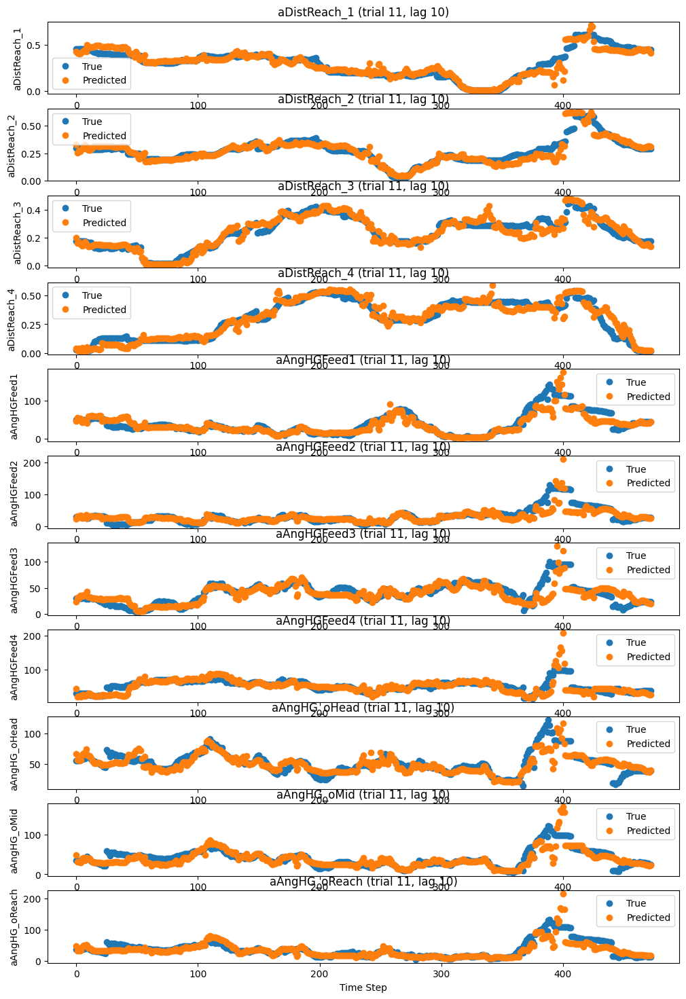

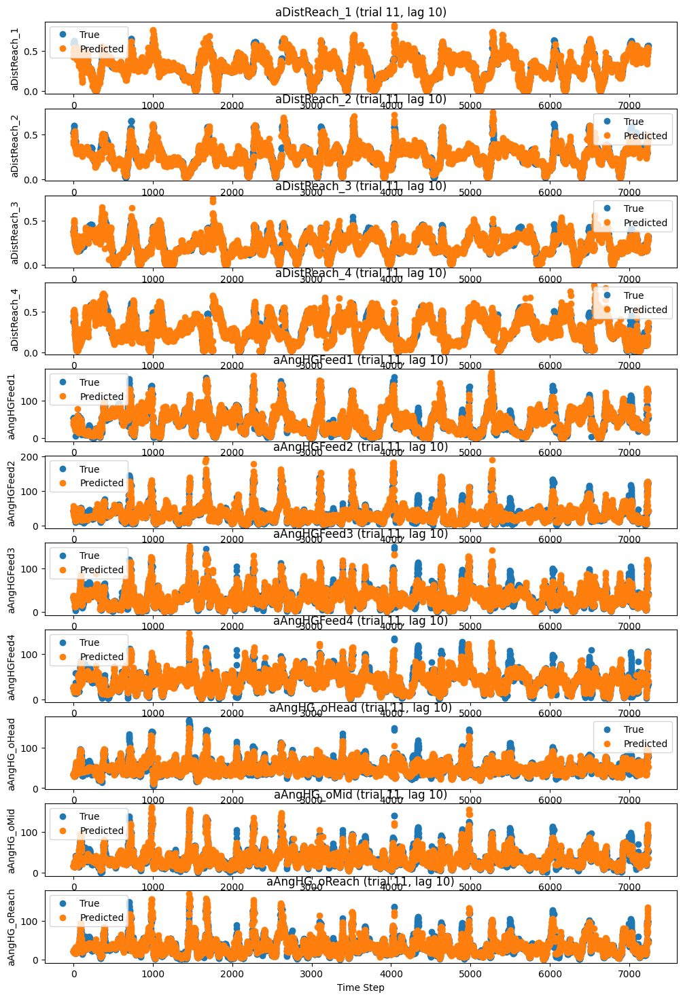

Value 'model_10_val11: 0.05175947' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val11: 0.08787144' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_test\s_results_train240924.txt' successfully.
Epoch 03867: reducing learning rate of group 0 to 2.0276e-04.
model_10_val12: Epoch 50/350, Loss: 0.053400009870529175
Epoch 03918: reducing learning rate of group 0 to 1.8248e-04.
model_10_val12: Epoch 100/350, Loss: 0.05266682058572769
Epoch 03969: reducing learning rate of group 0 to 1.6423e-04.
model_10_val12: Epoch 150/350, Loss: 0.05216367170214653
Epoch 04020: reducing learning rate of group 0 to 1.4781e-04.
model_10_val12: Epoch 200/350, Loss: 0.05177345871925354
Epoch 04071: reducing learning rate of group 0 to 1.3303e-04.
model_10_val12: Epoch 250/350, Loss: 0.05143645033240318
Epoch 04138: reducing learning rate of group 0 to 1.1973e-04.
model_10_val12: Ep

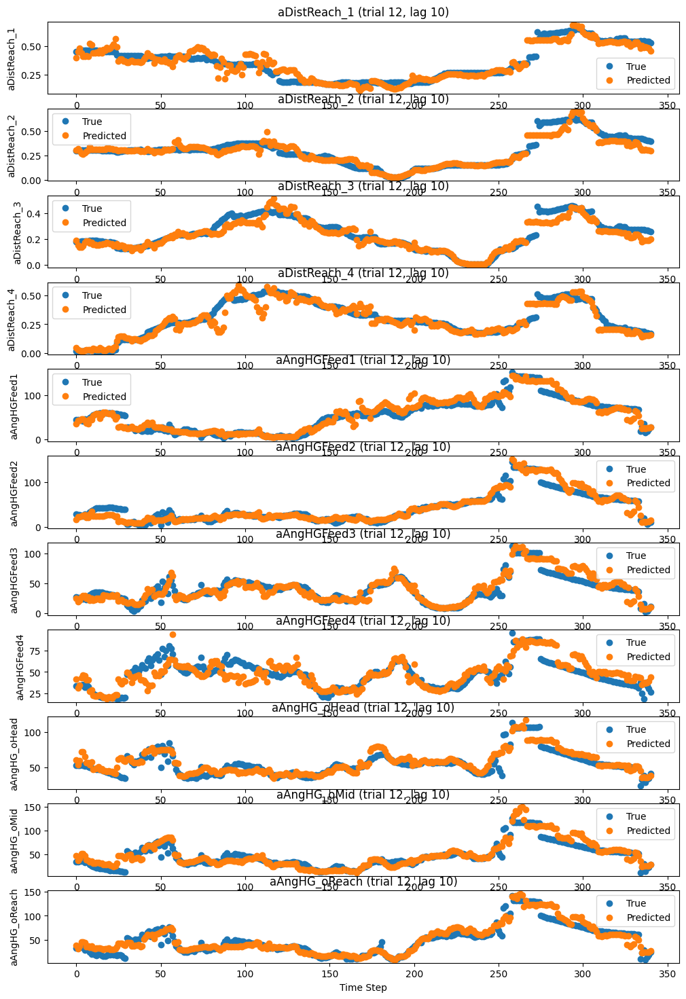

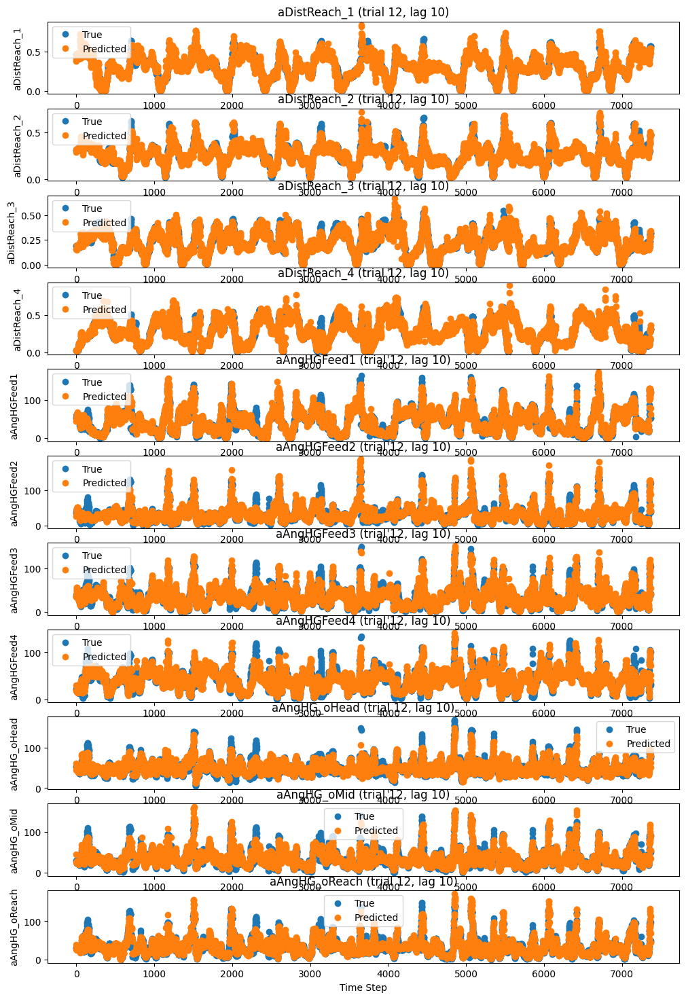

Value 'model_10_val12: 0.050878838' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val12: 0.053893216' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_test\s_results_train240924.txt' successfully.
Epoch 04228: reducing learning rate of group 0 to 1.0775e-04.
model_10_val13: Epoch 50/350, Loss: 0.052730493247509
Epoch 04279: reducing learning rate of group 0 to 9.6977e-05.
model_10_val13: Epoch 100/350, Loss: 0.05210836976766586
Epoch 04330: reducing learning rate of group 0 to 8.7280e-05.
model_10_val13: Epoch 150/350, Loss: 0.051708050072193146
Epoch 04381: reducing learning rate of group 0 to 7.8552e-05.
model_10_val13: Epoch 200/350, Loss: 0.05139333754777908
Epoch 04432: reducing learning rate of group 0 to 7.0697e-05.
model_10_val13: Epoch 250/350, Loss: 0.05109371989965439
Epoch 04483: reducing learning rate of group 0 to 6.3627e-05.
model_10_val13: Ep

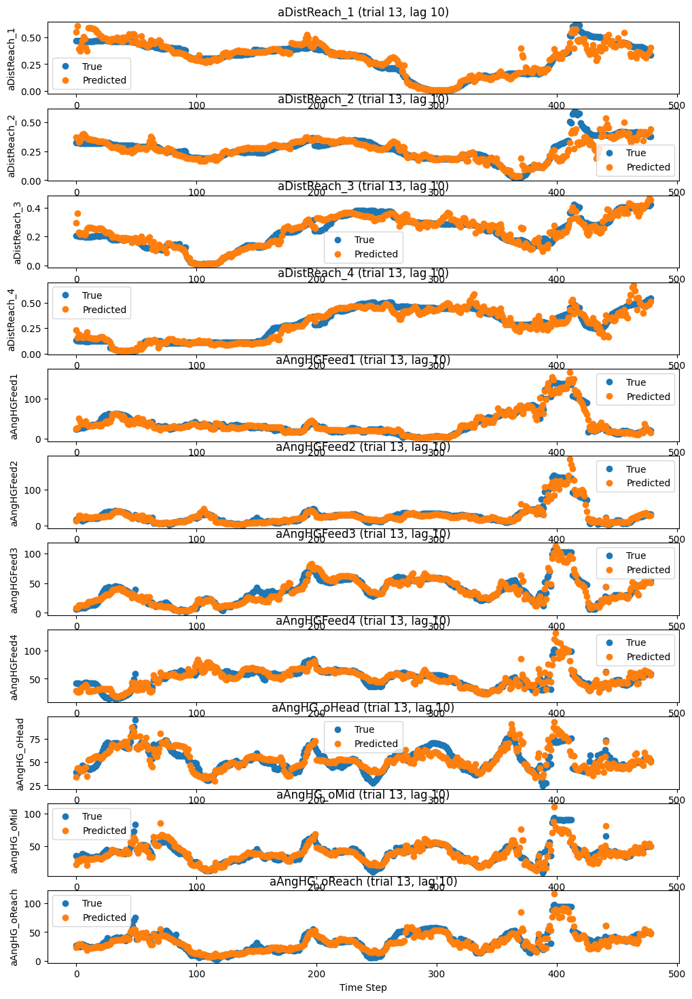

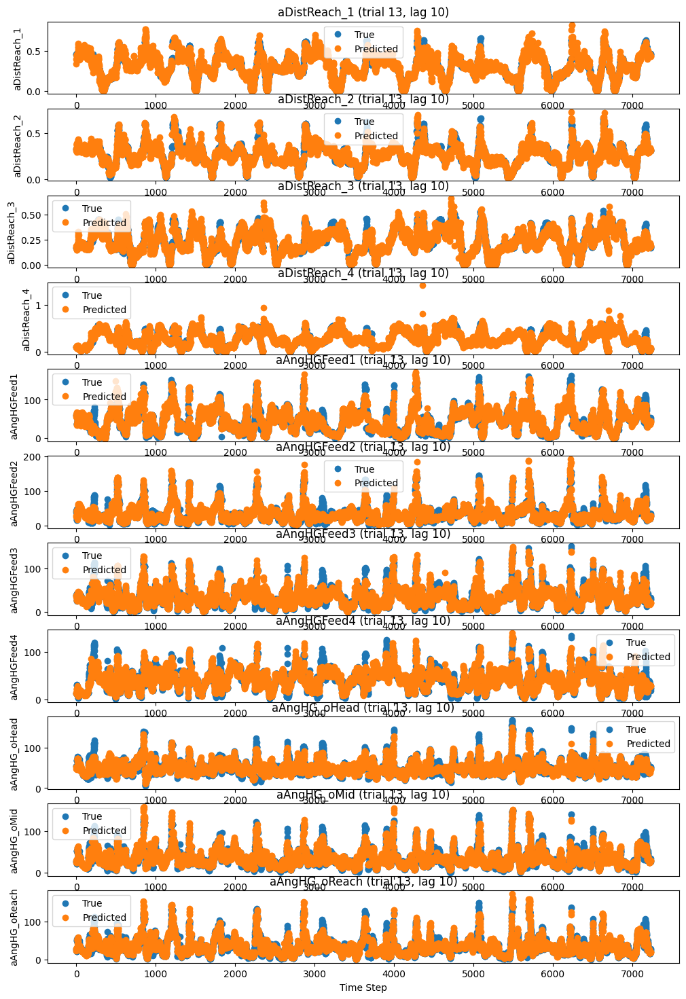

Value 'model_10_val13: 0.050629023' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val13: 0.044047702' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_test\s_results_train240924.txt' successfully.
Epoch 04585: reducing learning rate of group 0 to 5.1538e-05.
model_10_val14: Epoch 50/350, Loss: 0.050363291054964066
model_10_val14: Epoch 100/350, Loss: 0.049882739782333374
Epoch 04689: reducing learning rate of group 0 to 4.6384e-05.
model_10_val14: Epoch 150/350, Loss: 0.04956524074077606
model_10_val14: Epoch 200/350, Loss: 0.049314118921756744
Epoch 04767: reducing learning rate of group 0 to 4.1746e-05.
model_10_val14: Epoch 250/350, Loss: 0.04912072792649269
Epoch 04818: reducing learning rate of group 0 to 3.7571e-05.
model_10_val14: Epoch 300/350, Loss: 0.048959799110889435
Epoch 04895: reducing learning rate of group 0 to 3.3814e-05.
model_10_val14: Ep

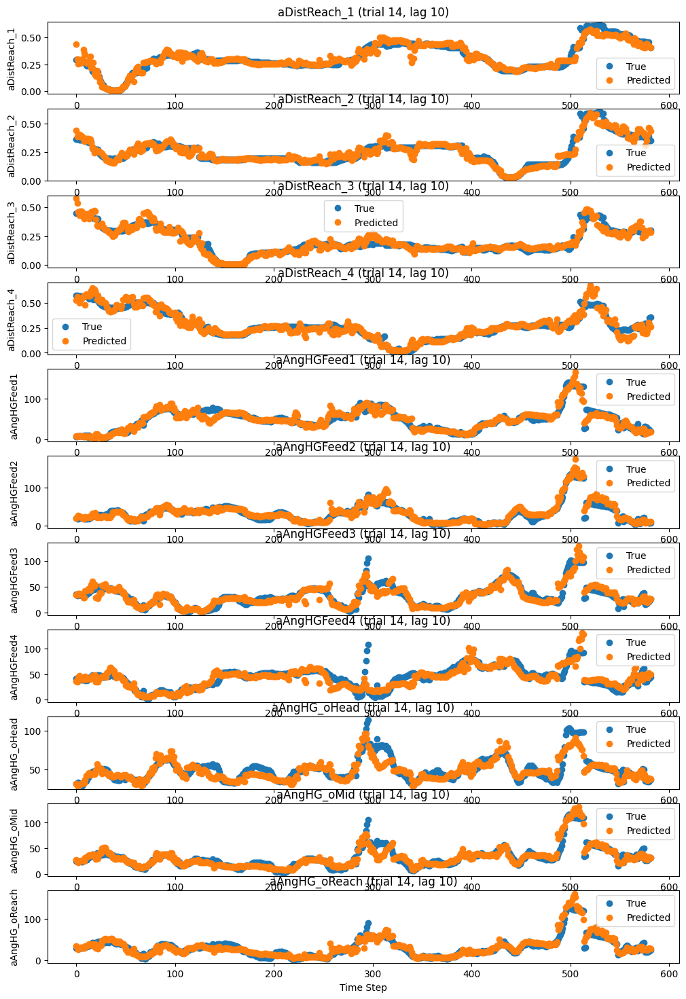

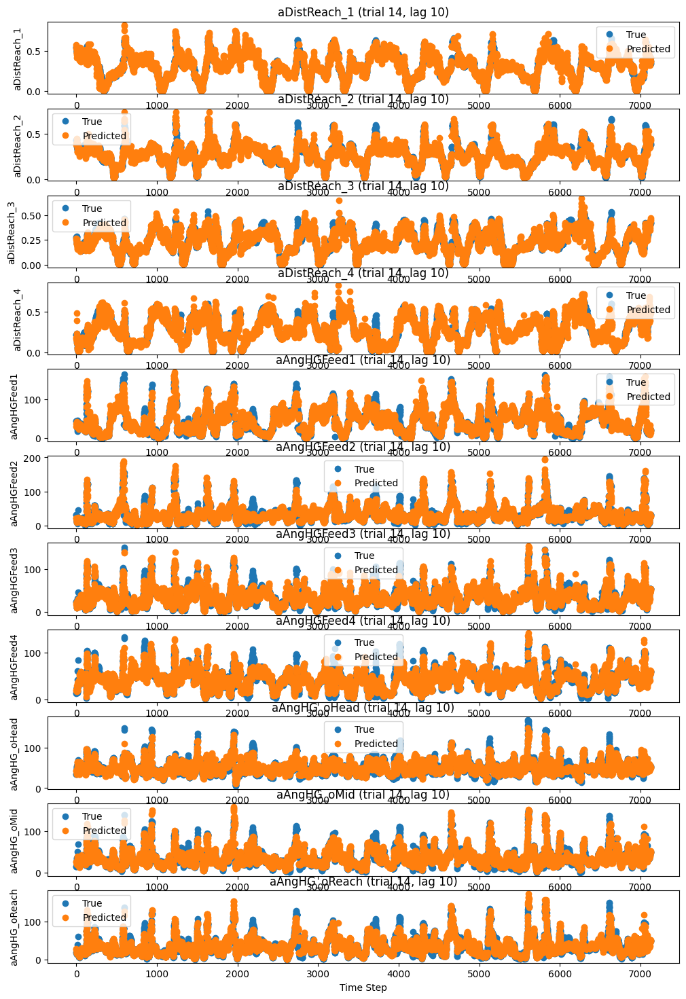

Value 'model_10_val14: 0.0488117' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val14: 0.05650526' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_test\s_results_train240924.txt' successfully.
Epoch 04946: reducing learning rate of group 0 to 3.0433e-05.
model_10_val15: Epoch 50/350, Loss: 0.05087348073720932
Epoch 04997: reducing learning rate of group 0 to 2.7389e-05.
model_10_val15: Epoch 100/350, Loss: 0.05030323192477226
Epoch 05048: reducing learning rate of group 0 to 2.4650e-05.
model_10_val15: Epoch 150/350, Loss: 0.050111930817365646
Epoch 05099: reducing learning rate of group 0 to 2.2185e-05.
model_10_val15: Epoch 200/350, Loss: 0.049970995634794235
Epoch 05150: reducing learning rate of group 0 to 1.9967e-05.
model_10_val15: Epoch 250/350, Loss: 0.04985738545656204
model_10_val15: Epoch 300/350, Loss: 0.04976171255111694
Epoch 05201: reducing l

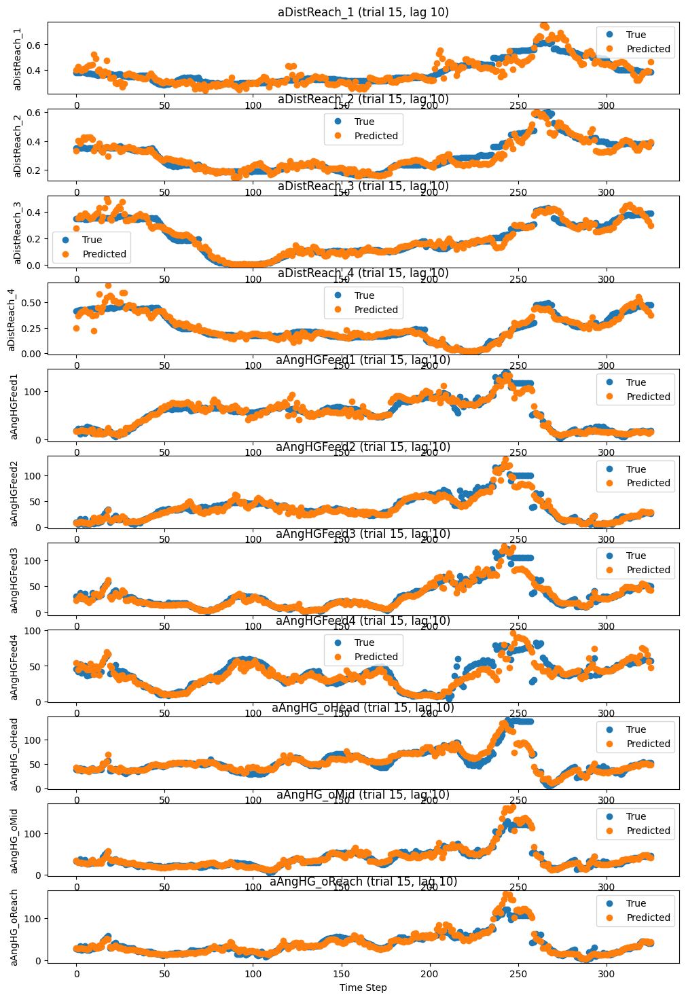

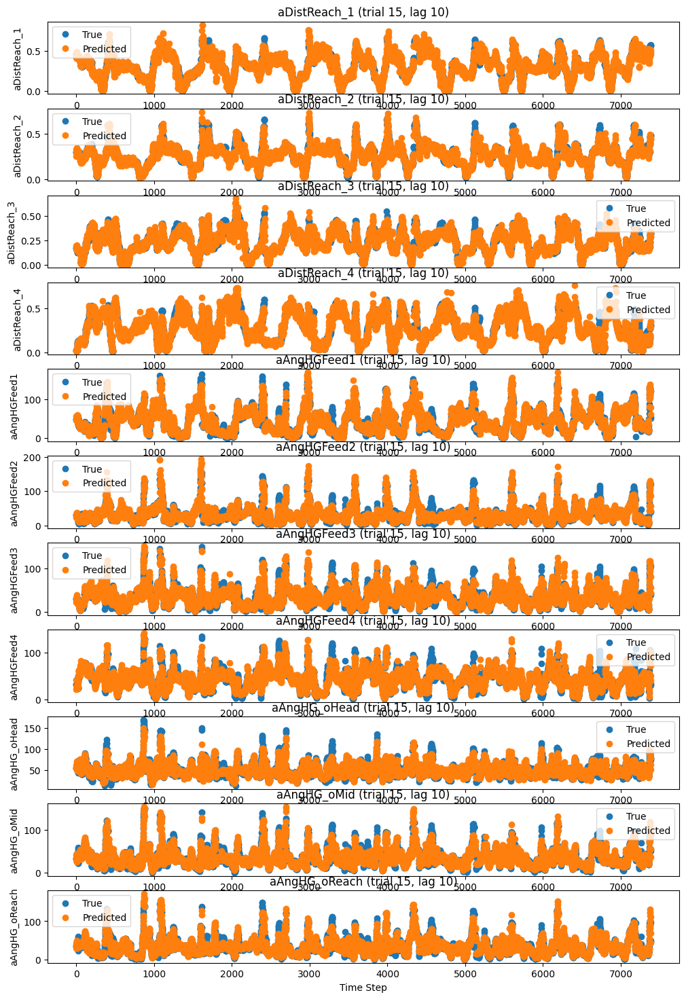

Value 'model_10_val15: 0.04967775' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val15: 0.039765157' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150\results_test\s_results_train240924.txt' successfully.


In [300]:
data = "data_model_v1.csv"
df = pd.read_csv(data)
df = df.drop(columns='id')

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Columns you want to apply log transformation to
columns_to_transform = ['aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aAngHGFeed1',
'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4', 'aDistReach_1',
'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'oAngHGFeed1',
'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4', 'oDistReach1',
'oDistReach2', 'oDistReach3', 'oDistReach4']

# Apply log transformation (natural log)
df[columns_to_transform] = df[columns_to_transform].apply(np.log)


# Hyperparameters
input_dim = 16
hidden_dim = 64
output_dim = 11
num_layers = 2
n_epochs = 350
lr = 0.01
seq_length = 10
# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l2_h64_e150"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
values = [10]
model_probabilities = {}
model_probabilities_train = {}

for i in values:
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)
        
        
        # Create an empty DataFrame to store the shifted data
        #df = shuffle_trials(df)
        shifted_df = shift_dataframe(df=df,shift_value=shift,columns_to_shift=columns_to_shift)
        shifted_df = shuffle_trials(shifted_df)
        
        

        train_dataloader, test_dataloader, fullset_dataloader = create_dataloaders(shifted_df,labels,seq_length=seq_length,set_values=set_values)
        
        # Training loop
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Training loop
        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss

            # Calculate average loss for the epoch
            avg_loss = total_loss / len(train_dataloader)

            # Step the scheduler with the average loss
            scheduler.step(avg_loss)

            # Print epoch loss every 50 epochs
            if (epoch + 1) % 50 == 0:
                print(f'{model_name}: Epoch {epoch + 1}/{n_epochs}, Loss: {avg_loss}')

               # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        test_loss = 0

        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)

            y_test_pred, _ = model(X_test_batch)  # Forward pass
            y_train_pred, _ = model(X_train_batch)
            loss = loss_fn(y_test_pred, y_test_batch)  # Calculate loss
            accs_train = loss_fn(y_train_pred, y_train_batch)
            accs_test = loss_fn(y_test_pred, y_test_batch)
            accs_train = accs_train.numpy()
            accs_test = accs_test.numpy()
            test_loss += loss.item()  # Accumulate test loss
            line_train_dir = "line_plots_train/"
            line_test_dir = "line_plots_test/"

            line_plots_train_path = os.path.join(current_dir, line_train_dir)
            line_plots_test_path = os.path.join(current_dir, line_test_dir)

            if not os.path.exists(line_plots_test_path):
                os.makedirs(line_plots_test_path)
            if not os.path.exists(line_plots_train_path):
                os.makedirs(line_plots_train_path) 

            train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
            test_plot_path = os.path.join(line_plots_test_path, plot_test_name) 
            print(test_plot_path)
            print(train_plot_path)
            create_lineplots(np.exp(y_test_pred), np.exp(y_test_batch), labels, trial=set_values, shift=shift, file_path=test_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_train_pred), np.exp(y_train_batch), labels, trial=set_values, shift=shift, file_path=train_plot_path,size=(12,18), show_plot=True)
            
            if not os.path.exists(current_dir):
                os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"

        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)


        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
       
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"

        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)                

layer drop to 1 

model_10_val1: Epoch 50/350, Loss: 0.4923207759857178
model_10_val1: Epoch 100/350, Loss: 0.44641637802124023
model_10_val1: Epoch 150/350, Loss: 0.4105149209499359
model_10_val1: Epoch 200/350, Loss: 0.391339510679245
model_10_val1: Epoch 250/350, Loss: 0.37328779697418213
model_10_val1: Epoch 300/350, Loss: 0.35696282982826233
model_10_val1: Epoch 350/350, Loss: 0.3473098576068878
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_test/model_10_val1_test_.png
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_train/model_10_val1_train_.png


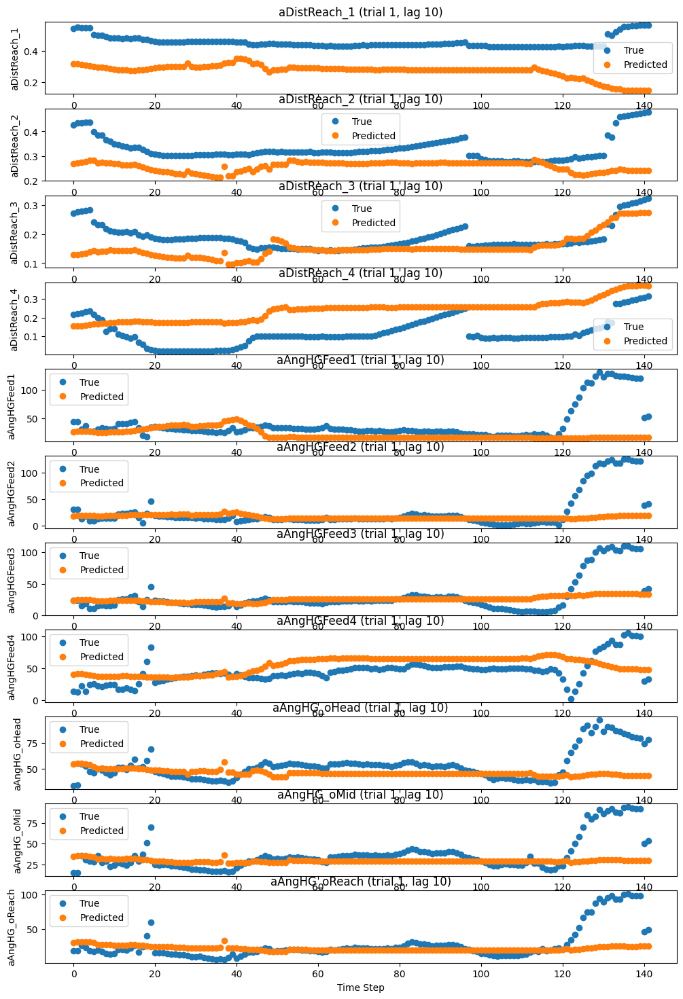

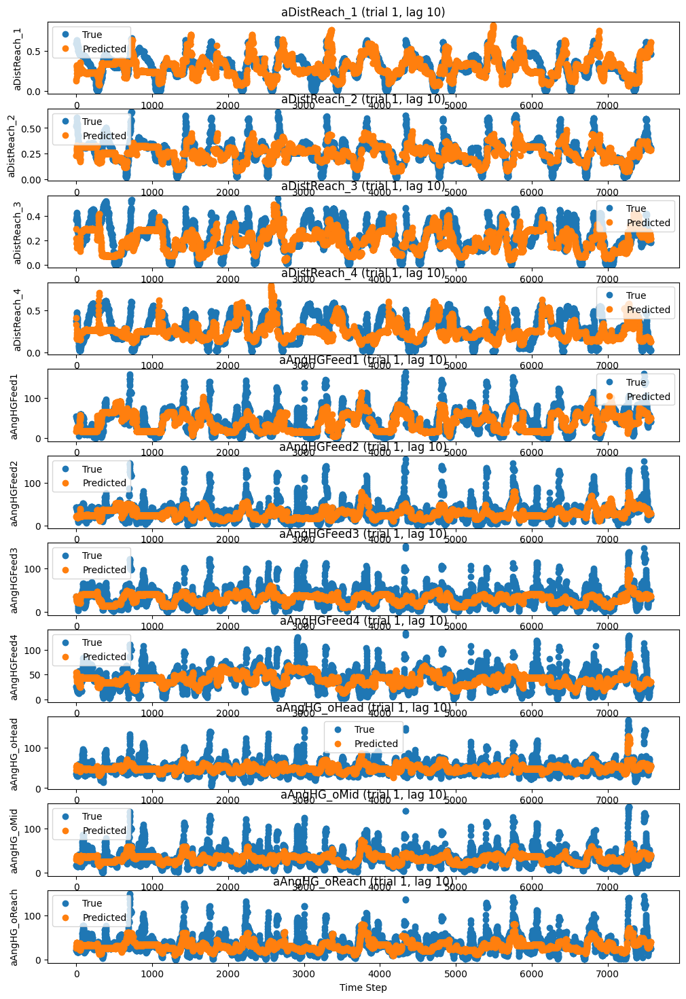

Value 'model_10_val1: 0.3458707' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val1: 0.40596431' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_test\s_results_train240924.txt' successfully.
model_10_val2: Epoch 50/350, Loss: 0.32291916012763977
model_10_val2: Epoch 100/350, Loss: 0.31338509917259216
model_10_val2: Epoch 150/350, Loss: 0.3020515441894531
model_10_val2: Epoch 200/350, Loss: 0.3042202591896057
model_10_val2: Epoch 250/350, Loss: 0.293640673160553
model_10_val2: Epoch 300/350, Loss: 0.2759067714214325
model_10_val2: Epoch 350/350, Loss: 0.2716021239757538
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_test/model_10_val2_test_.png
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_train/model_10_val2_train_.png


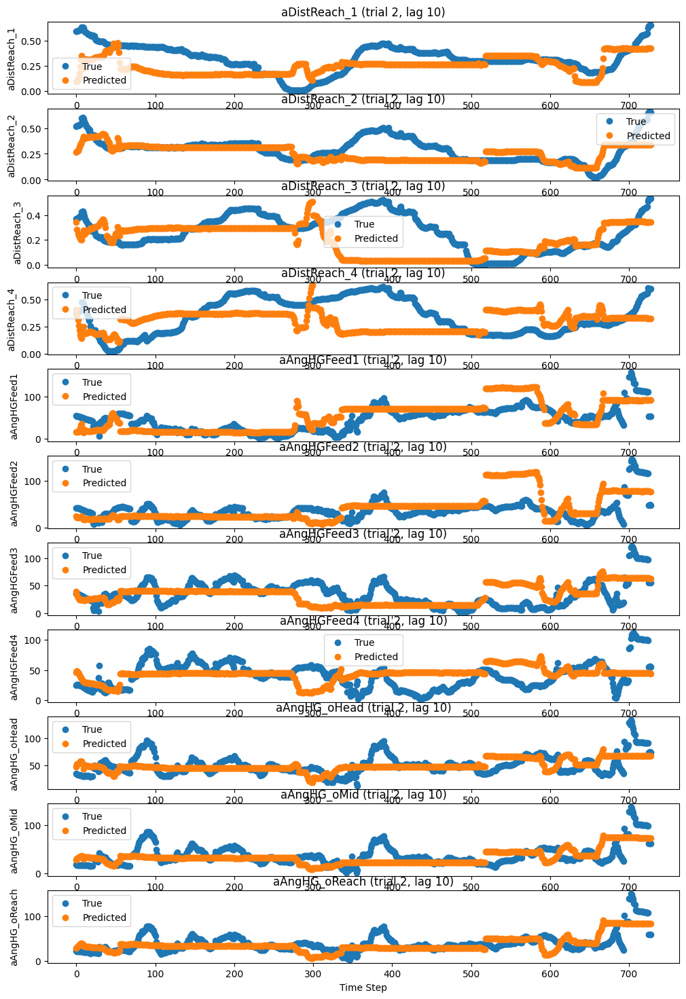

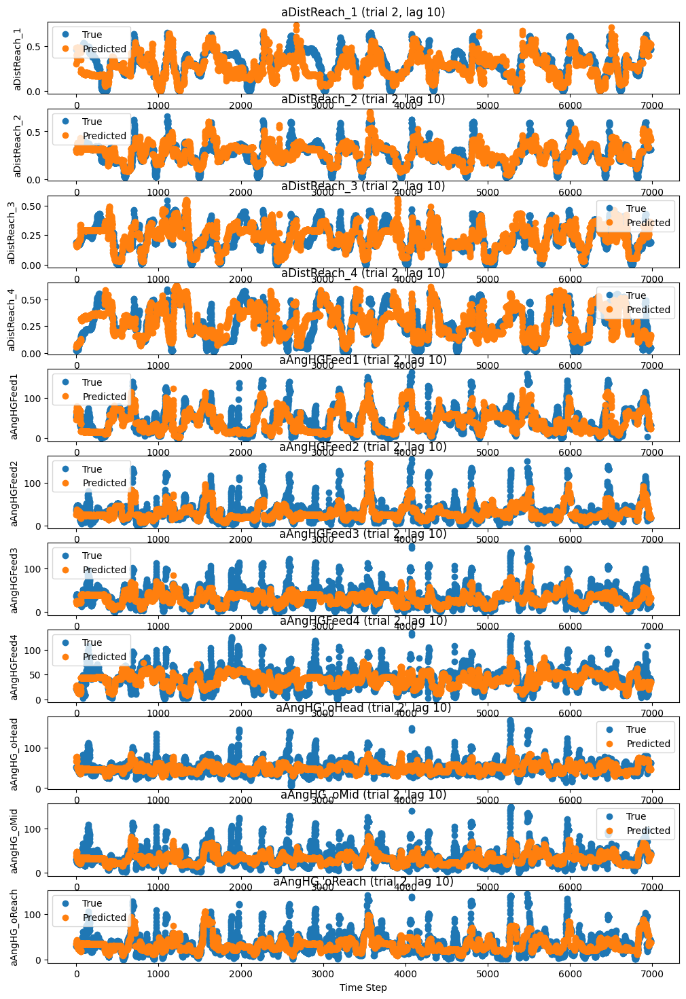

Value 'model_10_val2: 0.27222636' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val2: 0.55522656' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_test\s_results_train240924.txt' successfully.
Epoch 00748: reducing learning rate of group 0 to 9.0000e-03.
model_10_val3: Epoch 50/350, Loss: 0.2859897315502167
Epoch 00799: reducing learning rate of group 0 to 8.1000e-03.
model_10_val3: Epoch 100/350, Loss: 0.30340608954429626
model_10_val3: Epoch 150/350, Loss: 0.272626131772995
model_10_val3: Epoch 200/350, Loss: 0.2555887997150421
model_10_val3: Epoch 250/350, Loss: 0.25248005986213684
model_10_val3: Epoch 300/350, Loss: 0.2590998113155365
Epoch 01003: reducing learning rate of group 0 to 7.2900e-03.
model_10_val3: Epoch 350/350, Loss: 0.24683025479316711
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_test/model_10_val3_test_.png
C:

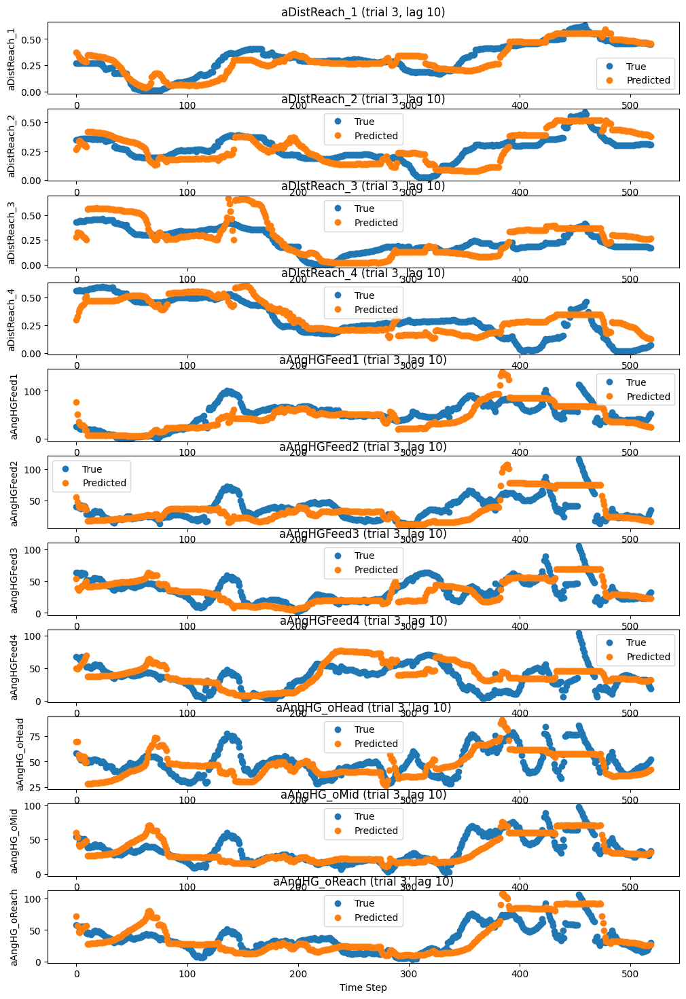

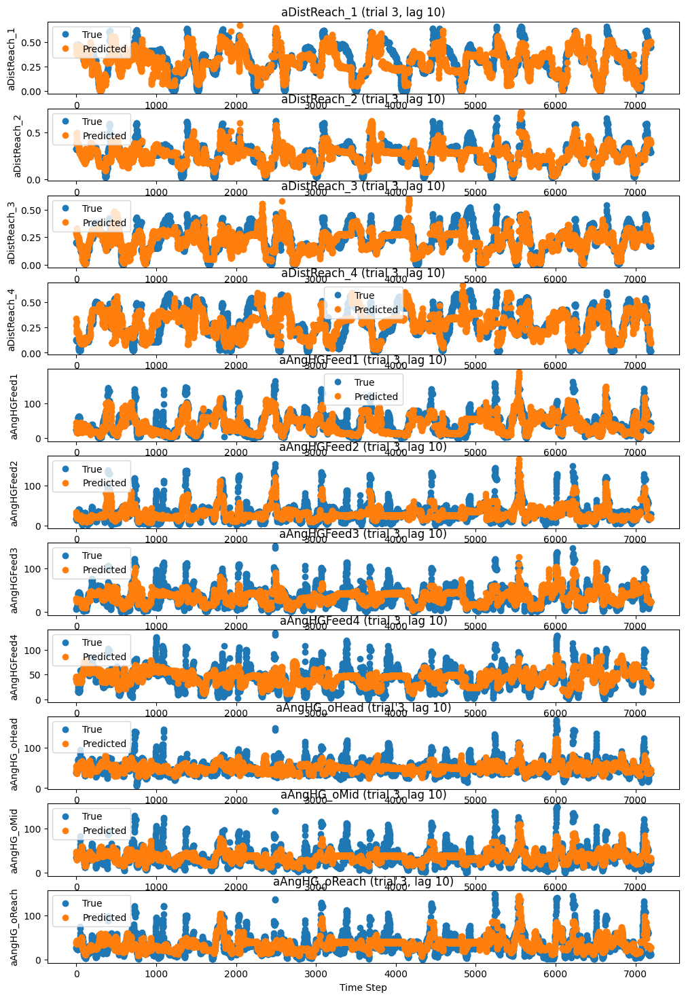

Value 'model_10_val3: 0.24649006' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val3: 0.34667215' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_test\s_results_train240924.txt' successfully.
model_10_val4: Epoch 50/350, Loss: 0.2489907443523407
Epoch 01125: reducing learning rate of group 0 to 6.5610e-03.
model_10_val4: Epoch 100/350, Loss: 0.24379302561283112
model_10_val4: Epoch 150/350, Loss: 0.26164036989212036
model_10_val4: Epoch 200/350, Loss: 0.2291496992111206
model_10_val4: Epoch 250/350, Loss: 0.21893435716629028
model_10_val4: Epoch 300/350, Loss: 0.21945765614509583
Epoch 01392: reducing learning rate of group 0 to 5.9049e-03.
model_10_val4: Epoch 350/350, Loss: 0.2030784636735916
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_test/model_10_val4_test_.png
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150

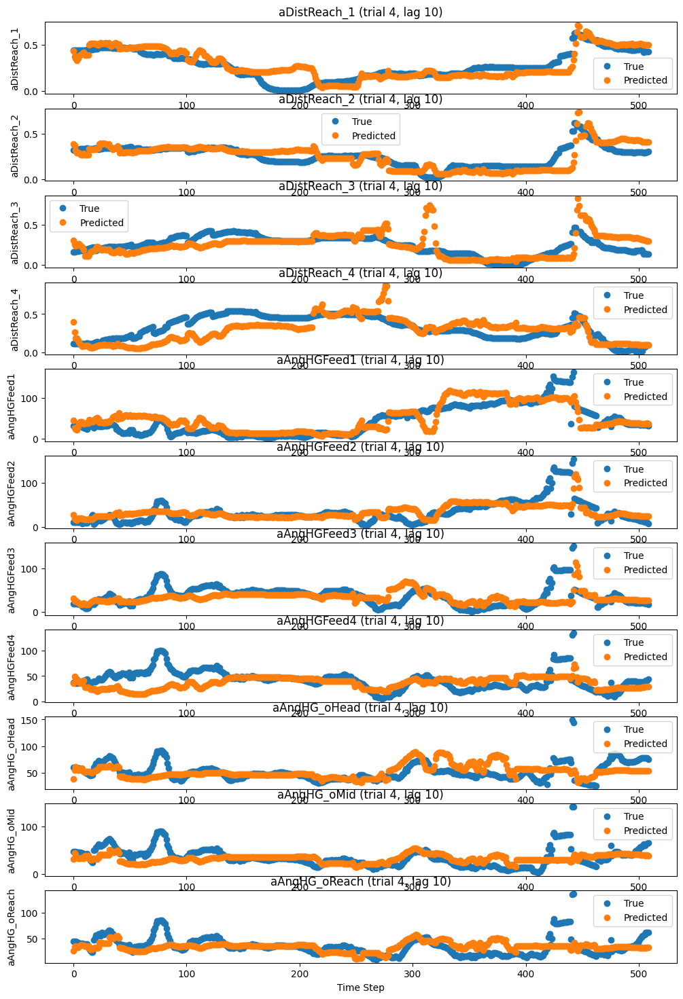

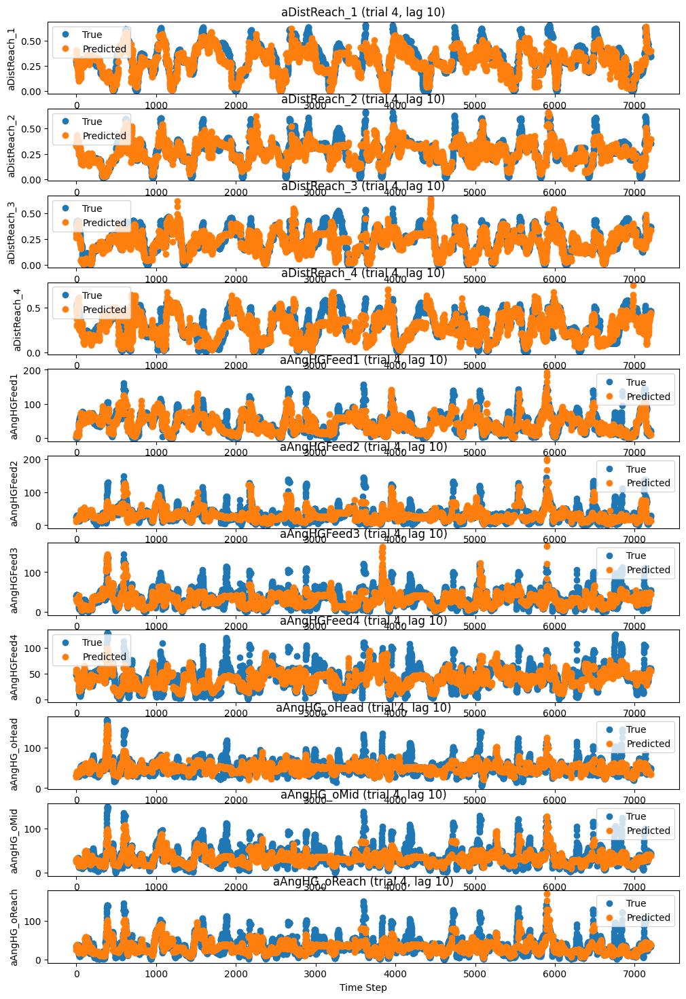

Value 'model_10_val4: 0.20625967' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val4: 0.3772' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_test\s_results_train240924.txt' successfully.
model_10_val5: Epoch 50/350, Loss: 0.2679307758808136
Epoch 01493: reducing learning rate of group 0 to 5.3144e-03.
model_10_val5: Epoch 100/350, Loss: 0.19832126796245575
model_10_val5: Epoch 150/350, Loss: 0.24930746853351593
Epoch 01597: reducing learning rate of group 0 to 4.7830e-03.
model_10_val5: Epoch 200/350, Loss: 0.20692797005176544
model_10_val5: Epoch 250/350, Loss: 0.21556456387043
Epoch 01694: reducing learning rate of group 0 to 4.3047e-03.
model_10_val5: Epoch 300/350, Loss: 0.18774853646755219
model_10_val5: Epoch 350/350, Loss: 0.1868782937526703
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_test/model_10_val5_test_.png
C:/Use

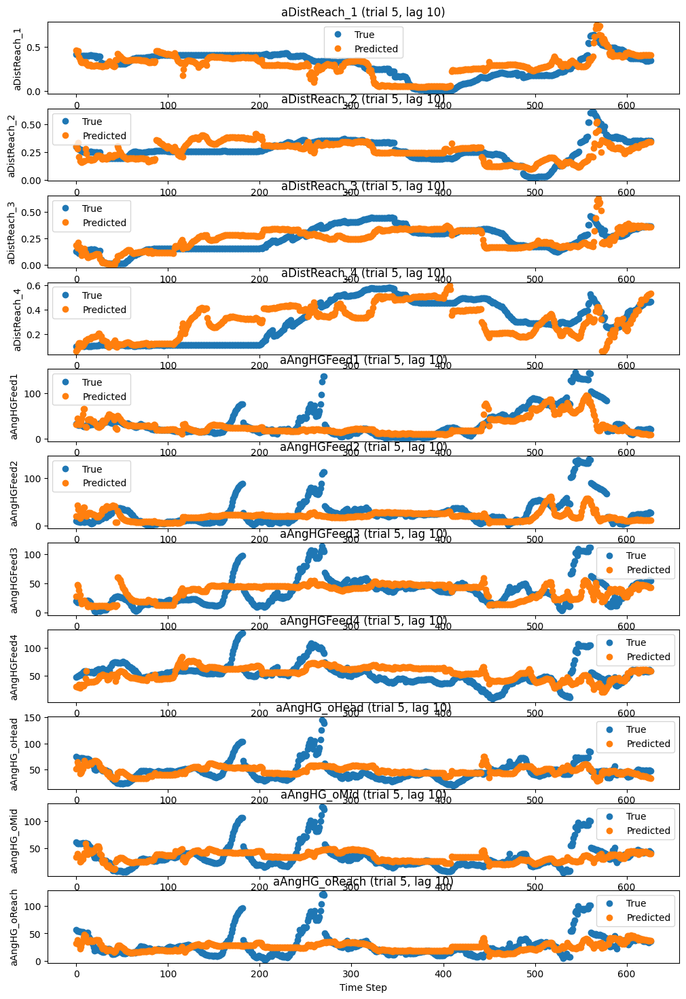

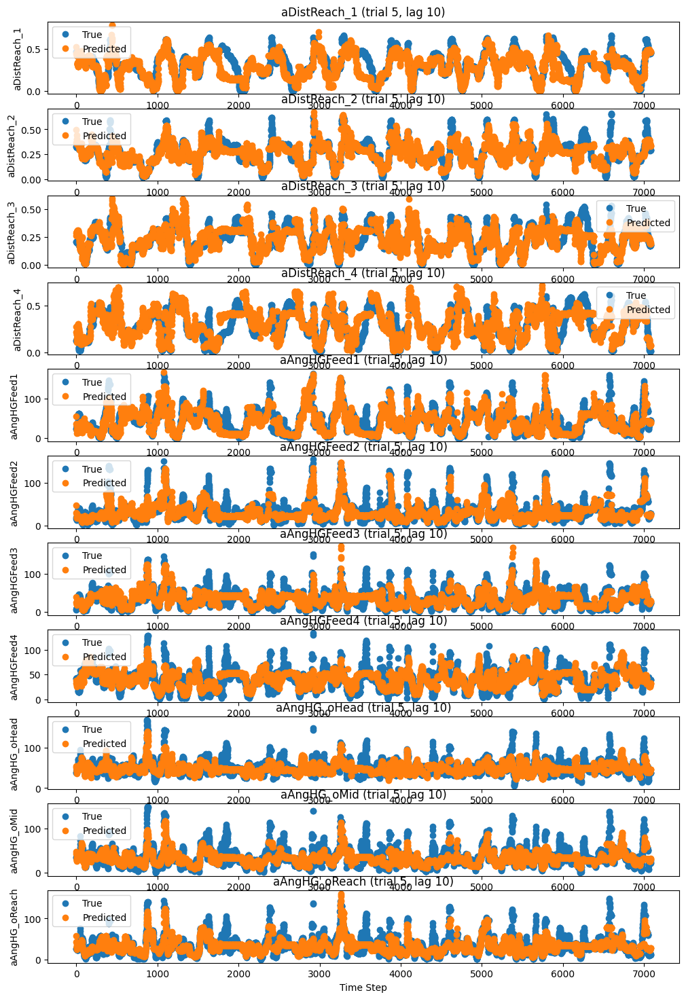

Value 'model_10_val5: 0.20356096' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val5: 0.3204109' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_test\s_results_train240924.txt' successfully.
Epoch 01764: reducing learning rate of group 0 to 3.8742e-03.
model_10_val6: Epoch 50/350, Loss: 0.18763203918933868
Epoch 01815: reducing learning rate of group 0 to 3.4868e-03.
model_10_val6: Epoch 100/350, Loss: 0.18479731678962708
model_10_val6: Epoch 150/350, Loss: 0.18556270003318787
Epoch 01911: reducing learning rate of group 0 to 3.1381e-03.
model_10_val6: Epoch 200/350, Loss: 0.17815107107162476
model_10_val6: Epoch 250/350, Loss: 0.173710897564888
model_10_val6: Epoch 300/350, Loss: 0.1758851855993271
Epoch 02087: reducing learning rate of group 0 to 2.8243e-03.
model_10_val6: Epoch 350/350, Loss: 0.16939720511436462
C:/Users/kacpe/Desktop/lab_rotation_git/lo

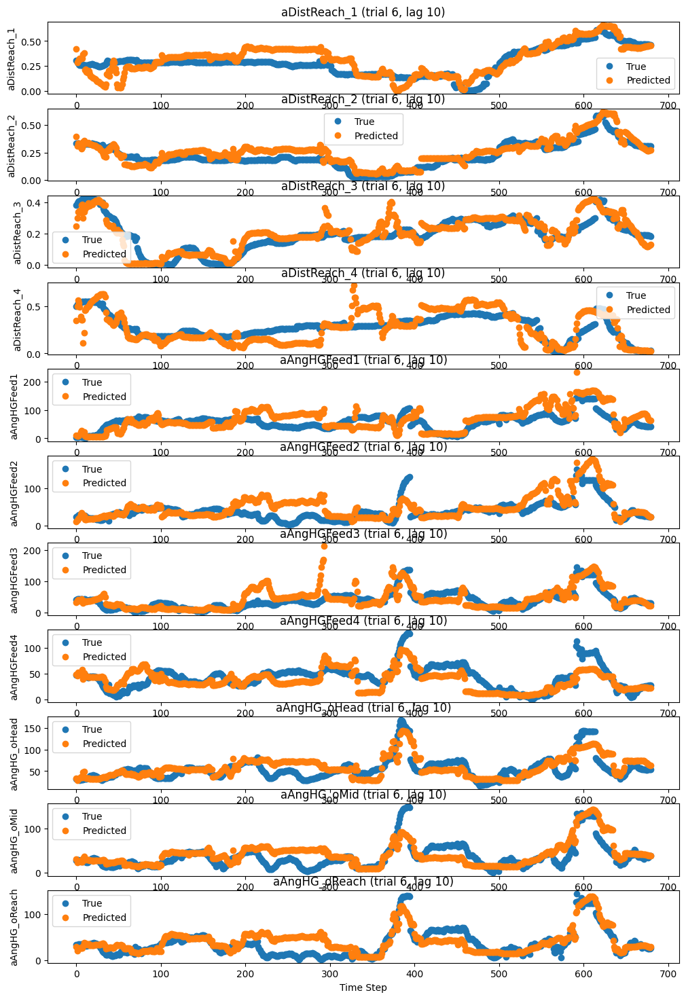

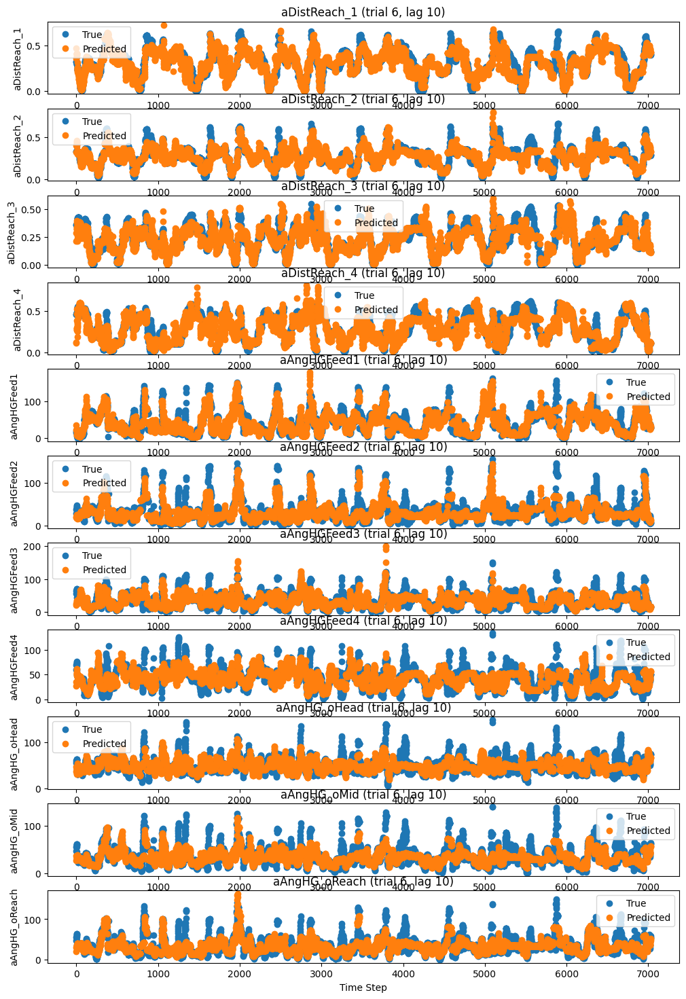

Value 'model_10_val6: 0.16917743' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val6: 0.36796877' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_test\s_results_train240924.txt' successfully.
model_10_val7: Epoch 50/350, Loss: 0.16201183199882507
model_10_val7: Epoch 100/350, Loss: 0.15900206565856934
model_10_val7: Epoch 150/350, Loss: 0.16344840824604034
Epoch 02272: reducing learning rate of group 0 to 2.5419e-03.
model_10_val7: Epoch 200/350, Loss: 0.1543799191713333
Epoch 02348: reducing learning rate of group 0 to 2.2877e-03.
model_10_val7: Epoch 250/350, Loss: 0.15422378480434418
model_10_val7: Epoch 300/350, Loss: 0.15094853937625885
Epoch 02428: reducing learning rate of group 0 to 2.0589e-03.
model_10_val7: Epoch 350/350, Loss: 0.1503528505563736
C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\line_plots_test/model_10_val7_test_.png

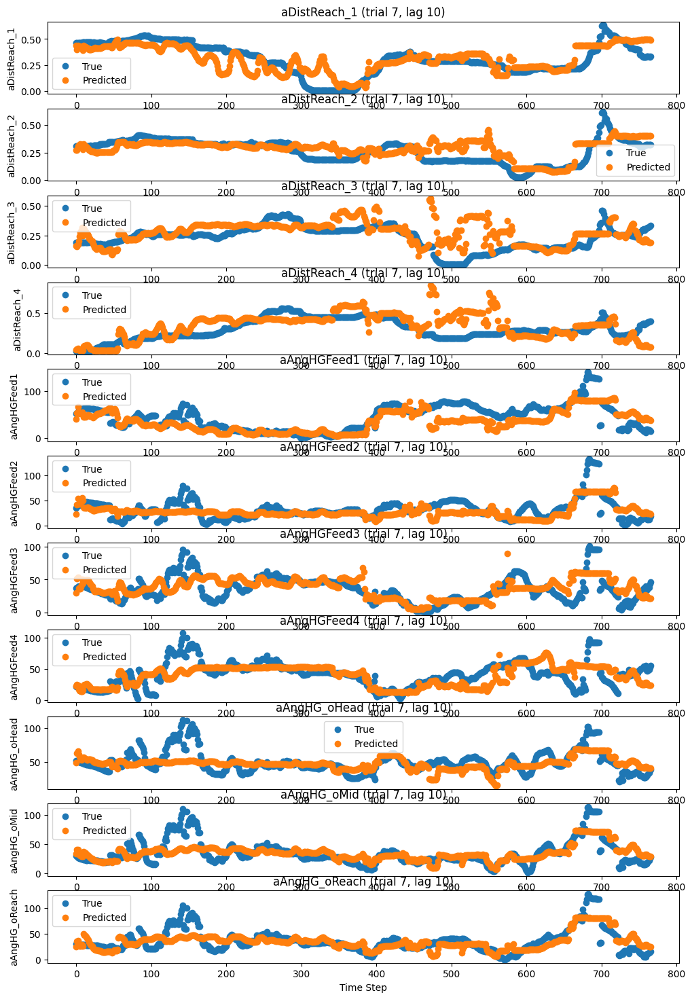

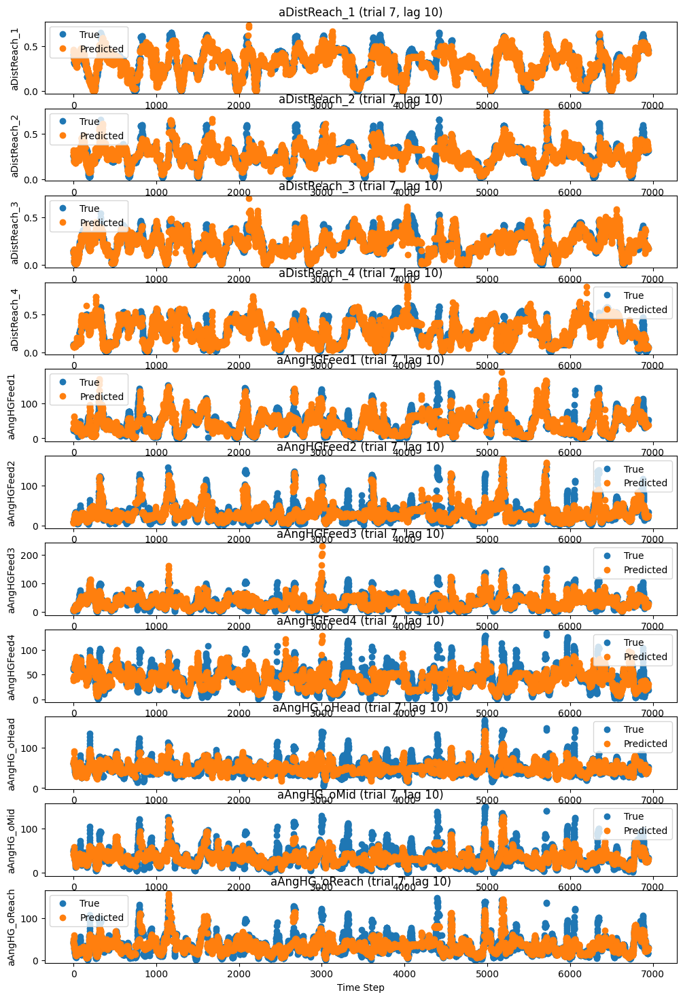

Value 'model_10_val7: 0.14958577' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_train/s_results_train240924.txt' successfully.
Value 'model_10_val7: 0.36666307' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150\results_test\s_results_train240924.txt' successfully.
Epoch 02494: reducing learning rate of group 0 to 1.8530e-03.
model_10_val8: Epoch 50/350, Loss: 0.1617363542318344
Epoch 02545: reducing learning rate of group 0 to 1.6677e-03.
model_10_val8: Epoch 100/350, Loss: 0.15910077095031738
Epoch 02596: reducing learning rate of group 0 to 1.5009e-03.
model_10_val8: Epoch 150/350, Loss: 0.1575508564710617
Epoch 02647: reducing learning rate of group 0 to 1.3509e-03.
model_10_val8: Epoch 200/350, Loss: 0.1562410593032837
Epoch 02698: reducing learning rate of group 0 to 1.2158e-03.
model_10_val8: Epoch 250/350, Loss: 0.15511156618595123
Epoch 02749: reducing learning rate of group 0 to 1.0942e-03.
model_10_val8: Epoch 300/350,

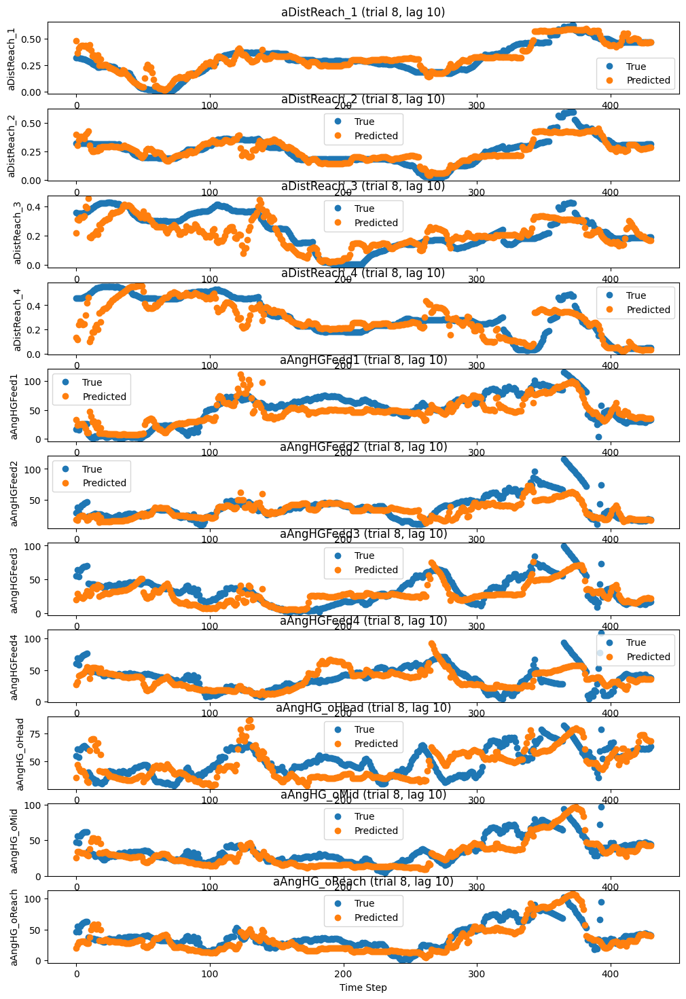

In [301]:
data = "data_model_v1.csv"
df = pd.read_csv(data)
df = df.drop(columns='id')

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Columns you want to apply log transformation to
columns_to_transform = ['aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aAngHGFeed1',
'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4', 'aDistReach_1',
'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'oAngHGFeed1',
'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4', 'oDistReach1',
'oDistReach2', 'oDistReach3', 'oDistReach4']

# Apply log transformation (natural log)
df[columns_to_transform] = df[columns_to_transform].apply(np.log)


# Hyperparameters
input_dim = 16
hidden_dim = 32
output_dim = 11
num_layers = 2
n_epochs = 350
lr = 0.01
seq_length = 50
# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/log_seq10__l1_h32_e150"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
values = [10,30,100]
model_probabilities = {}
model_probabilities_train = {}
mse_train = {}
mae_train = {}
r2_train = {}
mse_val = {}
mae_val = {}
r2_val = {}
for i in values:
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)
        
        
        # Create an empty DataFrame to store the shifted data
        #df = shuffle_trials(df)
        shifted_df = shift_dataframe(df=df,shift_value=shift,columns_to_shift=columns_to_shift)
        shifted_df = shuffle_trials(shifted_df)
        
        

        train_dataloader, test_dataloader, fullset_dataloader = create_dataloaders(shifted_df,labels,seq_length=seq_length,set_values=set_values)
        ##gówno
        # Training loop
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        # Training loop
        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss

            # Calculate average loss for the epoch
            avg_loss = total_loss / len(train_dataloader)

            # Step the scheduler with the average loss
            scheduler.step(avg_loss)

            # Print epoch loss every 50 epochs
            if (epoch + 1) % 50 == 0:
                print(f'{model_name}: Epoch {epoch + 1}/{n_epochs}, Loss: {avg_loss}')

                # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        test_loss = 0

        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)

            y_test_pred, _ = model(X_test_batch)  # Forward pass
            y_train_pred, _ = model(X_train_batch)
            loss = loss_fn(y_test_pred, y_test_batch)  # Calculate loss
            accs_train = loss_fn(y_train_pred, y_train_batch)
            accs_test = loss_fn(y_test_pred, y_test_batch)
            accs_train = accs_train.numpy()
            accs_test = accs_test.numpy()
            test_loss += loss.item()  # Accumulate test loss
            line_train_dir = "line_plots_train/"
            line_test_dir = "line_plots_test/"

            line_plots_train_path = os.path.join(current_dir, line_train_dir)
            line_plots_test_path = os.path.join(current_dir, line_test_dir)

            if not os.path.exists(line_plots_test_path):
                os.makedirs(line_plots_test_path)
            if not os.path.exists(line_plots_train_path):
                os.makedirs(line_plots_train_path) 

            train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
            test_plot_path = os.path.join(line_plots_test_path, plot_test_name) 
            print(test_plot_path)
            print(train_plot_path)
            create_lineplots(np.exp(y_test_pred), np.exp(y_test_batch), labels, trial=set_values, shift=shift, file_path=test_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_train_pred), np.exp(y_train_batch), labels, trial=set_values, shift=shift, file_path=train_plot_path,size=(12,18), show_plot=True)
            
            if not os.path.exists(current_dir):
                os.makedirs(current_dir)        
        
        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        results_test_dir = "results_test"

        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        results_test_dir_path = os.path.join(current_dir, results_test_dir)


        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
       
        
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"

        # Save training results into txt file
        save_results(results_train_dir_path, current_datetime, model_name, accs_train)
        save_results(results_test_dir_path, current_datetime, model_name, accs_test)                

In [56]:
# Function to save metrics
def save_metrics_to_csv(metric_name, model_name, metric_values, current_dir):
    """
    Save a given metric (MSE, MAE, R2) to a CSV file, one row per epoch, one column per model.
    If the file already exists, append the new column for the current model.
    """
    # Define the full path for the metric file
    file_path = os.path.join(current_dir, f"{metric_name}.csv")
    
    # Check if the file already exists
    if os.path.exists(file_path):
        # Load existing data
        df_metrics = pd.read_csv(file_path)
    else:
        # Create a new DataFrame for the first model
        df_metrics = pd.DataFrame()

    # Add the new model's metrics as a column
    df_metrics[model_name] = metric_values
    
    # Save back to CSV
    df_metrics.to_csv(file_path, index=False)

# Directory where you want to save metrics
metrics_dir = os.path.join(current_dir, "metrics")
if not os.path.exists(metrics_dir):
    os.makedirs(metrics_dir)

# Initialize dictionaries to store metrics for each epoch (1 row per epoch)
metrics = {
    'MSE_train': [],
    'MAE_train': [],
    'R2_train': [],
    'MSE_val': [],
    'MAE_val': [],
    'R2_val': []
}


In [44]:
current_dir

'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350'

Epoch 10/250, Training Loss: 0.5445998311042786, Validation Loss: 0.584465742111206
Epoch 20/250, Training Loss: 0.5191277861595154, Validation Loss: 0.4884573519229889
Epoch 30/250, Training Loss: 0.5087903141975403, Validation Loss: 0.49928513169288635
Epoch 40/250, Training Loss: 0.5042160749435425, Validation Loss: 0.48642823100090027
Epoch 50/250, Training Loss: 0.49812716245651245, Validation Loss: 0.4866921007633209
Epoch 60/250, Training Loss: 0.48871535062789917, Validation Loss: 0.4903606176376343
Epoch 70/250, Training Loss: 0.48095810413360596, Validation Loss: 0.4842754602432251
Epoch 80/250, Training Loss: 0.4700010418891907, Validation Loss: 0.4721199870109558
Epoch 90/250, Training Loss: 0.4536190330982208, Validation Loss: 0.4516567587852478
Epoch 100/250, Training Loss: 0.4429786801338196, Validation Loss: 0.46995803713798523
Epoch 110/250, Training Loss: 0.4314224421977997, Validation Loss: 0.4525153338909149
Epoch 120/250, Training Loss: 0.4173544645309448, Validati

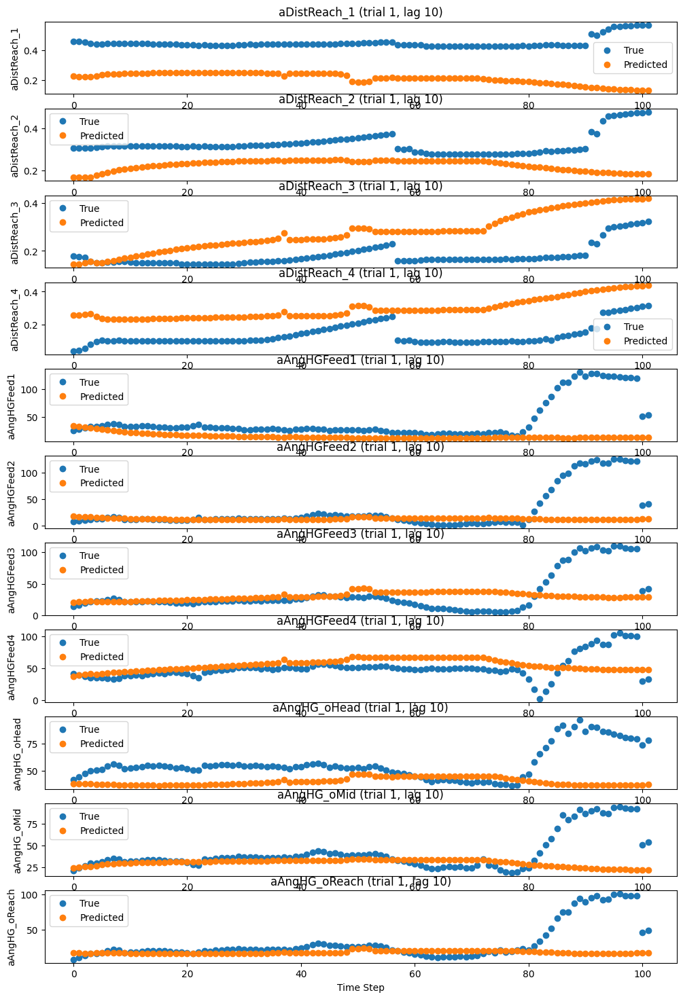

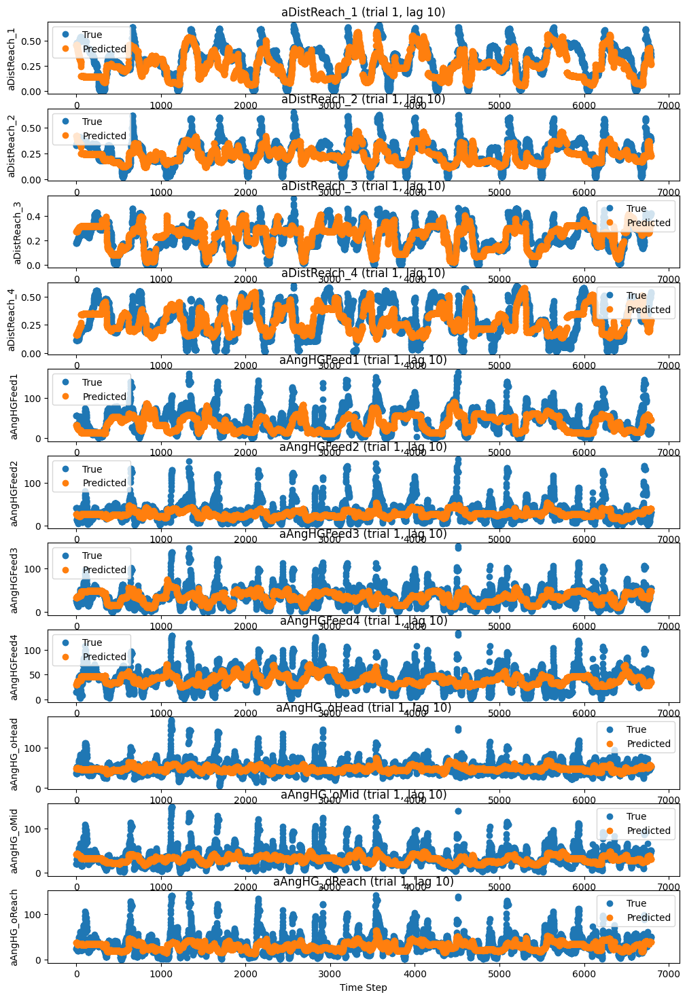

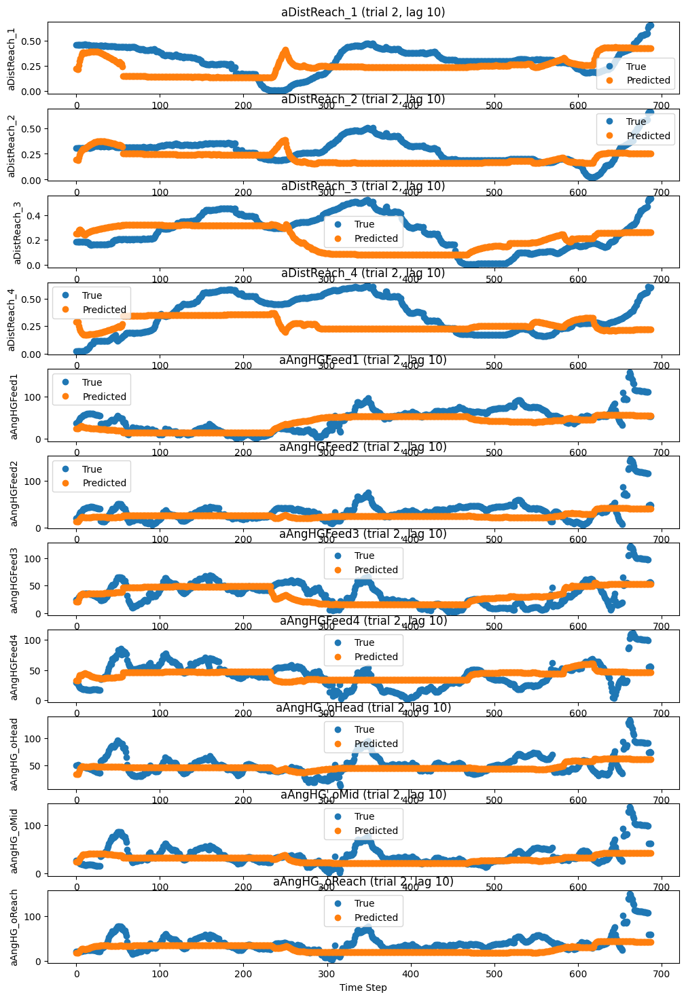

Value 'model_10_val2: 0.46742409467697144' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val2: 0.34973076' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val2: 0.571262' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 00259: reducing learning rate of group 0 to 9.0000e-03.
Epoch 10/250, Training Loss: 0.343603253364563, Validation Loss: 0.3248436450958252
Epoch 20/250, Training Loss: 0.34391507506370544, Validation Loss: 0.340613454580307
Epoch 30/250, Training Loss: 0.3352636992931366, Validation Loss: 0.39021557569503784
Epoch 40/250, Training Loss: 0.33188965916633606, Validation Loss: 0.3484721779823303
Epoch 50/250, Training Loss: 0.32966679334640503, Validation Loss: 0.37729308009147644
Epoch 60/250, Training Loss: 0.3171685

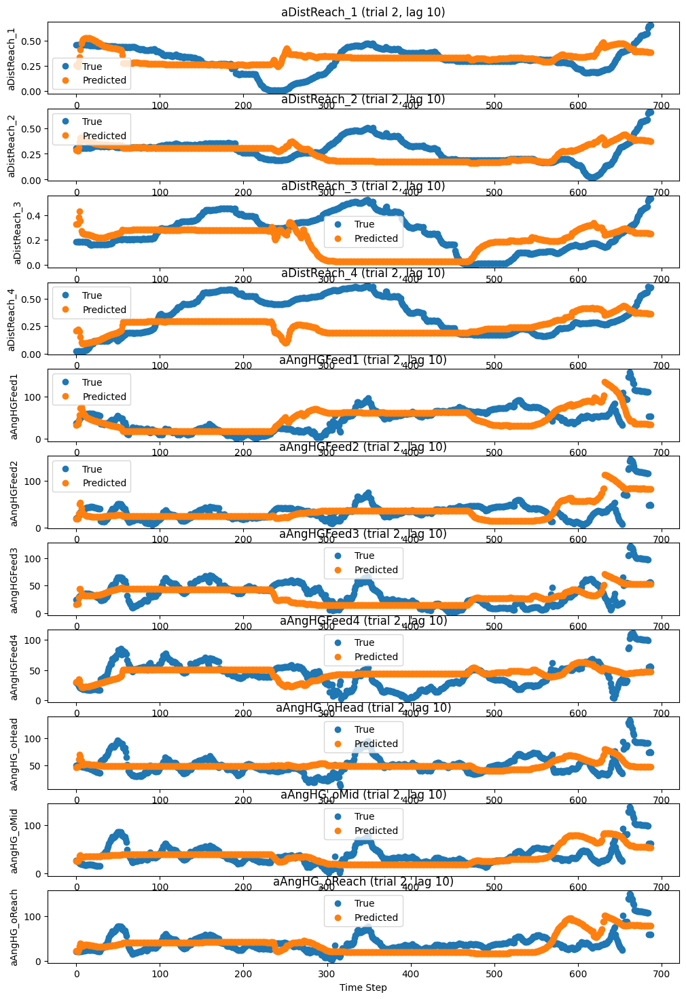

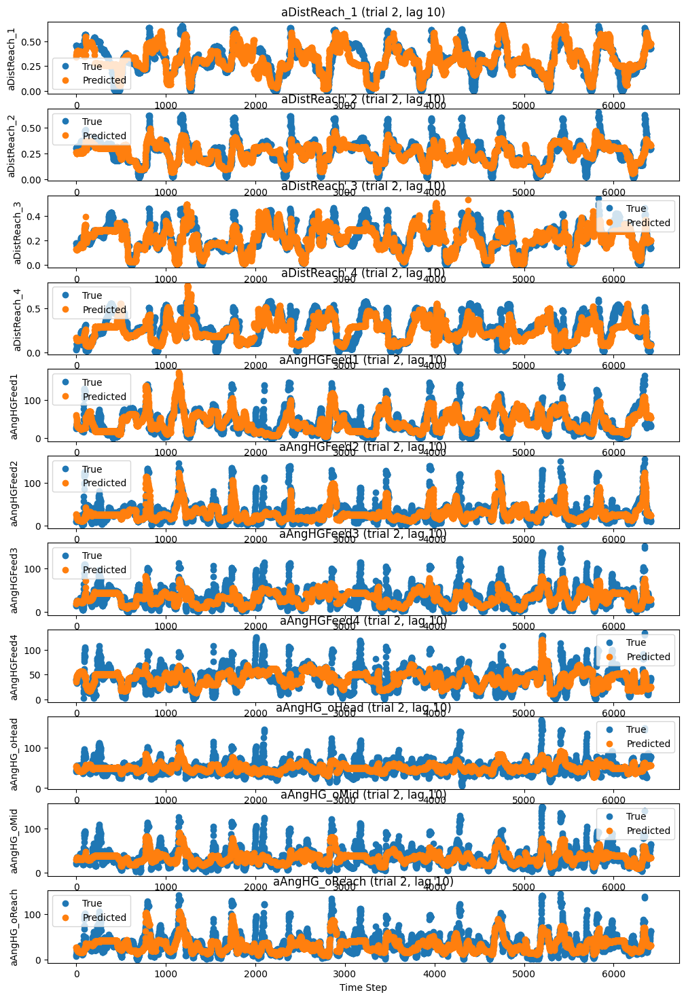

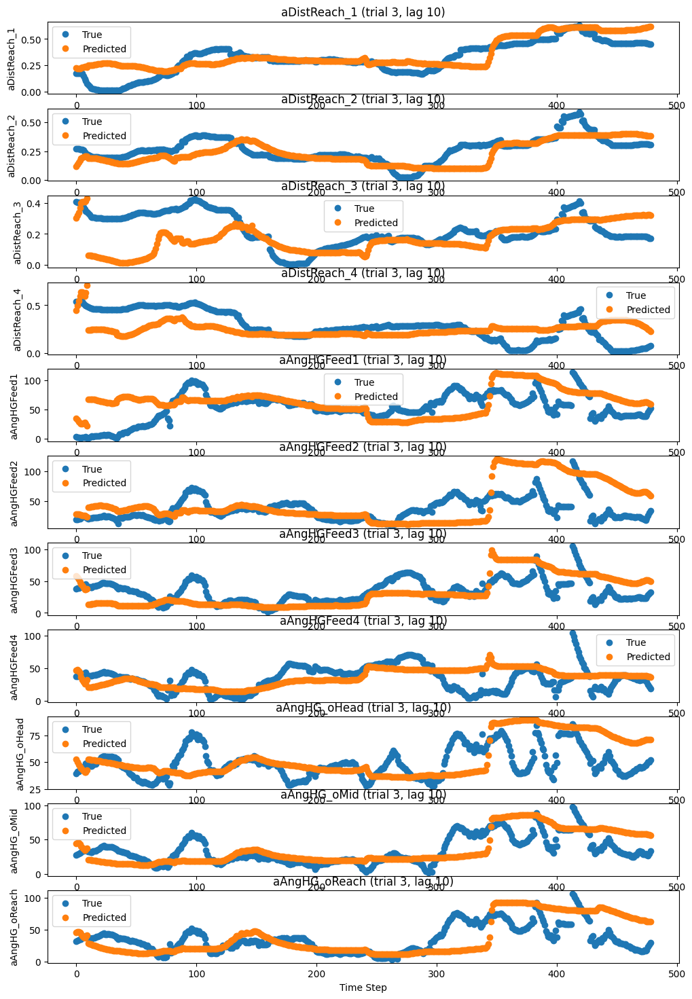

Value 'model_10_val3: 0.5727635622024536' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val3: 0.24910934' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val3: 0.61380094' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 00505: reducing learning rate of group 0 to 6.5610e-03.
Epoch 10/250, Training Loss: 0.2717088758945465, Validation Loss: 0.24320639669895172
Epoch 20/250, Training Loss: 0.2555260956287384, Validation Loss: 0.2561703026294708
Epoch 00526: reducing learning rate of group 0 to 5.9049e-03.
Epoch 30/250, Training Loss: 0.25583621859550476, Validation Loss: 0.24722370505332947
Epoch 40/250, Training Loss: 0.2539755403995514, Validation Loss: 0.24077968299388885
Epoch 00547: reducing learning rate of group 0 to 5.3144e-0

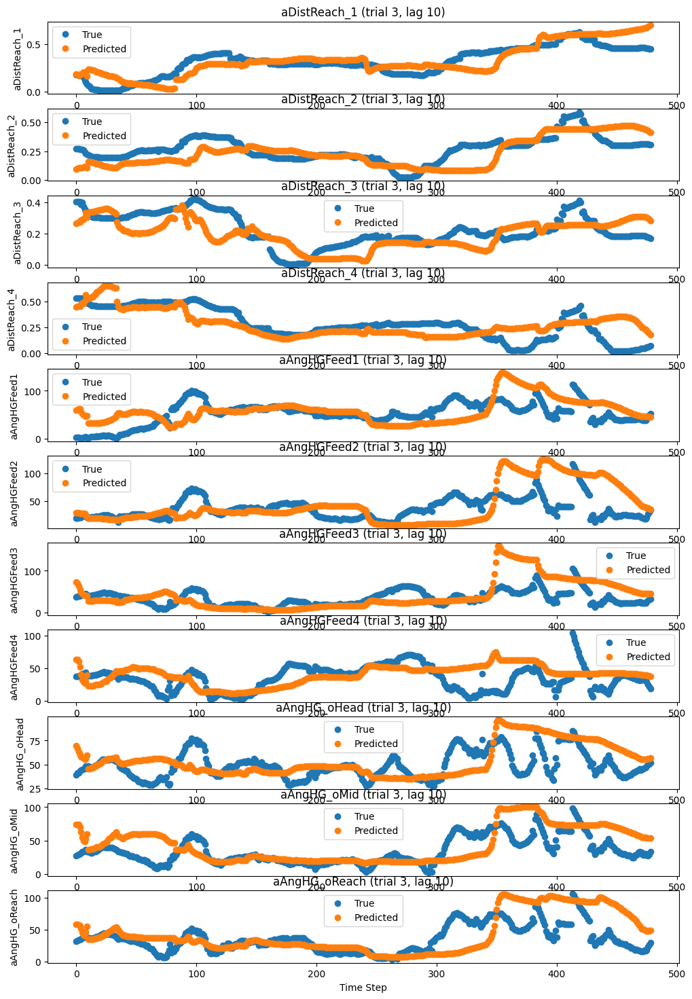

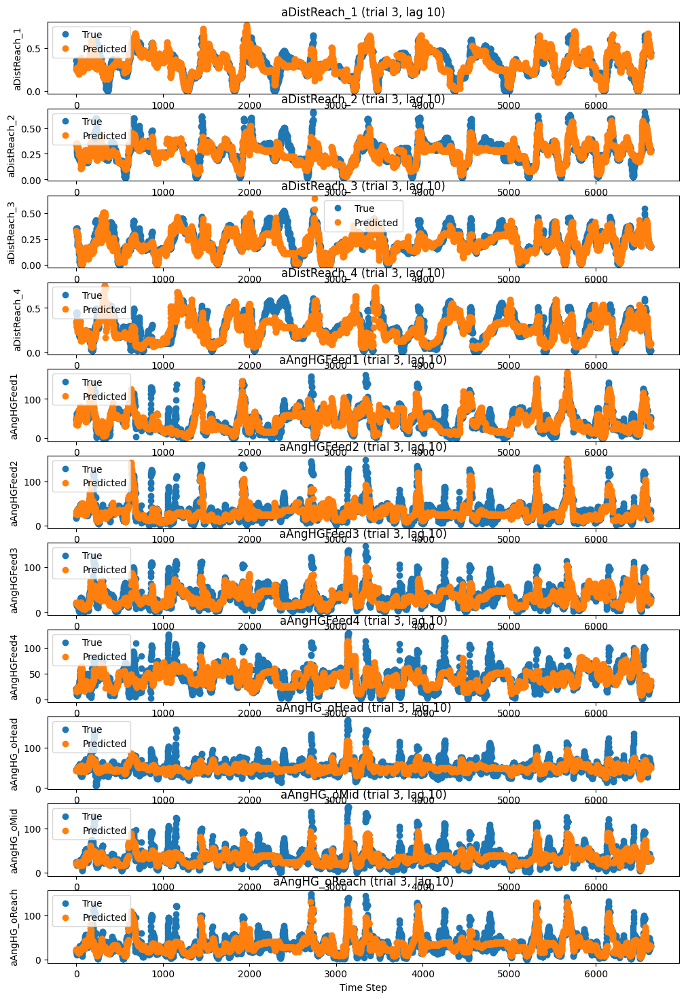

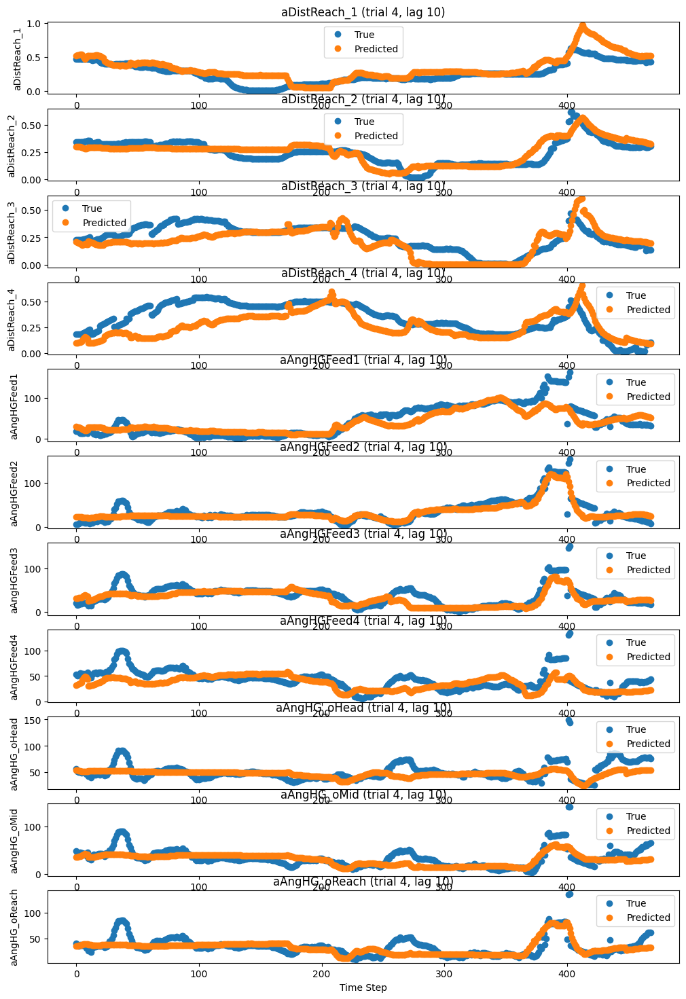

Value 'model_10_val4: 0.3579270839691162' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val4: 0.19575311' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val4: 0.53905135' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 10/250, Training Loss: 0.23556536436080933, Validation Loss: 0.1868659406900406
Epoch 00768: reducing learning rate of group 0 to 2.8243e-03.
Epoch 20/250, Training Loss: 0.21634380519390106, Validation Loss: 0.1783348172903061
Epoch 30/250, Training Loss: 0.22848927974700928, Validation Loss: 0.19171570241451263
Epoch 00789: reducing learning rate of group 0 to 2.5419e-03.
Epoch 40/250, Training Loss: 0.21873724460601807, Validation Loss: 0.19123879075050354
Epoch 50/250, Training Loss: 0.20537152886390686, Validat

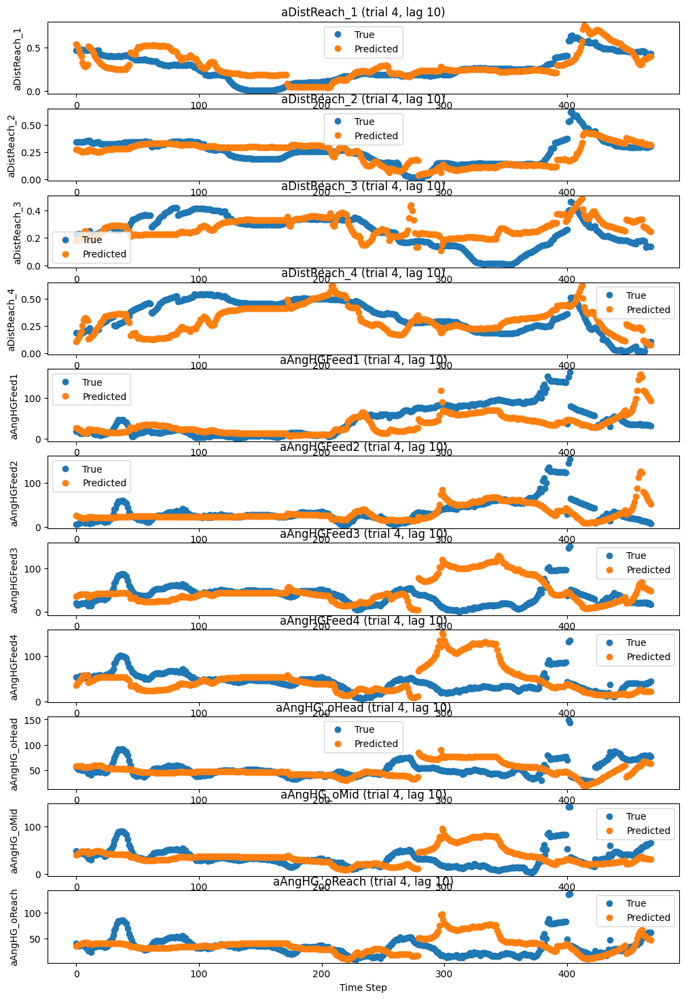

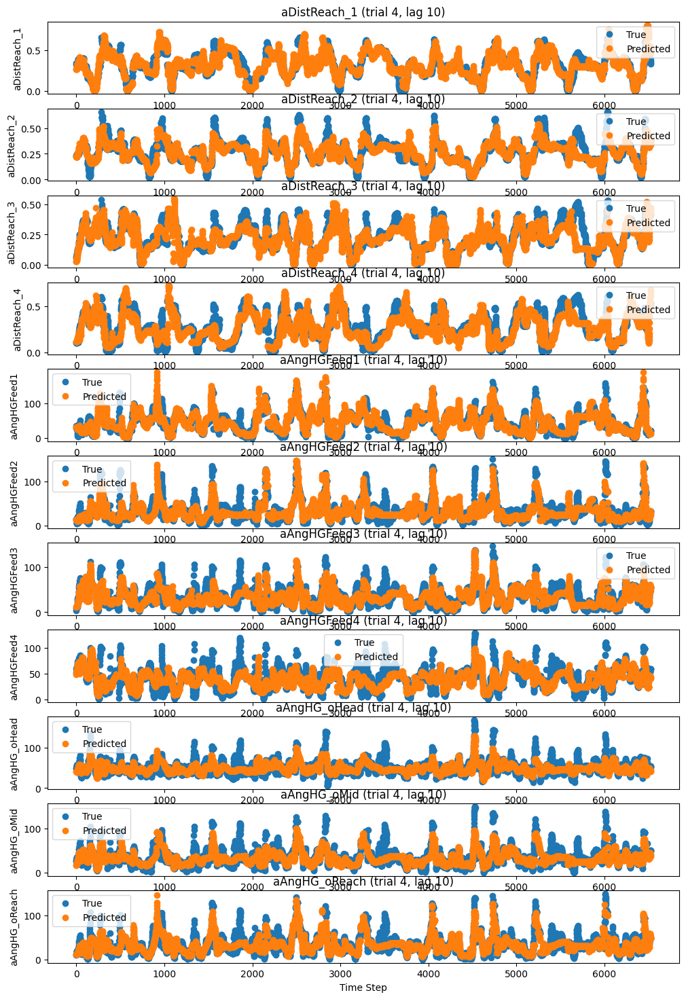

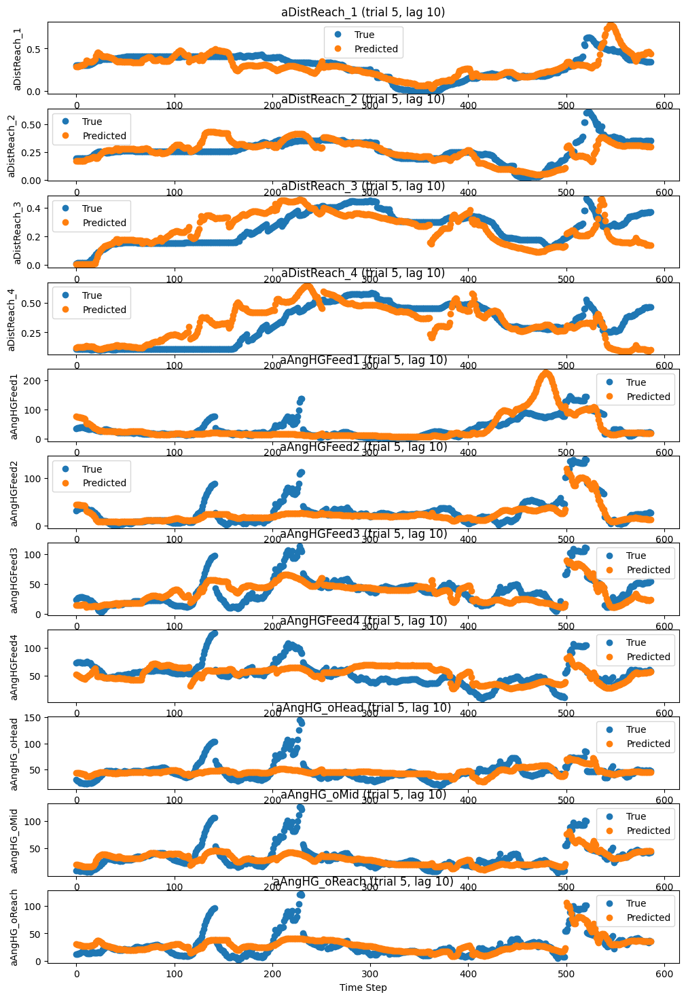

Value 'model_10_val5: 0.26010391116142273' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val5: 0.16763578' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val5: 0.58319265' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 10/250, Training Loss: 0.19990980625152588, Validation Loss: 0.16342216730117798
Epoch 01018: reducing learning rate of group 0 to 1.3509e-03.
Epoch 20/250, Training Loss: 0.21888995170593262, Validation Loss: 0.2668028771877289
Epoch 30/250, Training Loss: 0.19949795305728912, Validation Loss: 0.2683168947696686
Epoch 01039: reducing learning rate of group 0 to 1.2158e-03.
Epoch 40/250, Training Loss: 0.19011306762695312, Validation Loss: 0.26960745453834534
Epoch 50/250, Training Loss: 0.18129149079322815, Valida

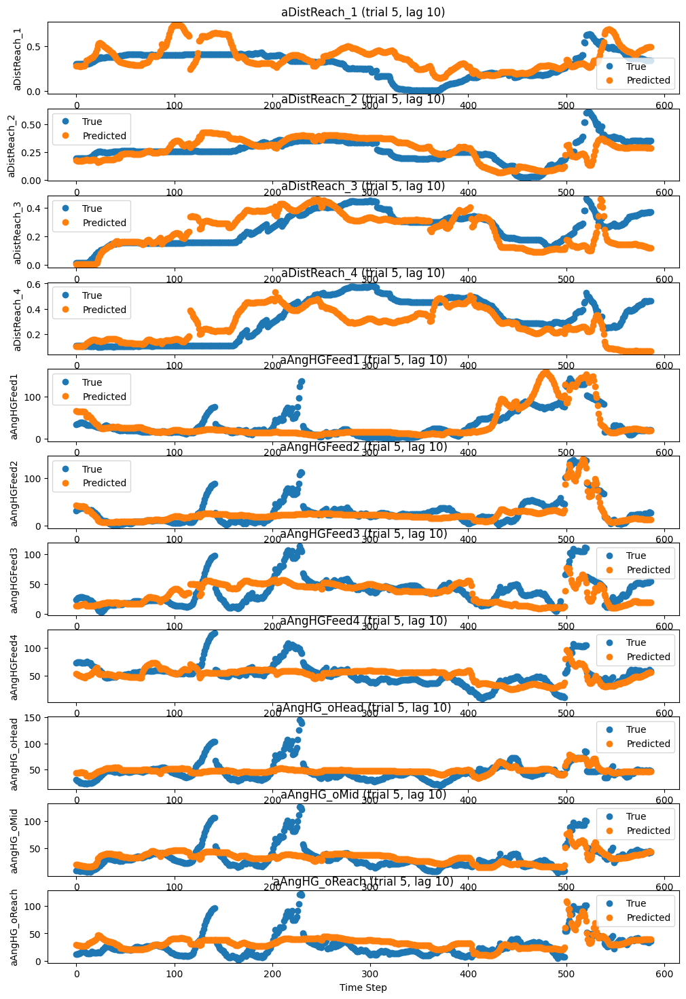

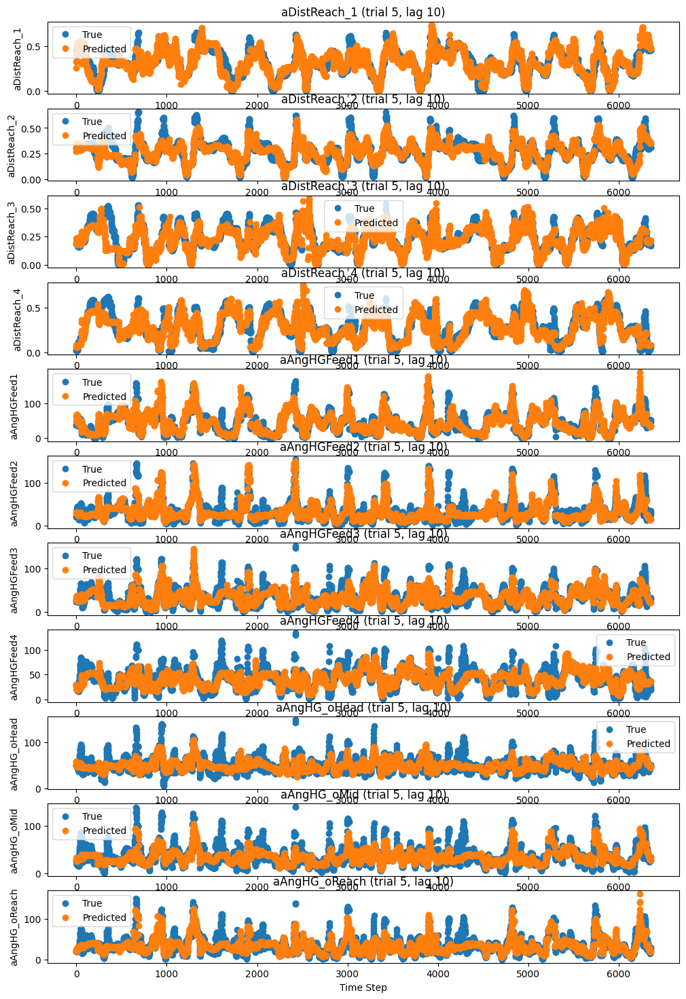

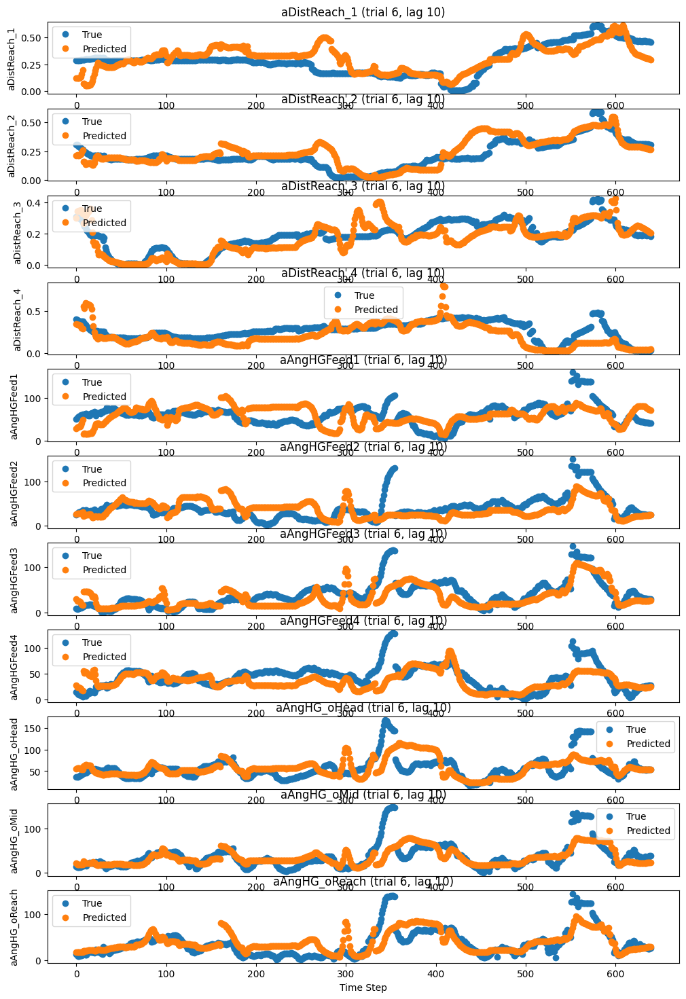

Value 'model_10_val6: 0.32781466841697693' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val6: 0.15781888' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val6: 0.38002592' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 01251: reducing learning rate of group 0 to 5.8150e-04.
Epoch 10/250, Training Loss: 0.17597411572933197, Validation Loss: 0.2637755572795868
Epoch 20/250, Training Loss: 0.1677396446466446, Validation Loss: 0.26972684264183044
Epoch 01272: reducing learning rate of group 0 to 5.2335e-04.
Epoch 30/250, Training Loss: 0.16298049688339233, Validation Loss: 0.2746564745903015
Epoch 40/250, Training Loss: 0.1599273681640625, Validation Loss: 0.2815379202365875
Epoch 01293: reducing learning rate of group 0 to 4.7101e-0

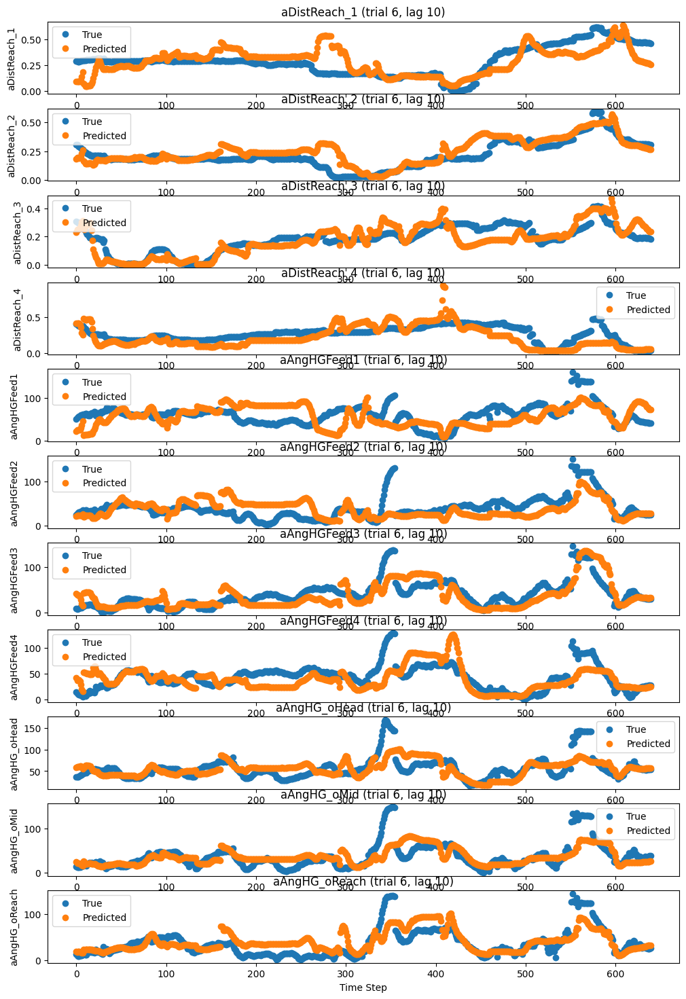

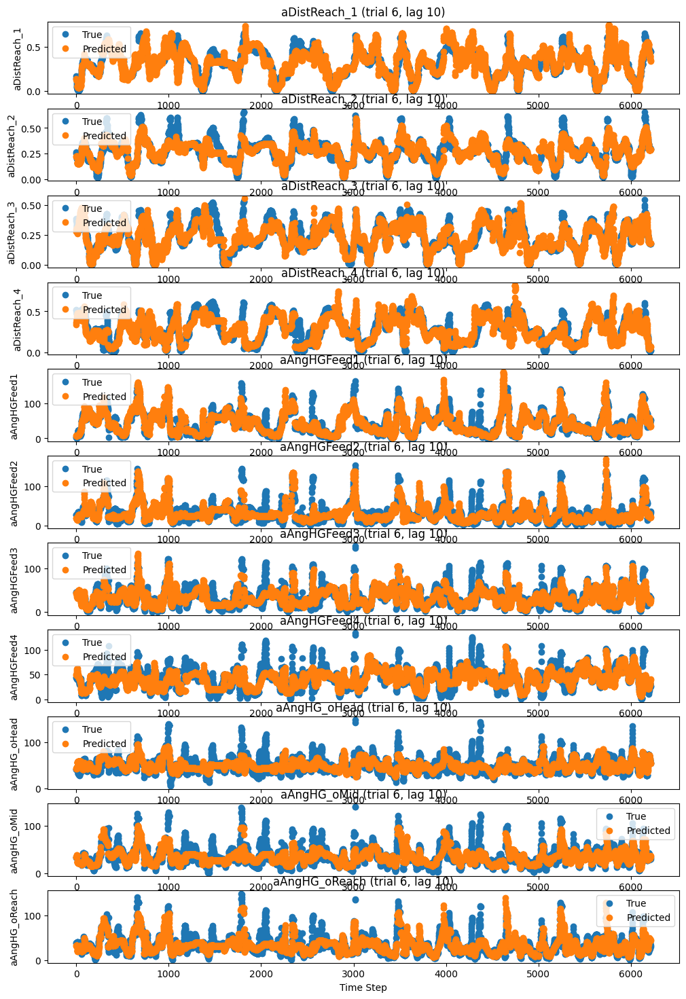

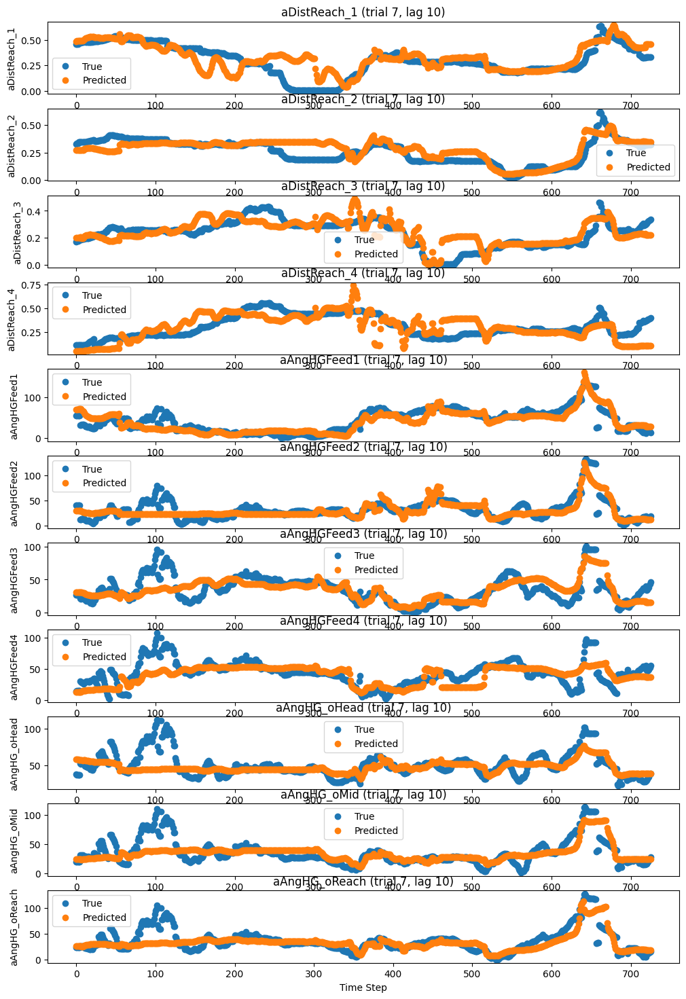

Value 'model_10_val7: 0.32972556352615356' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val7: 0.14024138' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val7: 0.36062706' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 10/250, Training Loss: 0.15854714810848236, Validation Loss: 0.16199716925621033
Epoch 01512: reducing learning rate of group 0 to 3.4337e-04.
Epoch 20/250, Training Loss: 0.15388305485248566, Validation Loss: 0.1754029542207718
Epoch 30/250, Training Loss: 0.15081197023391724, Validation Loss: 0.18028536438941956
Epoch 01533: reducing learning rate of group 0 to 3.0903e-04.
Epoch 40/250, Training Loss: 0.14866158366203308, Validation Loss: 0.18448607623577118
Epoch 50/250, Training Loss: 0.14685258269309998, Valid

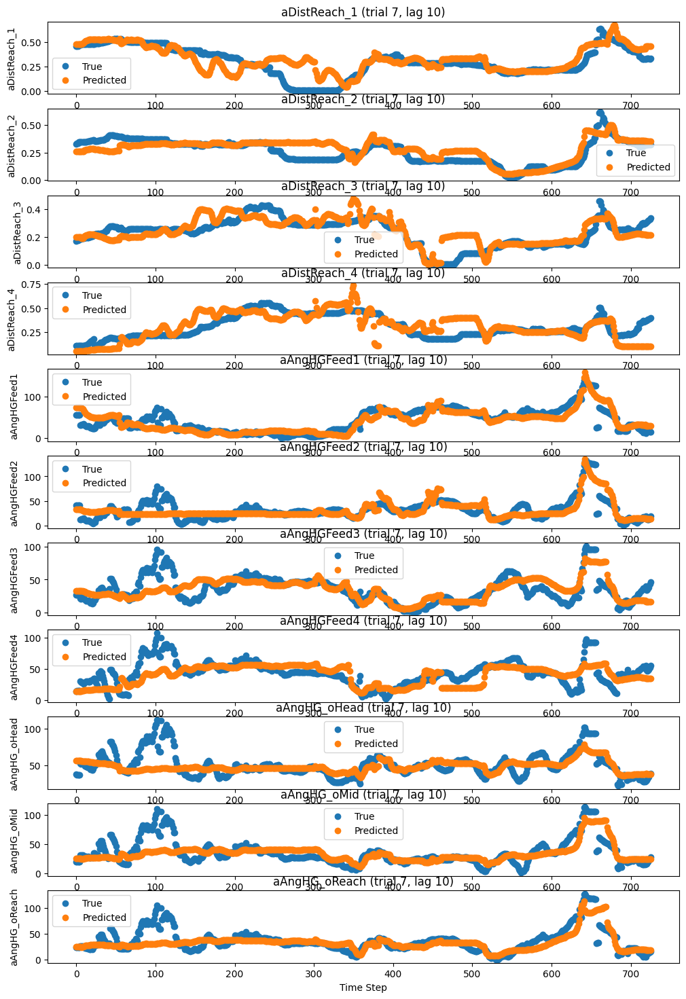

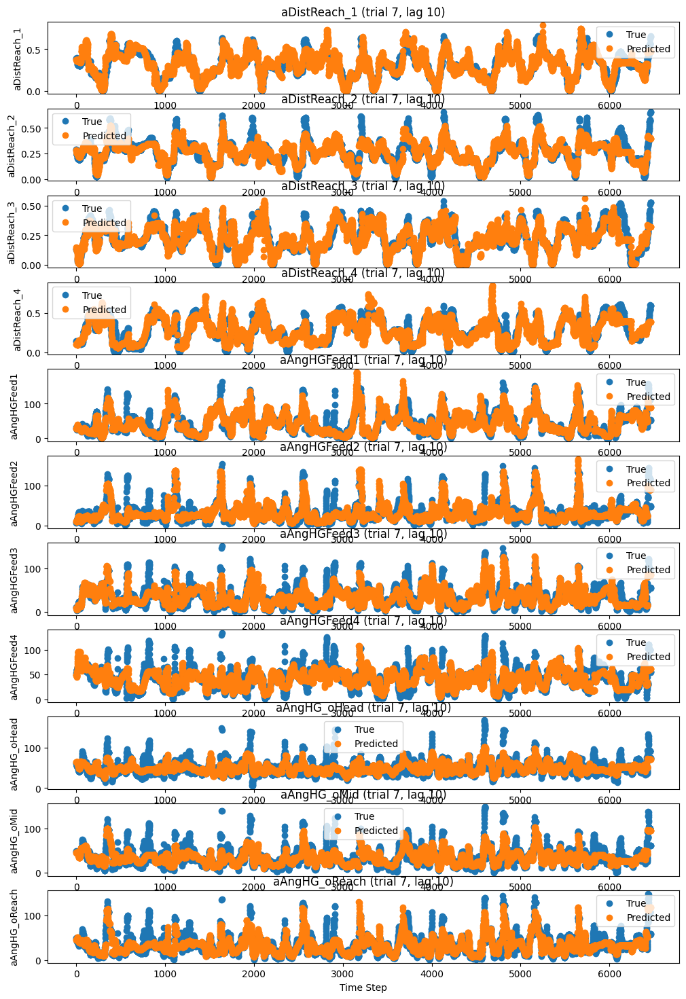

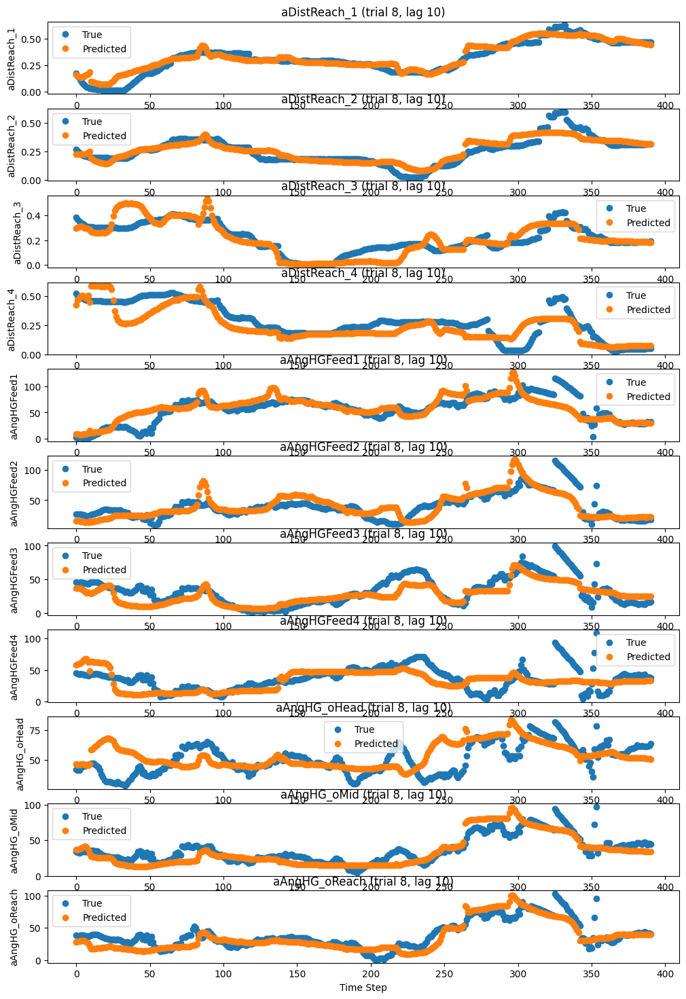

Value 'model_10_val8: 0.23758351802825928' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val8: 0.13562417' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val8: 0.32435602' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 10/250, Training Loss: 0.15781362354755402, Validation Loss: 0.18373136222362518
Epoch 01769: reducing learning rate of group 0 to 1.0775e-04.
Epoch 20/250, Training Loss: 0.1558840423822403, Validation Loss: 0.18243634700775146
Epoch 30/250, Training Loss: 0.15488368272781372, Validation Loss: 0.1875028908252716
Epoch 01790: reducing learning rate of group 0 to 9.6977e-05.
Epoch 40/250, Training Loss: 0.15379485487937927, Validation Loss: 0.19617773592472076
Epoch 50/250, Training Loss: 0.15291710197925568, Valida

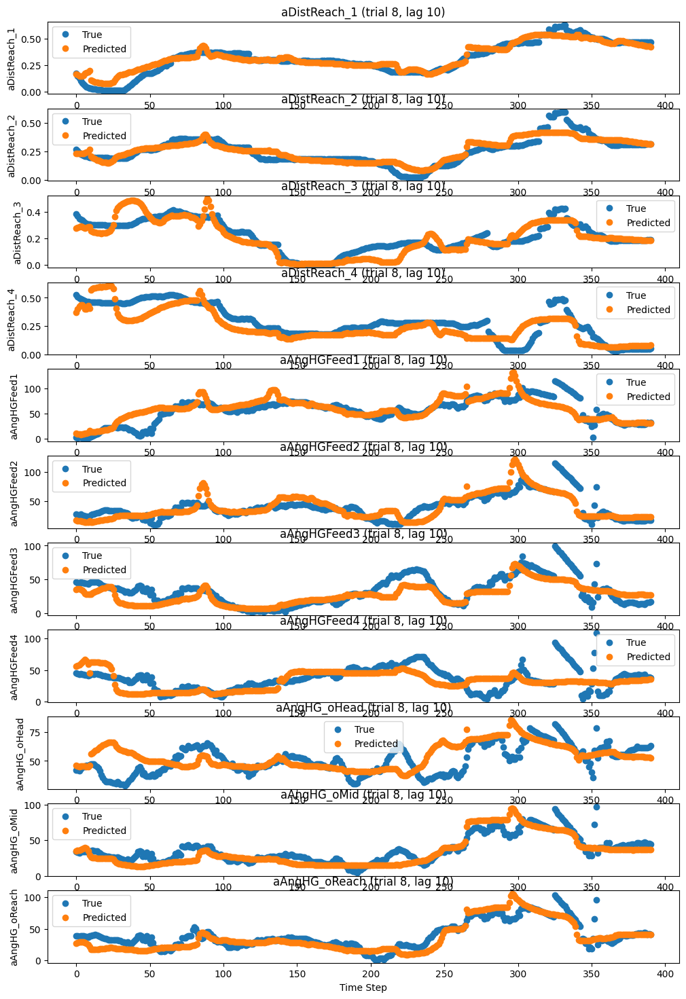

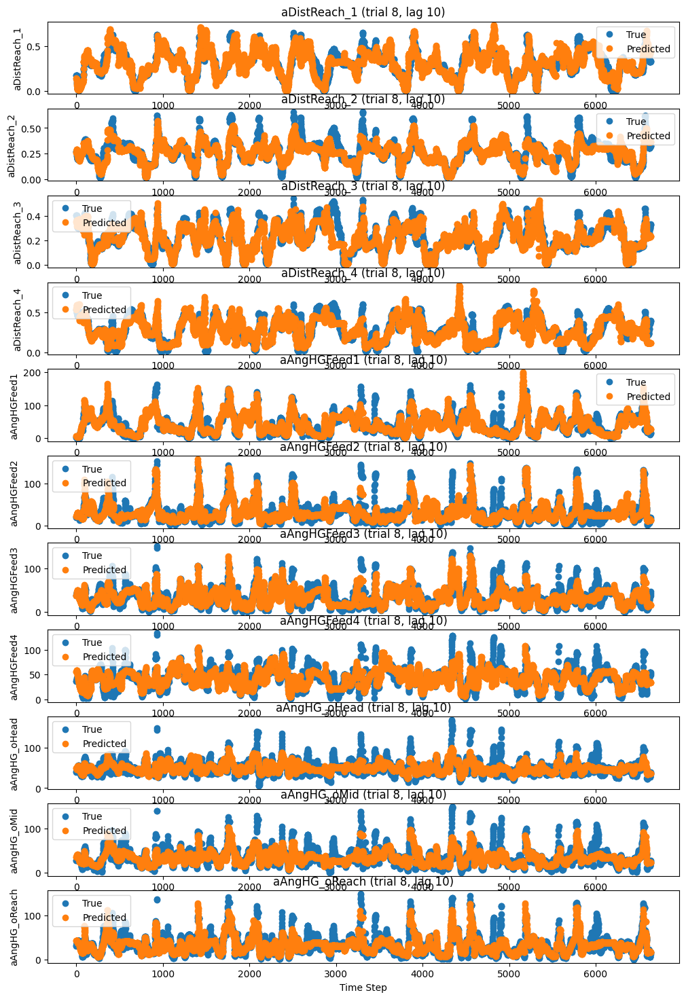

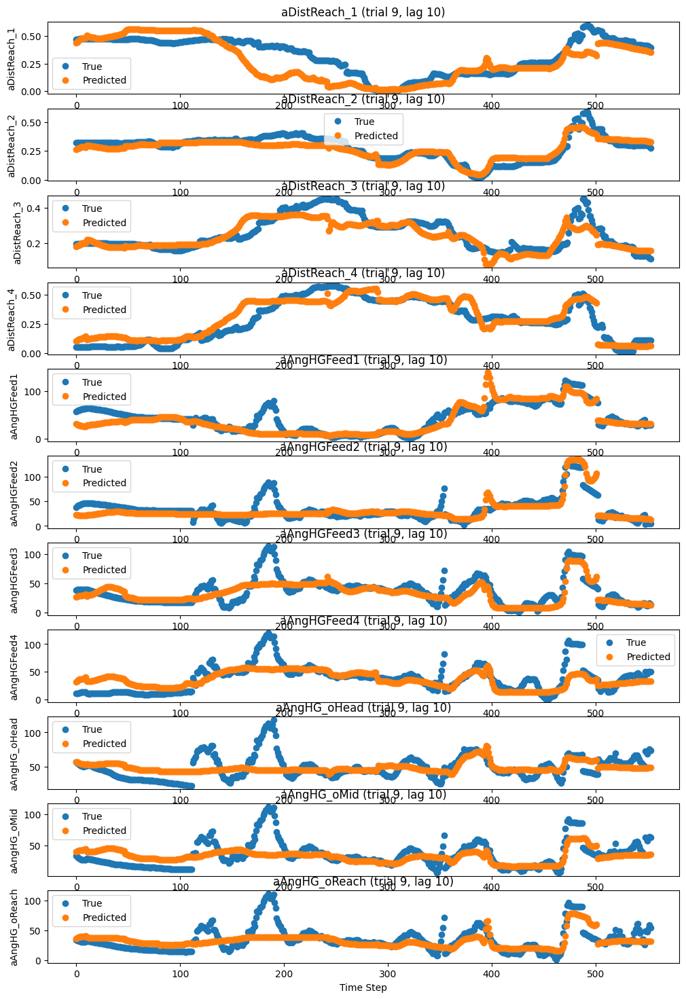

Value 'model_10_val9: 0.21299706399440765' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val9: 0.14775427' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val9: 0.2272345' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 10/250, Training Loss: 0.15709088742733002, Validation Loss: 0.10112631320953369
Epoch 20/250, Training Loss: 0.1561143398284912, Validation Loss: 0.10161047428846359
Epoch 02021: reducing learning rate of group 0 to 3.0433e-05.
Epoch 30/250, Training Loss: 0.15542177855968475, Validation Loss: 0.1017460748553276
Epoch 40/250, Training Loss: 0.15495619177818298, Validation Loss: 0.10197300463914871
Epoch 02042: reducing learning rate of group 0 to 2.7389e-05.
Epoch 50/250, Training Loss: 0.15460218489170074, Validat

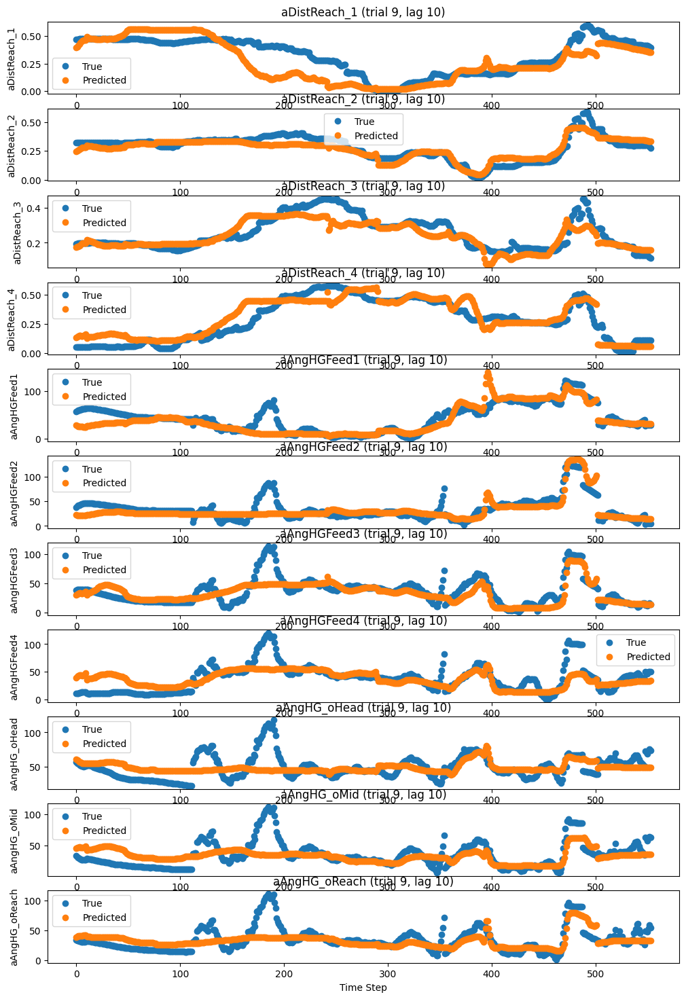

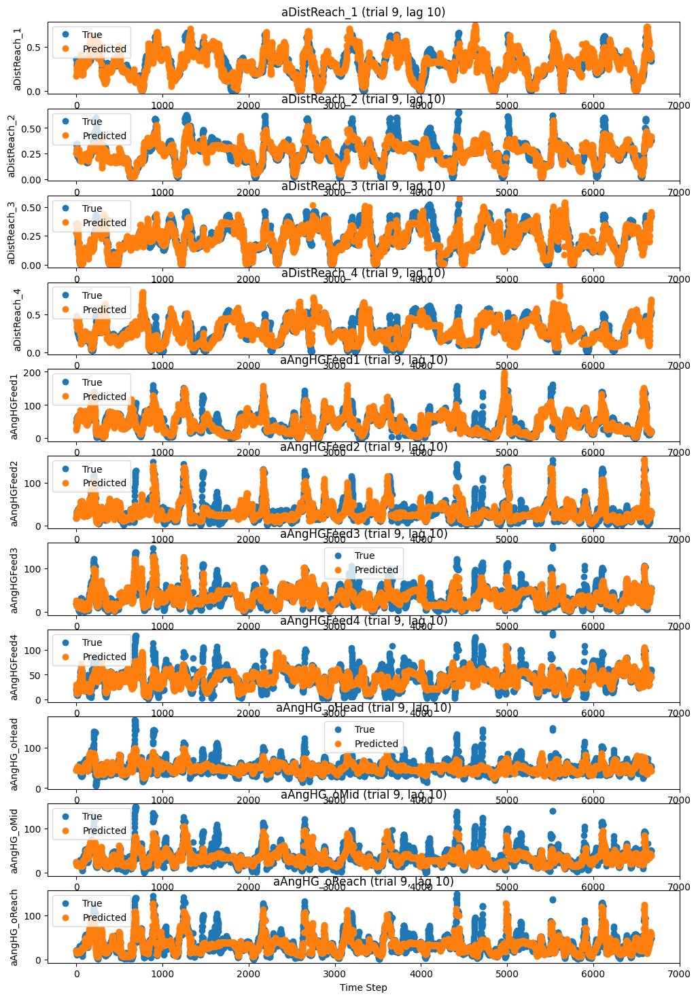

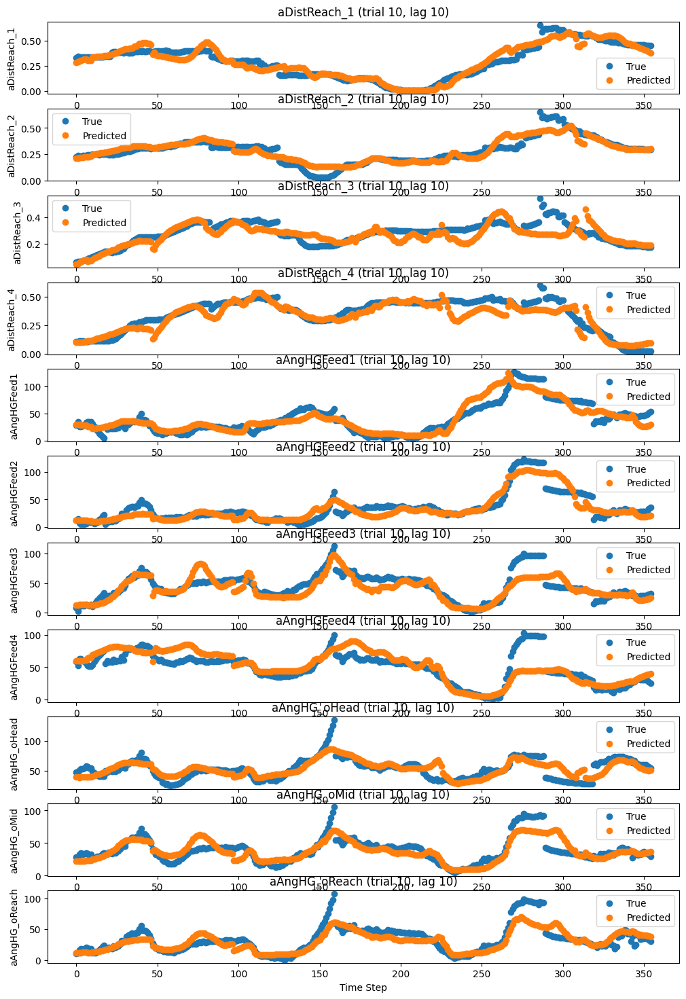

Value 'model_10_val10: 0.10438653081655502' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val10: 0.15211691' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val10: 0.22369328' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 02252: reducing learning rate of group 0 to 9.5500e-06.
Epoch 10/250, Training Loss: 0.16314855217933655, Validation Loss: 0.094663105905056
Epoch 20/250, Training Loss: 0.16251161694526672, Validation Loss: 0.09458883106708527
Epoch 02273: reducing learning rate of group 0 to 8.5950e-06.
Epoch 30/250, Training Loss: 0.16209159791469574, Validation Loss: 0.09480082243680954
Epoch 40/250, Training Loss: 0.16177301108837128, Validation Loss: 0.09493938088417053
Epoch 02294: reducing learning rate of group 0 to 7.7

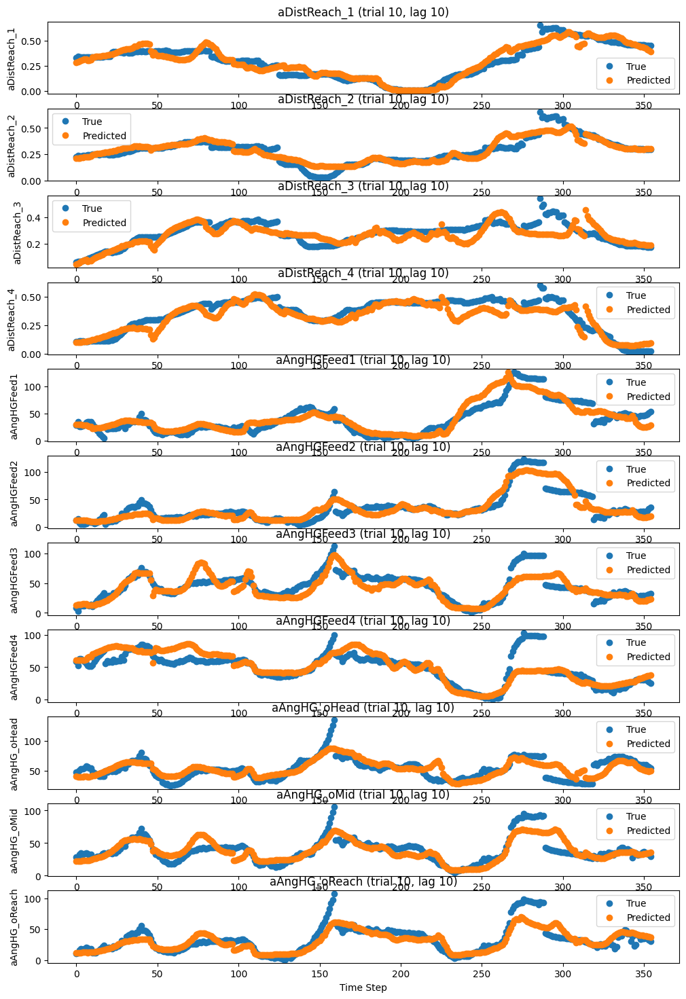

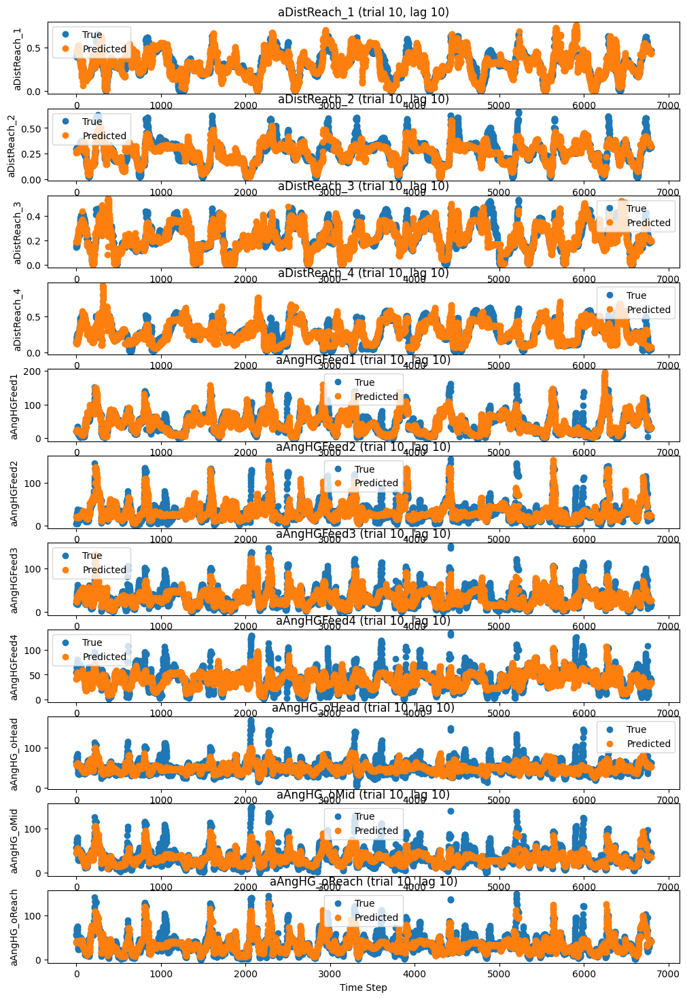

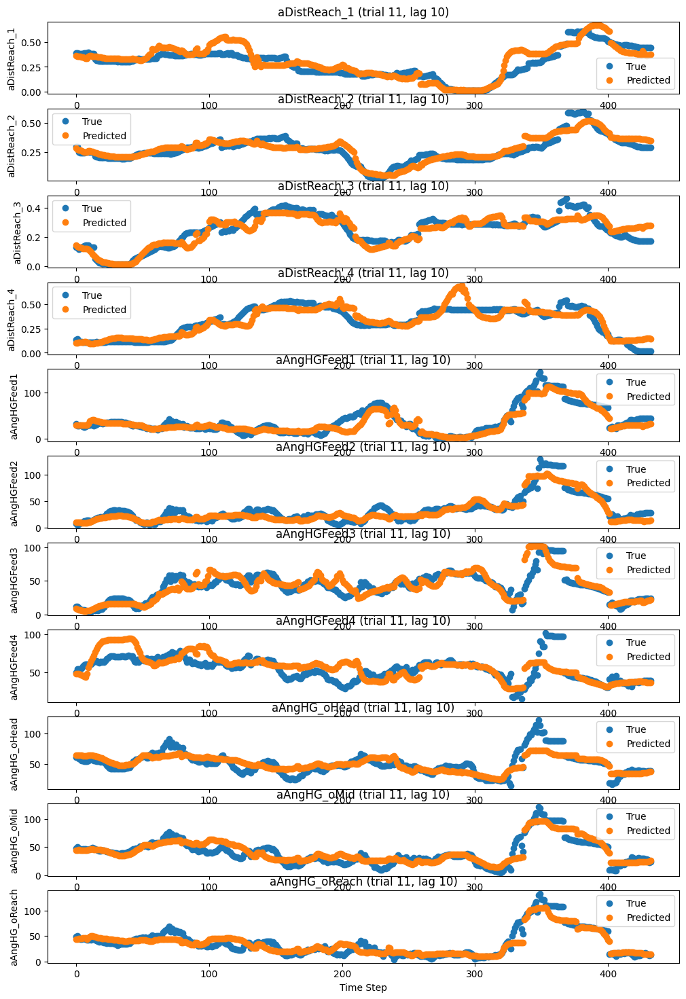

Value 'model_10_val11: 0.09746632725000381' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val11: 0.1596829' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val11: 0.10403726' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 02504: reducing learning rate of group 0 to 2.6972e-06.
Epoch 10/250, Training Loss: 0.16231584548950195, Validation Loss: 0.07064909487962723
Epoch 20/250, Training Loss: 0.16224434971809387, Validation Loss: 0.07068335264921188
Epoch 02525: reducing learning rate of group 0 to 2.4275e-06.
Epoch 30/250, Training Loss: 0.16217158734798431, Validation Loss: 0.07071679085493088
Epoch 40/250, Training Loss: 0.16210465133190155, Validation Loss: 0.07075939327478409
Epoch 02546: reducing learning rate of group 0 to 2.

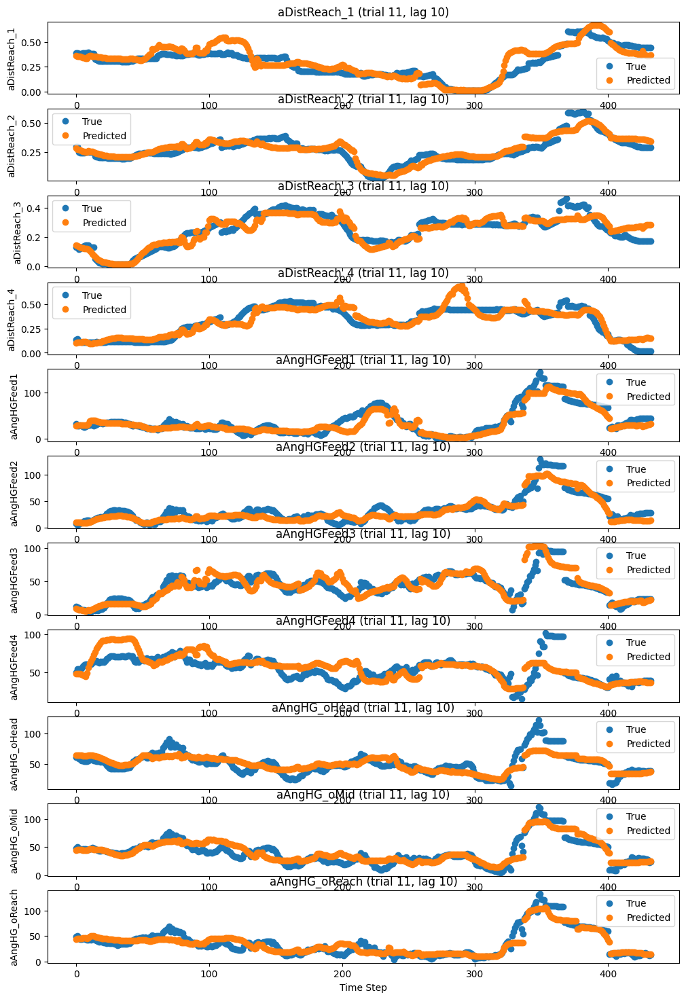

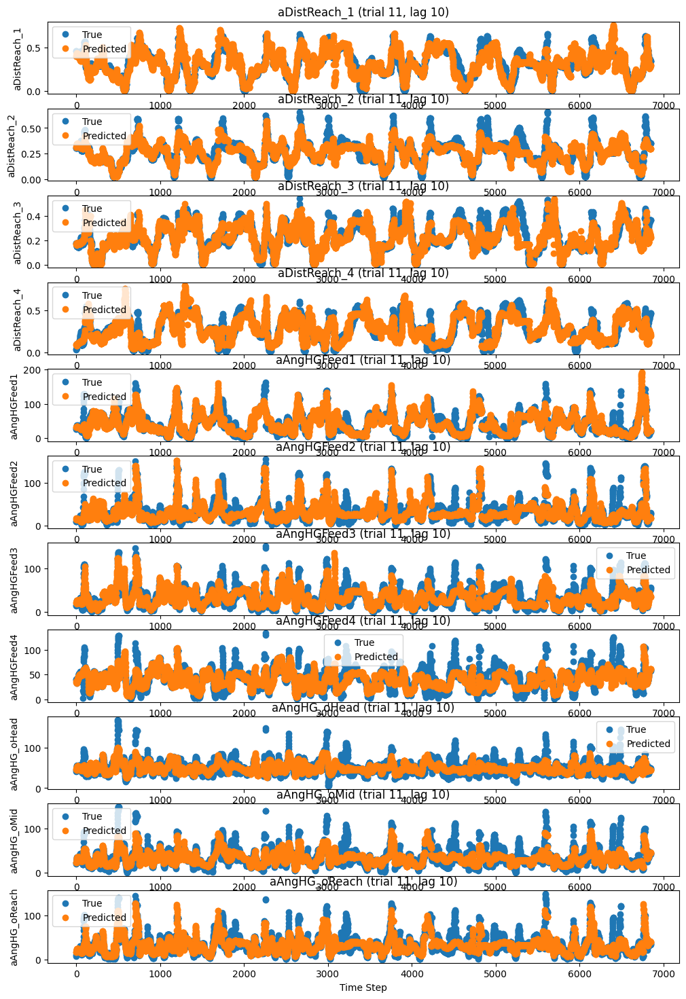

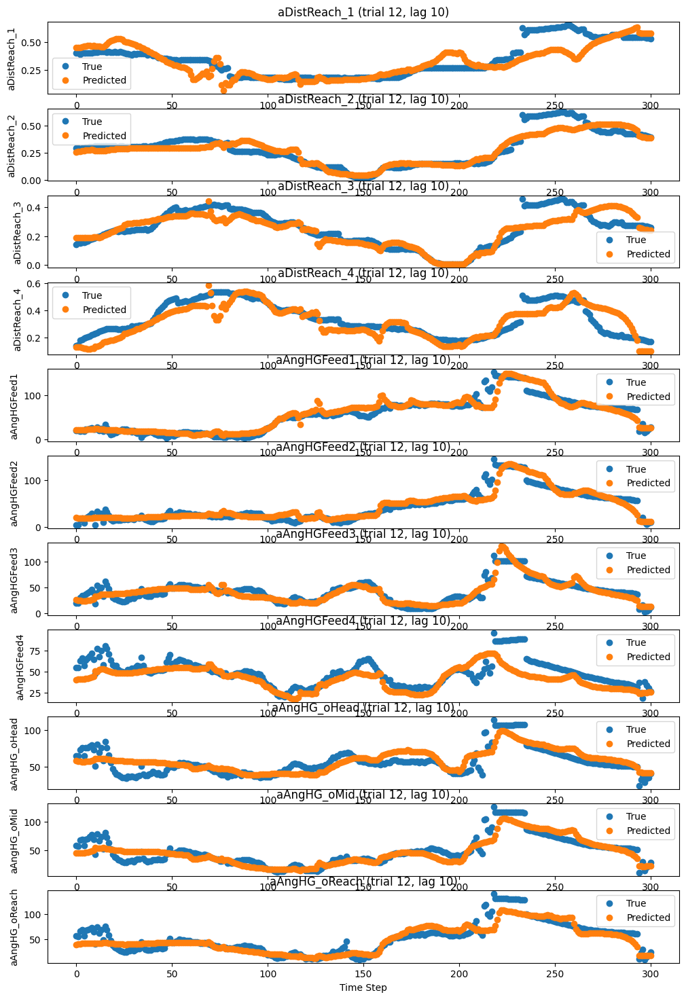

Value 'model_10_val12: 0.07143513113260269' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val12: 0.16141874' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val12: 0.09838052' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 02756: reducing learning rate of group 0 to 7.6177e-07.
Epoch 10/250, Training Loss: 0.16245096921920776, Validation Loss: 0.09235910326242447
Epoch 20/250, Training Loss: 0.1624184101819992, Validation Loss: 0.09232351183891296
Epoch 02777: reducing learning rate of group 0 to 6.8560e-07.
Epoch 30/250, Training Loss: 0.1623876541852951, Validation Loss: 0.09229934960603714
Epoch 40/250, Training Loss: 0.16236060857772827, Validation Loss: 0.09228769689798355
Epoch 02798: reducing learning rate of group 0 to 6.1

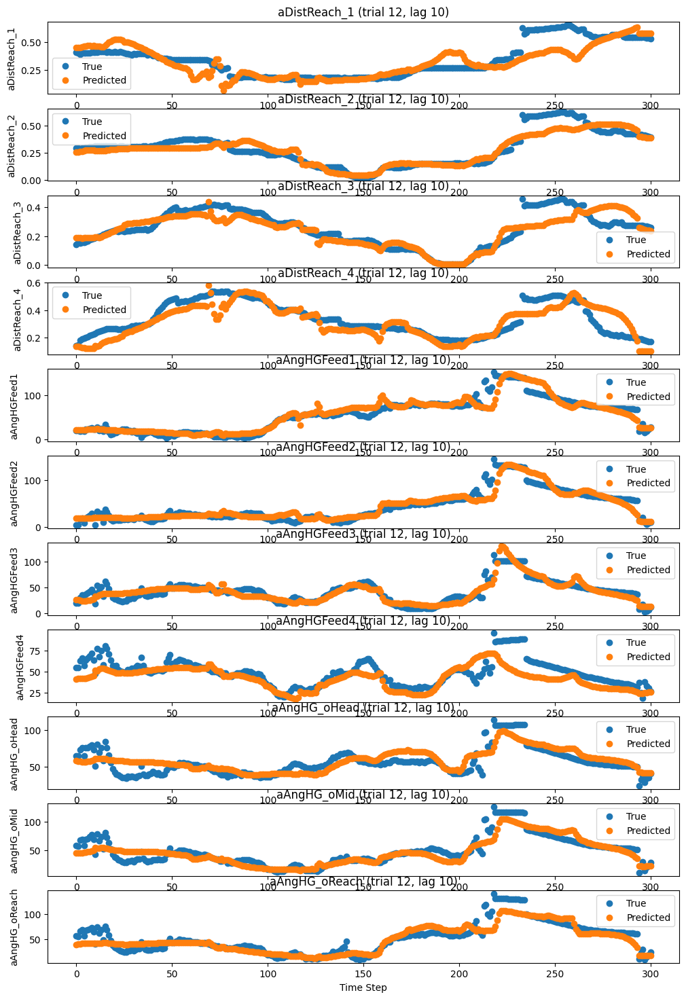

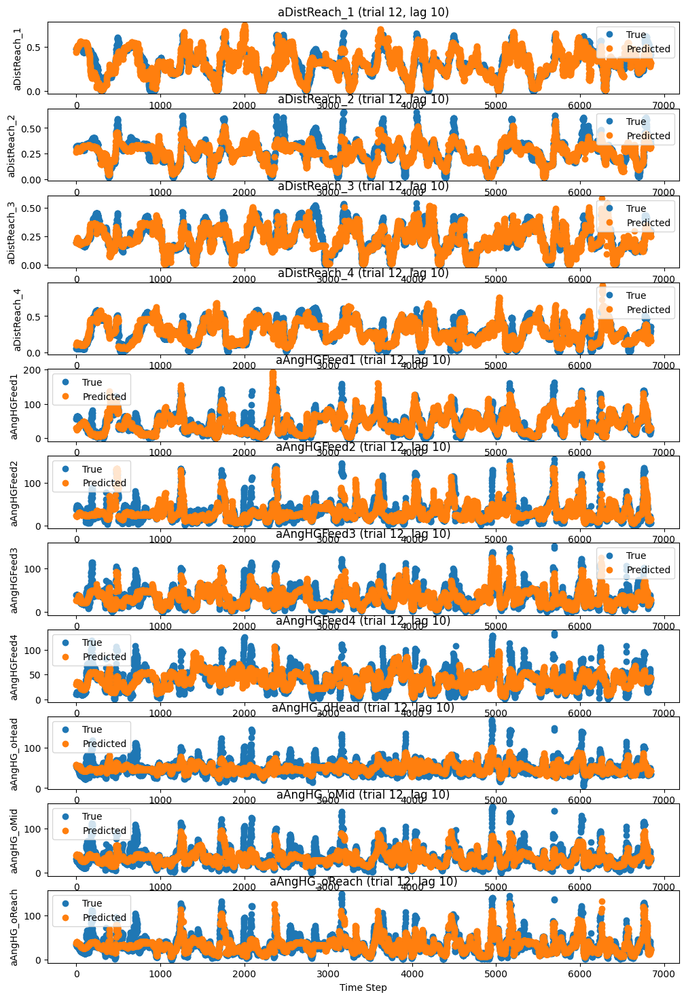

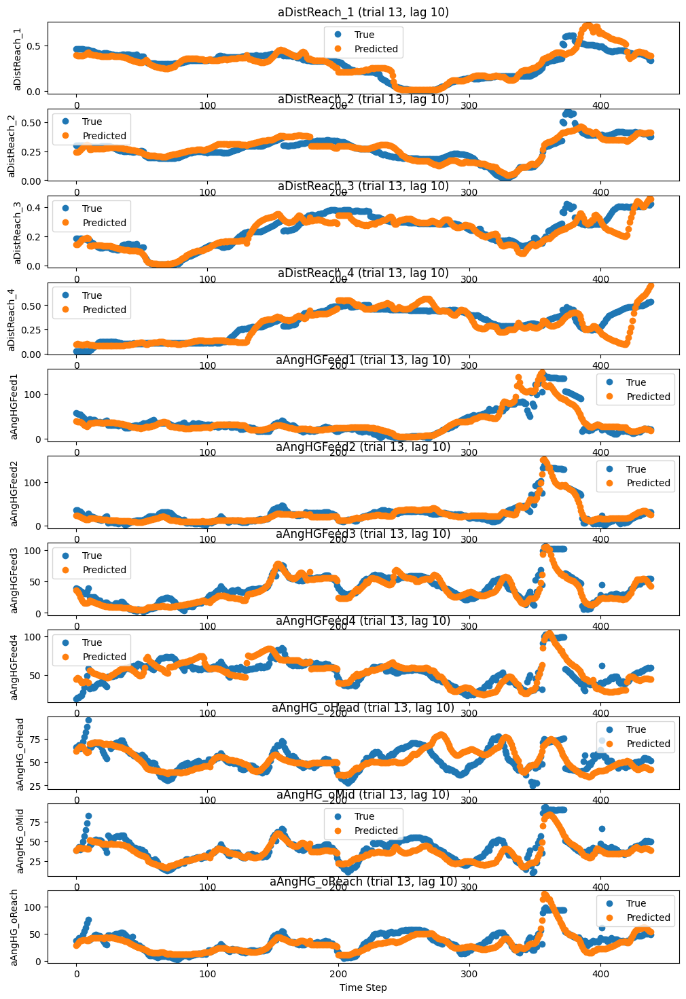

Value 'model_10_val13: 0.09247149527072906' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val13: 0.16209896' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val13: 0.07081592' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 03008: reducing learning rate of group 0 to 2.1515e-07.
Epoch 10/250, Training Loss: 0.16264234483242035, Validation Loss: 0.1490747332572937
Epoch 20/250, Training Loss: 0.1626284271478653, Validation Loss: 0.14910784363746643
Epoch 03029: reducing learning rate of group 0 to 1.9363e-07.
Epoch 30/250, Training Loss: 0.16261301934719086, Validation Loss: 0.1491454392671585
Epoch 40/250, Training Loss: 0.16259920597076416, Validation Loss: 0.14917995035648346
Epoch 03050: reducing learning rate of group 0 to 1.74

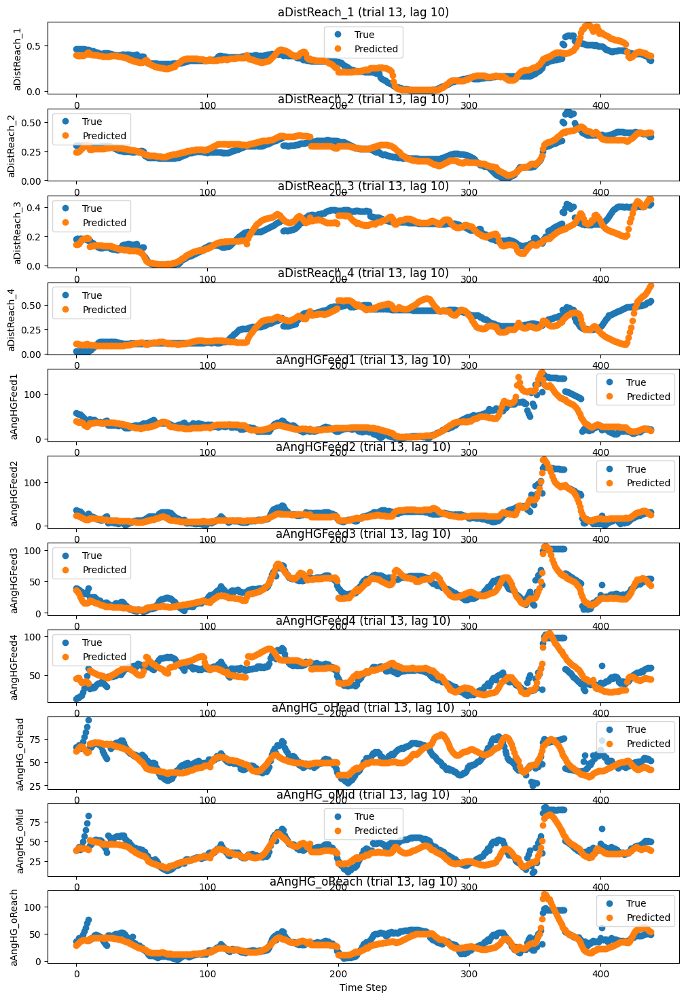

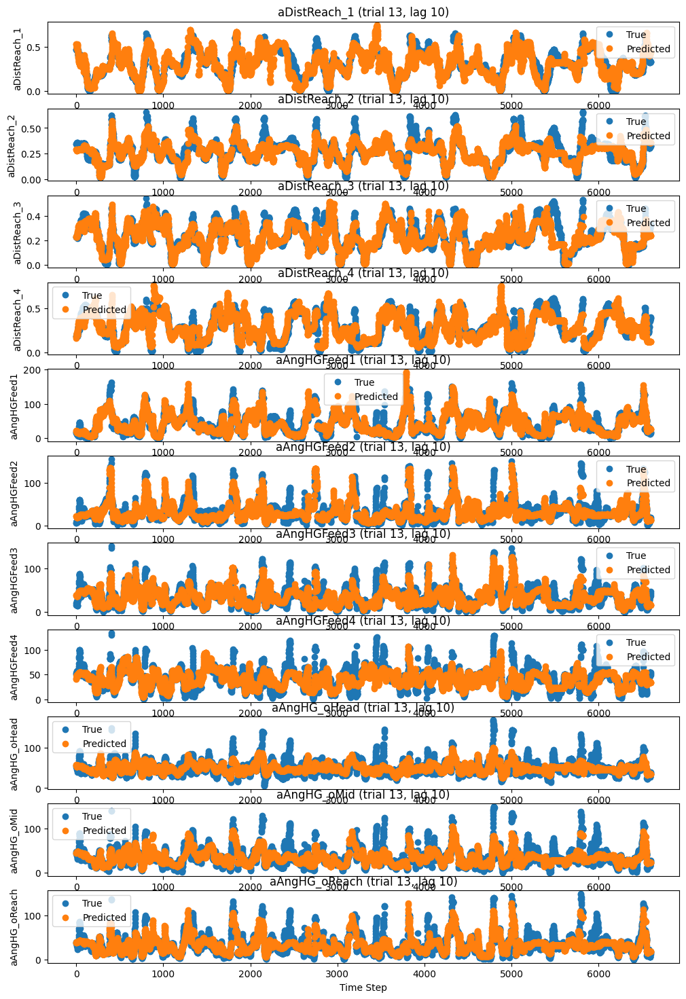

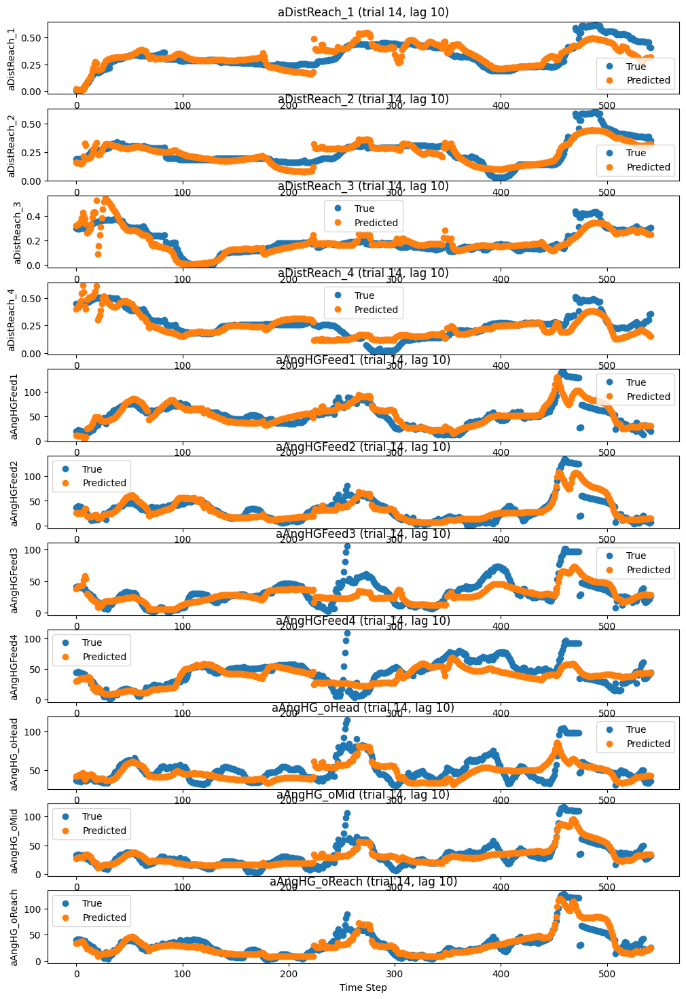

Value 'model_10_val14: 0.14959579706192017' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_val/s_results_train.txt' successfully.
Value 'model_10_val14: 0.16244188' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_train/s_results_train.txt' successfully.
Value 'model_10_val14: 0.09294861' saved to 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\results_test/s_results_train.txt' successfully.
Epoch 10/250, Training Loss: 0.15724216401576996, Validation Loss: 0.11189132183790207
Epoch 20/250, Training Loss: 0.15723679959774017, Validation Loss: 0.11192983388900757
Epoch 30/250, Training Loss: 0.15723131597042084, Validation Loss: 0.11197346448898315
Epoch 40/250, Training Loss: 0.15722592175006866, Validation Loss: 0.1120162159204483
Epoch 50/250, Training Loss: 0.15722069144248962, Validation Loss: 0.1120569258928299
Epoch 60/250, Training Loss: 0.15721571445465088, Validation Loss: 0.11209625750780106
Epo

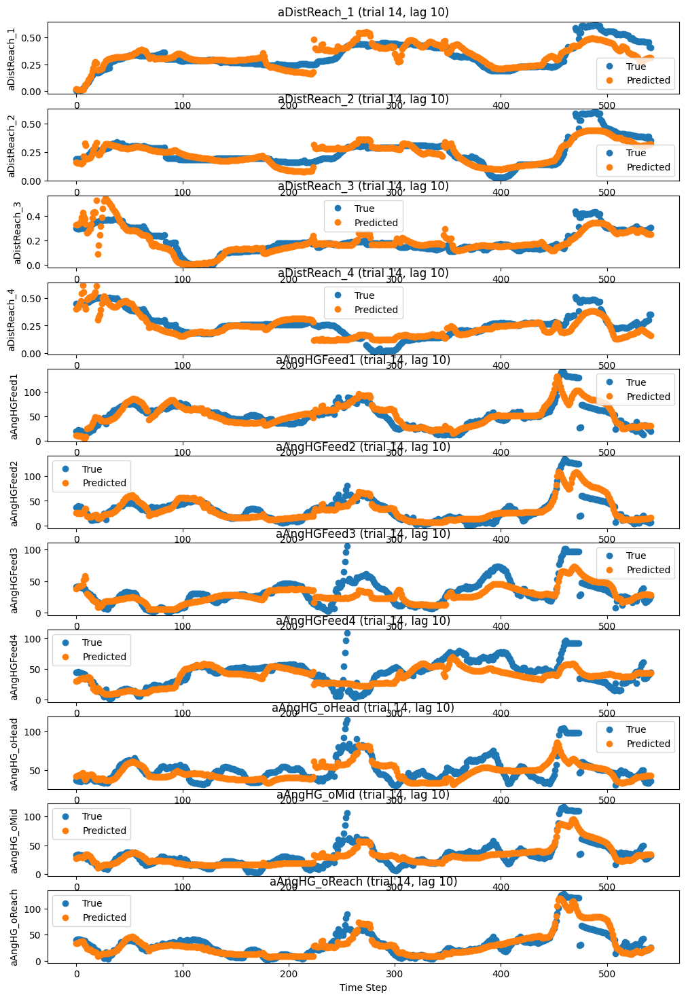

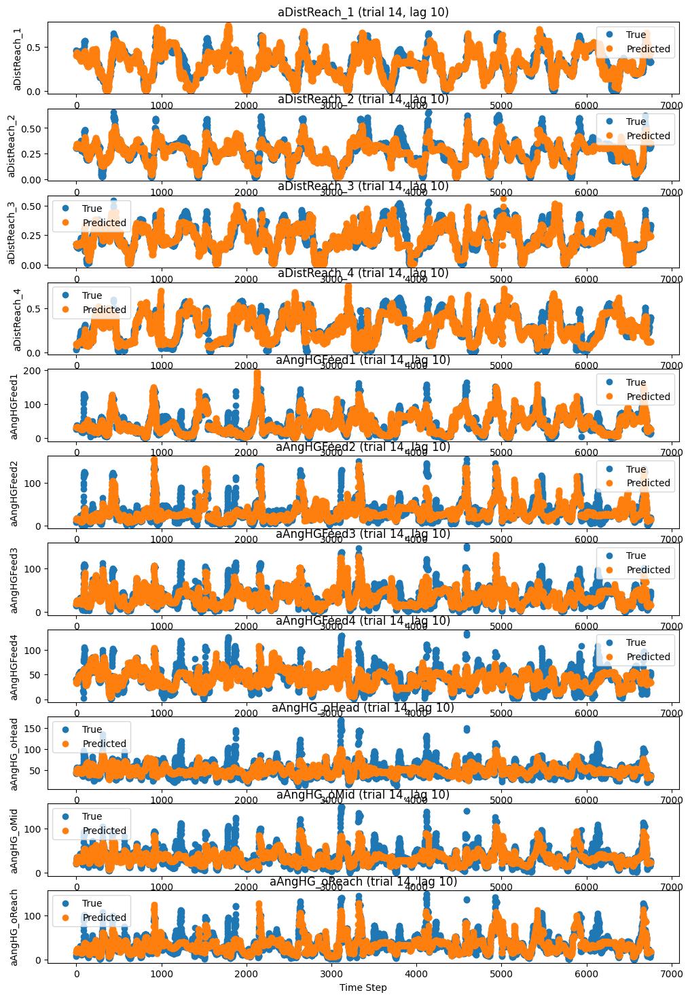

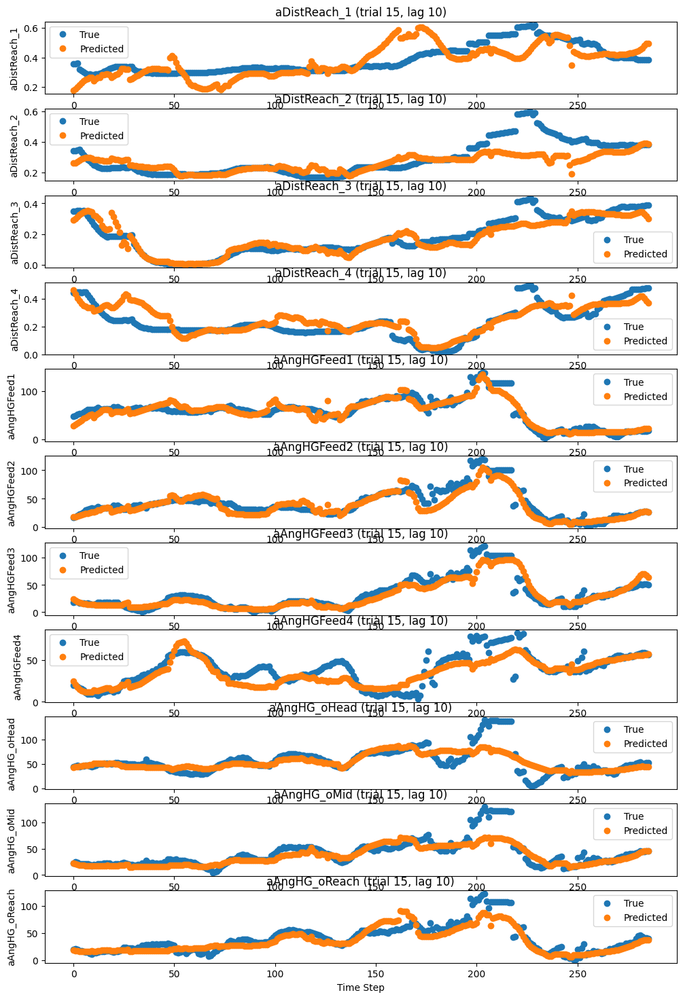

PermissionError: [Errno 13] Permission denied: 'C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350\\metrics\\MSE_train.csv'

In [57]:
data = "data_model_v1.csv"
df = pd.read_csv(data)
df = df.drop(columns='id')

labels = ['aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4','aAngHG_oHead', 'aAngHG_oMid','aAngHG_oReach']
columns_to_shift = ['oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4']

# Columns you want to apply log transformation to
columns_to_transform = ['aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach', 'aAngHGFeed1',
'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4', 'aDistReach_1',
'aDistReach_2', 'aDistReach_3', 'aDistReach_4', 'oAngHGFeed1',
'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4', 'oDistReach1',
'oDistReach2', 'oDistReach3', 'oDistReach4']

# Apply log transformation (natural log)
df[columns_to_transform] = df[columns_to_transform].apply(np.log)


# Hyperparameters
input_dim = 16
hidden_dim = 32
output_dim = 11
num_layers = 2
n_epochs = 250
lr = 0.01
seq_length = 50
#clip_value = 1.0
# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers).to(device)

loss_fn = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=20, verbose=True, threshold=0.01, threshold_mode='rel')



current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/log_seq50__l2_h32_e350"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)

values = [10,30,100]
model_probabilities = {}
model_probabilities_train = {}
mse_train = {}
mae_train = {}
r2_train = {}
mse_val = {}
mae_val = {}
r2_val = {}

for i in values:
    for j in np.arange(1,16):
        shift = i
        test_set = j
        val_set = j+1
        if test_set == 15:
          val_set = 1
        model_name = 'model_'+str(shift)+'_'+'val'+str(val_set)
        mse_train[model_name] = []
        mae_train[model_name] = []
        r2_train[model_name] = []
        mse_val[model_name] = []
        mae_val[model_name] = []
        r2_val[model_name] = [] 




        # Create an empty DataFrame to store the shifted data

        shifted_df = shift_dataframe(df=df,shift_value=shift,columns_to_shift=columns_to_shift)
        shifted_df = shuffle_trials(shifted_df)



        train_dataloader, test_dataloader, val_dataloader, fullset_dataloader = create_dataloaders(shifted_df,labels,seq_length=seq_length,val_set=val_set,test_set=test_set)

        # Training loop
        plot_train_name = model_name + '_train_.png'
        plot_test_name = model_name + "_test_.png"
        plot_val_name = model_name + "_val_.png"
        # Training loop
        # Training loop with validation

        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch
            y_train_true = []
            y_val_true = []
            y_val_pred = []        
            y_train_pred = []

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                #nn.utils.clip_grad_norm_(model.parameters(), clip_value)  # Clipping the gradients

                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss
                y_train_true.append(y_batch.detach().cpu().numpy())  # Append the true values as NumPy array
                y_train_pred.append(y_pred.detach().cpu().numpy())  # Append the predicted values as NumPy array
                
                

            # Calculate average loss for the epoch
            avg_loss = total_loss / len(train_dataloader)
            # Calculate average validation loss for the epoch
            y_train_true = np.concatenate(y_train_true,axis=0)
            y_train_pred = np.concatenate(y_train_pred,axis=0)
            avg_mae = mean_absolute_error(y_train_true,y_train_pred)
            avg_r2 = r2_score(y_train_true,y_train_pred)


            mse_val[model_name].append(avg_loss)
            mae_val[model_name].append(avg_mae)
            r2_val[model_name].append(avg_r2)
            # Step the scheduler with the average loss
            scheduler.step(avg_loss)
            mse_train[model_name].append(avg_loss)
            mae_train[model_name].append(avg_mae)
            r2_train[model_name].append(avg_r2)
            # Validation phase
            model.eval()  # Set the model to evaluation mode
            total_val_loss = 0

            y_val_true = []
            y_val_pred = []
            with torch.no_grad():  # Disable gradient calculation for validation
                for X_val_batch, y_val_batch in val_dataloader:
                    X_val_batch, y_val_batch = X_val_batch, y_val_batch
                    y_pred, _ = model(X_val_batch)
                    val_loss = loss_fn(y_pred, y_val_batch)  # Calculate validation loss
                    total_val_loss += val_loss.item()  # Accumulate validation loss
                    y_val_true.append(y_val_batch.detach().cpu().numpy())
                    y_val_pred.append(y_pred.detach().cpu().numpy())
                    

            # Calculate average validation loss for the epoch
            y_val_true = np.concatenate(y_val_true,axis=0)
            y_val_pred = np.concatenate(y_val_pred,axis=0)
            avg_val_loss = total_val_loss / len(val_dataloader)
            avg_val_mae = mean_absolute_error(y_val_true,y_val_pred)
            avg_val_r2 = r2_score(y_val_true,y_val_pred)


            mse_val[model_name].append(avg_val_loss)
            mae_val[model_name].append(avg_val_mae)
            r2_val[model_name].append(avg_val_r2) #gowno

            accs_val = avg_val_loss
            if (epoch + 1) % 10 == 0:
              print(f'Epoch {epoch + 1}/{n_epochs}, Training Loss: {avg_loss}, Validation Loss: {avg_val_loss}')
            mse_train[model_name].append(avg_loss)
            mae_train[model_name].append(avg_mae)
            r2_train[model_name].append(avg_r2)

            mse_val[model_name].append(avg_val_loss)
            mae_val[model_name].append(avg_val_mae)
            r2_val[model_name].append(avg_val_r2)

        # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        test_loss = 0

        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch, y_test_batch
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch, y_train_batch

            y_test_pred, _ = model(X_test_batch)  # Forward pass
            y_train_pred, _ = model(X_train_batch)
            loss = loss_fn(y_test_pred, y_test_batch)  # Calculate loss
            accs_train = loss_fn(y_train_pred, y_train_batch)
            accs_test = loss_fn(y_test_pred, y_test_batch)
            accs_train = accs_train.cpu().numpy()
            accs_test = accs_test.cpu().numpy()
            test_loss += loss.item()  # Accumulate test loss
            line_train_dir = "line_plots_train/"
            line_test_dir = "line_plots_test/"
            line_val_dir = "line_plots_val/"

            line_plots_train_path = os.path.join(current_dir, line_train_dir)
            line_plots_test_path = os.path.join(current_dir, line_test_dir)
            line_plots_val_path = os.path.join(current_dir, line_val_dir)
            
            if not os.path.exists(line_plots_test_path):
                os.makedirs(line_plots_test_path)
            if not os.path.exists(line_plots_train_path):
                os.makedirs(line_plots_train_path)
                
            if not os.path.exists(line_plots_val_path):
                os.makedirs(line_plots_val_path)

            train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
            test_plot_path = os.path.join(line_plots_test_path, plot_test_name)
            val_plot_path = os.path.join(line_plots_val_path, plot_val_name)

            create_lineplots(np.exp(y_test_pred.cpu().detach().numpy()), np.exp(y_test_batch.cpu().detach().numpy()), labels, trial=test_set, shift=shift, file_path=test_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_train_pred.cpu().detach().numpy()), np.exp(y_train_batch.cpu().detach().numpy()), labels, trial=test_set, shift=shift, file_path=train_plot_path,size=(12,18), show_plot=True)
            create_lineplots(np.exp(y_val_pred), np.exp(y_val_batch), labels, trial=val_set, shift=shift, file_path=val_plot_path,size=(12,18), show_plot=True)

            if not os.path.exists(current_dir):
                os.makedirs(current_dir)

            # Define the directory where you want to save the file relative to current_dir
            results_train_dir = "results_train/"
            results_test_dir = "results_test/"
            results_val_dir = "results_val/"

            # Create the full directory path by joining current_dir and relative_dir
            results_train_dir_path = os.path.join(current_dir, results_train_dir)
            results_test_dir_path = os.path.join(current_dir, results_test_dir)
            results_val_dir_path = os.path.join(current_dir, results_val_dir)


            # Ensure that the directory exists, if not, create it
            if not os.path.exists(results_train_dir_path):
                os.makedirs(results_train_dir_path)
            if not os.path.exists(results_test_dir_path):
                os.makedirs(results_test_dir_path)
            if not os.path.exists(results_val_dir_path):
                os.makedirs(results_val_dir_path)


            plot_train_name = model_name + '_train_.png'
            plot_test_name = model_name + "_test_.png"
            
            save_metrics_to_csv('MSE_train', model_name, mse_train[model_name], metrics_dir)
            save_metrics_to_csv('MAE_train', model_name, mae_train[model_name], metrics_dir)
            save_metrics_to_csv('R2_train', model_name, r2_train[model_name], metrics_dir)

            save_metrics_to_csv('MSE_val', model_name, mse_val[model_name], metrics_dir)
            save_metrics_to_csv('MAE_val', model_name, mae_val[model_name], metrics_dir)
            save_metrics_to_csv('R2_val', model_name, r2_val[model_name], metrics_dir)

            # Save training results into txt file
            save_results(results_val_dir_path, model_name, accs_val)
            save_results(results_train_dir_path, model_name, accs_train)
            save_results(results_test_dir_path, model_name, accs_test)

In [68]:
df = pd.read_csv("C:/Users/kacpe/Desktop/MSE_1.csv")

In [71]:
df

,log_seq50_l2_h32_e350_test,log_seq50_l2_h32_e350_train,log_seq50_l2_h32_e350_gc_test,log_seq50_l2_h32_e350_gc_train,l2_h48_s50_e350_test,l2_h48_s50_e350_train,l3_h32_s50_e350_gc_test,l3_h32_s50_e350_gc_train,base_h32l1_seq50_e350_test,baseline_model_seq50_e350_train,seq50_h32l1_e350_LN_Xav_test,seq50_h32l1_e350_LN_Xav_train
0,0.501869,0.275915,0.501869,0.275915,0.3194,0.2307,0.4035,0.1182,6.159476,5.811732,6.201481,5.527108
1,0.610375,0.165971,0.610375,0.165971,0.2714,0.1712,0.3053,0.0835,5.750624,5.838148,5.746234,5.834956
2,0.420162,0.172079,0.420162,0.172079,0.2926,0.1144,0.1826,0.0633,5.510586,5.827882,5.473251,5.806677
3,0.546138,0.110942,0.546138,0.110942,0.4038,0.0821,0.2466,0.0521,5.849566,5.791949,5.777943,5.674905
4,0.527603,0.103567,0.527603,0.103567,0.3693,0.0652,0.1812,0.0428,5.985751,5.746215,5.887427,5.614244
5,0.495290,0.085763,0.495290,0.085763,0.3390,0.0532,0.2083,0.0577,6.188141,5.780852,6.159867,5.619827
6,0.414684,0.071206,0.414684,0.071206,0.1906,0.0513,0.1724,0.0297,5.671612,5.840291,5.530778,5.672374
7,0.214384,0.069842,0.214384,0.069842,0.1522,0.0403,0.1676,0.0328,5.595194,5.823984,5.324219,5.576304
8,0.325417,0.067690,0.325417,0.067690,0.2836,0.0394,0.1694,0.0333,5.791401,5.812611,5.689485,5.416598
9,0.087450,0.070411,0.087450,0.070411,0.1214,0.0473,0.1834,0.0404,5.832135,5.808344,5.967556,5.552073


In [63]:
model_names = ['log_seq50_l2_h32_e350','log_seq50_l2_h32_e350_gc','l2_h48_s50_e350','l3_h32_s50_e350','baseline_model_seq50_e350','seq50_h32l1_e350_LN_Xav']


In [66]:
for i in range(num_models):
    print(i)

0
1
2
3
4
5
6
7
8
9
10
11
12
13


In [77]:
os.getcwd()

'c:\\Users\\kacpe\\Desktop\\lab_rotation_git\\data'

In [81]:
output_dir

'mse_density_plots_2'

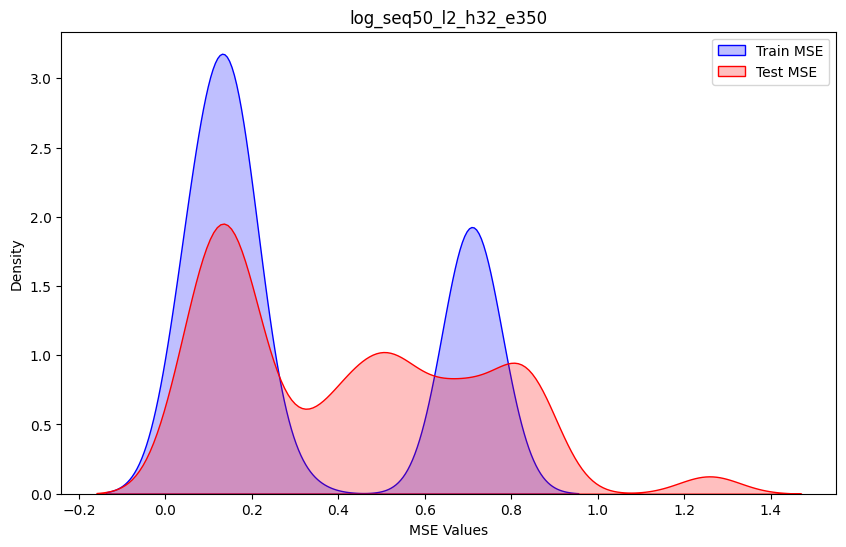

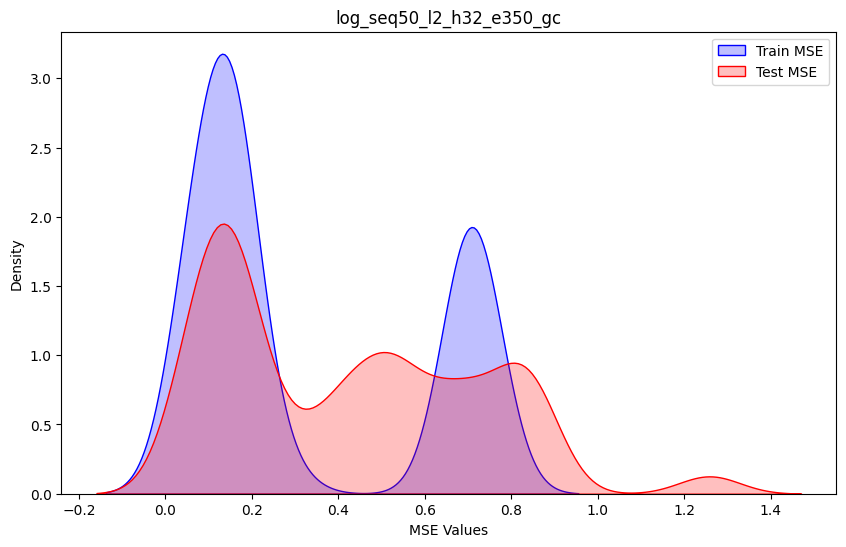

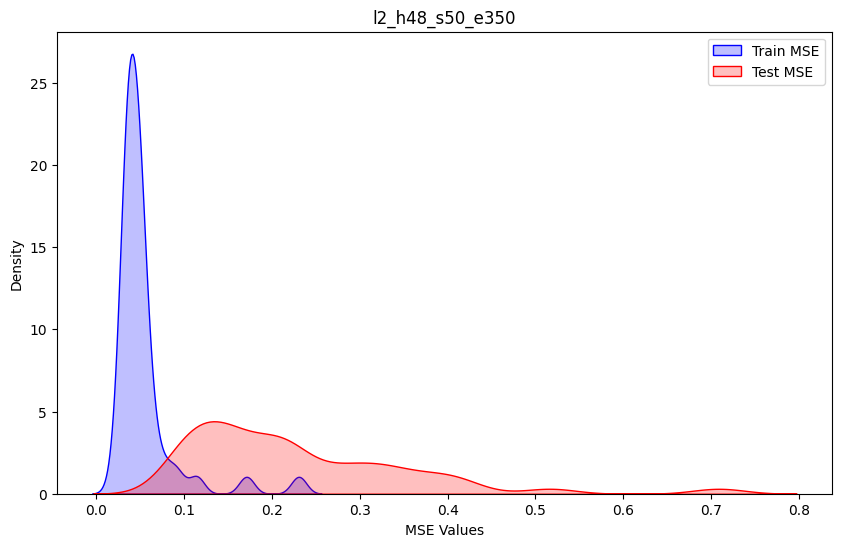

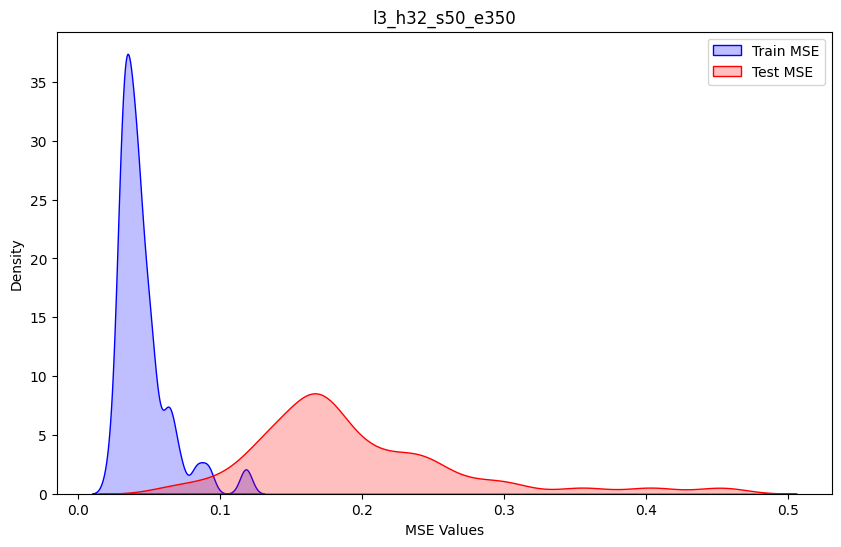

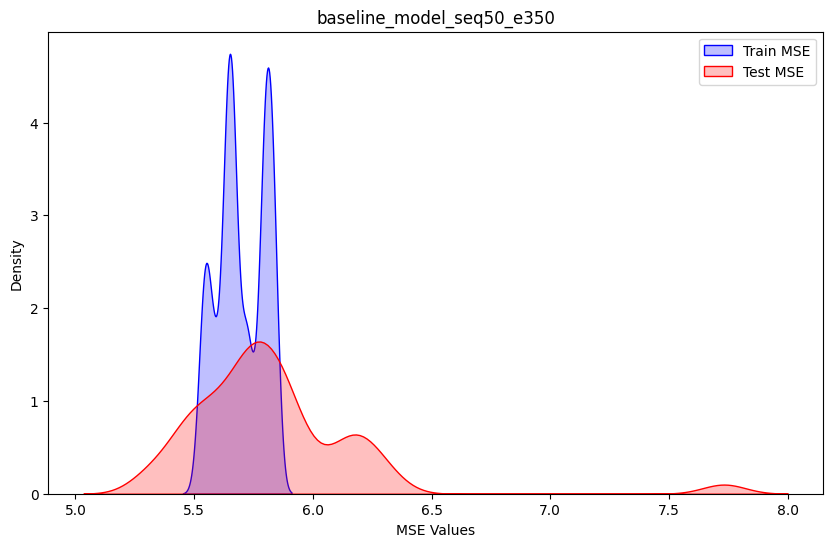

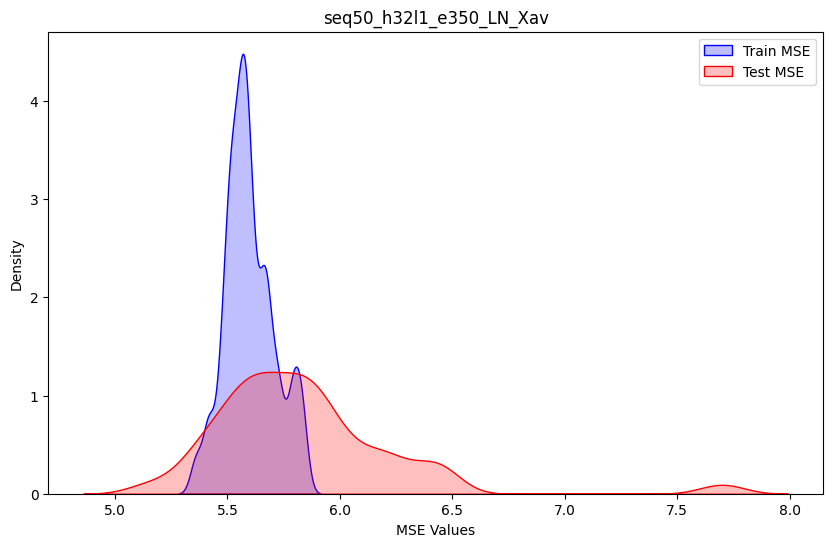

Plots saved in directory: C:/Users/kacpe/Desktop/lab_rotation_git/mse_density_plots_2


In [83]:
# Create a directory to save the plots
output_dir = 'C:/Users/kacpe/Desktop/lab_rotation_git/mse_density_plots_2'
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Number of models (half of the total number of columns since each model has 2 columns)
num_models = len(df.columns) // 2

# Loop through each model and create separate figures
for i in range(num_models):
    mse_test = df.iloc[:, 2 * i]      # Test MSE values are in even columns (0, 2, 4, ...)
    mse_train = df.iloc[:, 2 * i + 1] # Train MSE values are in odd columns (1, 3, 5, ...)
    
    # Create a new figure for each model
    plt.figure(figsize=(10, 6))
    
    # Plot training MSE
    sns.kdeplot(mse_train, label='Train MSE', color='blue', fill=True, bw_adjust=0.5)
    
    # Plot testing MSE
    sns.kdeplot(mse_test, label='Test MSE', color='red', fill=True, bw_adjust=0.5)
    
    # Set plot limits and labels
    #plt.xlim(0.1, 1.0)  # Adjust based on your MSE value range
    plt.title(model_names[i])
    plt.xlabel('MSE Values')
    plt.ylabel('Density')
    plt.legend(loc='upper right')
    
    # Save each individual plot
    plot_filename = os.path.join(output_dir, f'mse_density_{model_names[i].replace(" ", "_")}.png')
    plt.savefig(plot_filename, bbox_inches='tight')
    plt.show()
      # Save the plot
    plt.close()  # Close the figure to avoid displaying it

print(f"Plots saved in directory: {output_dir}")

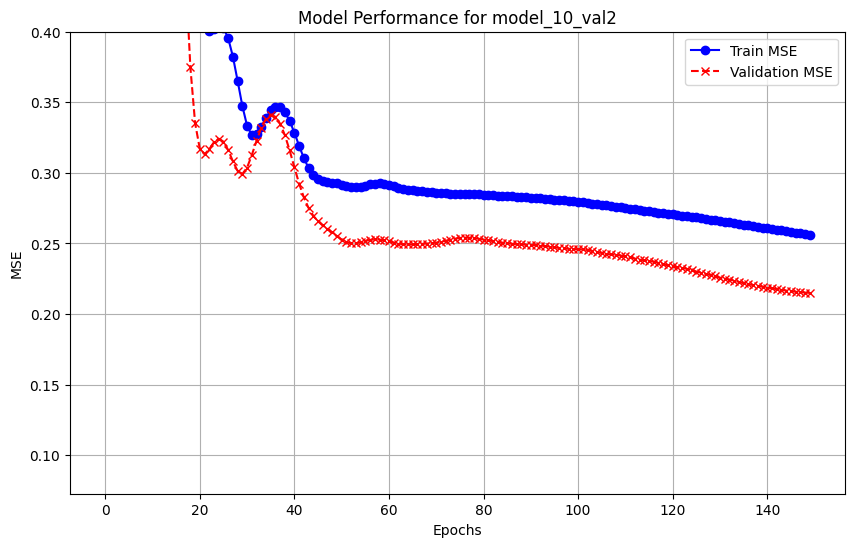

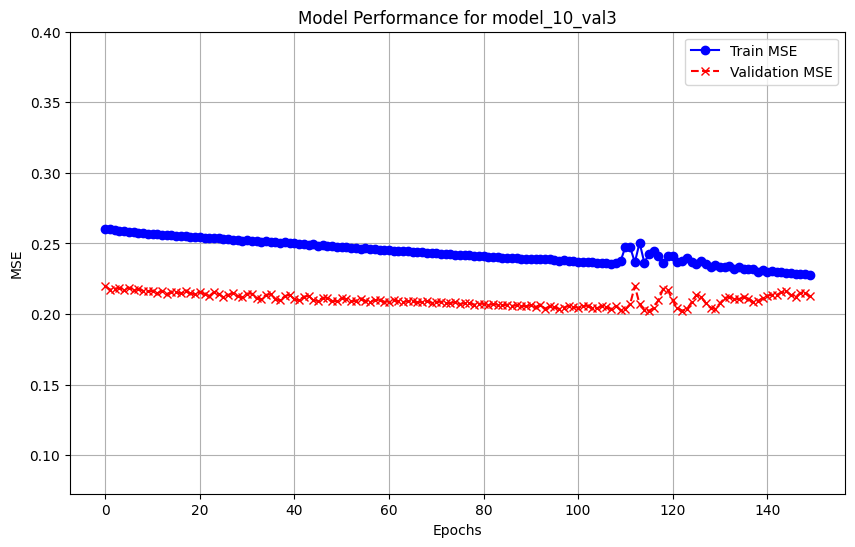

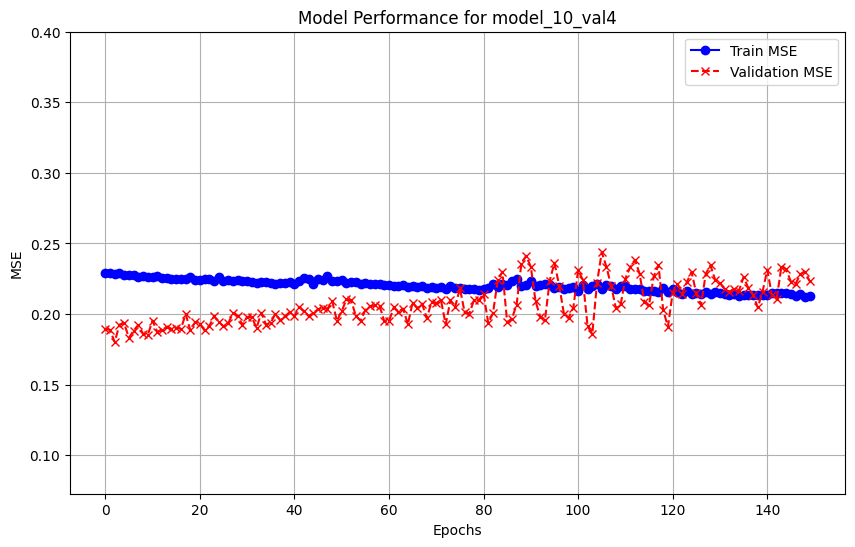

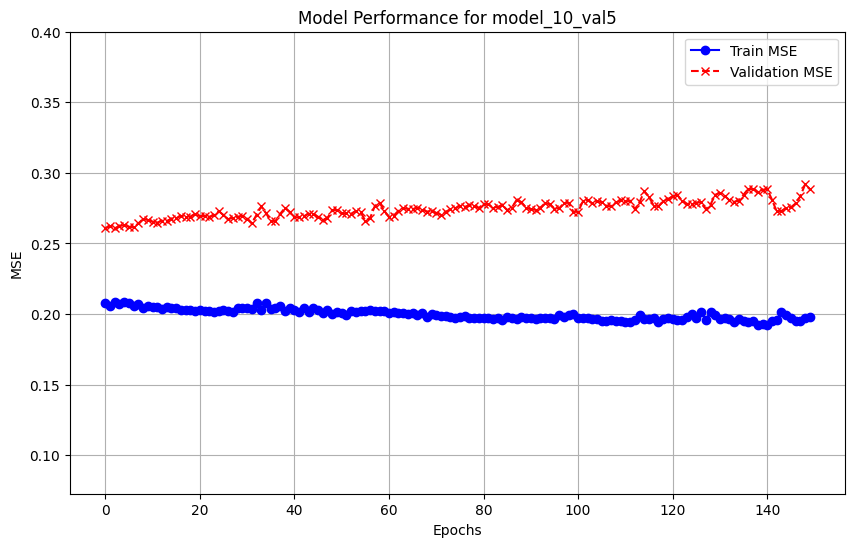

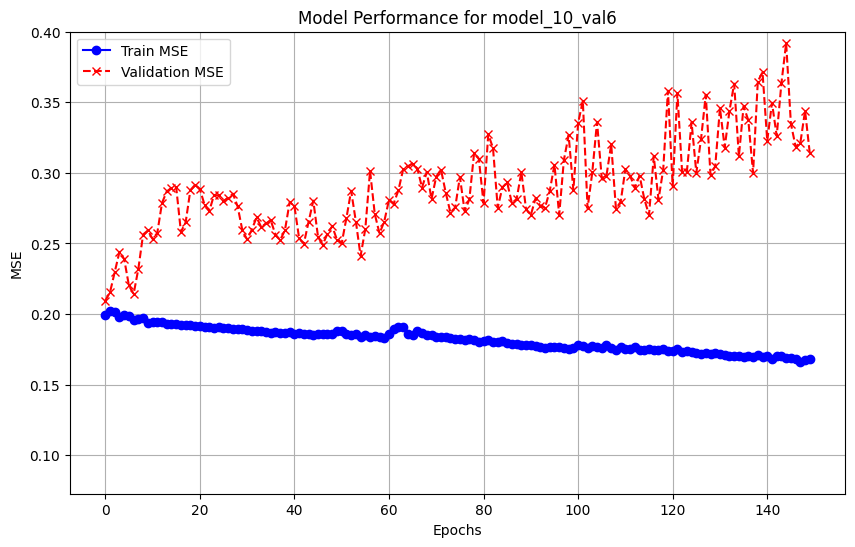

...

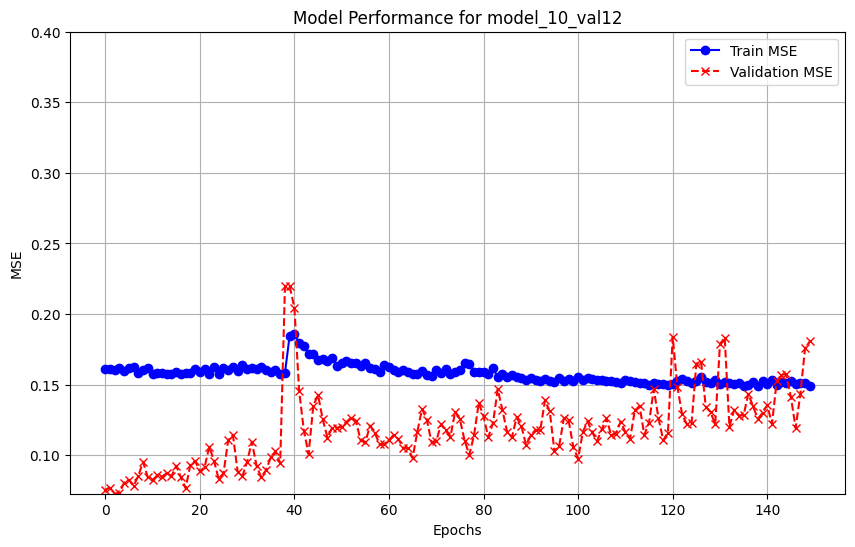

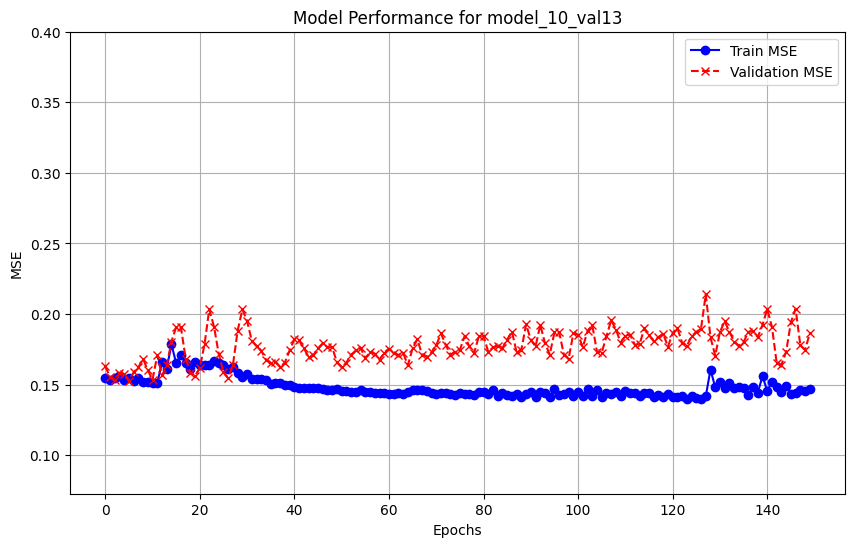

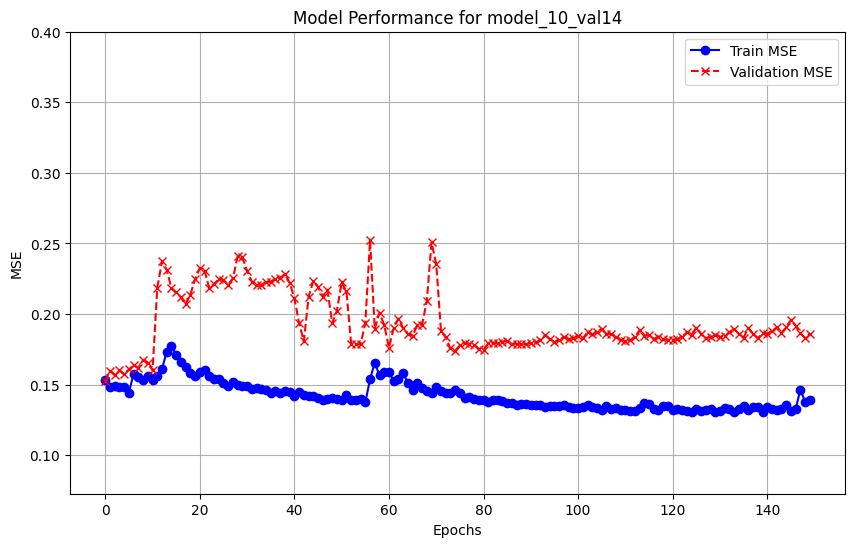

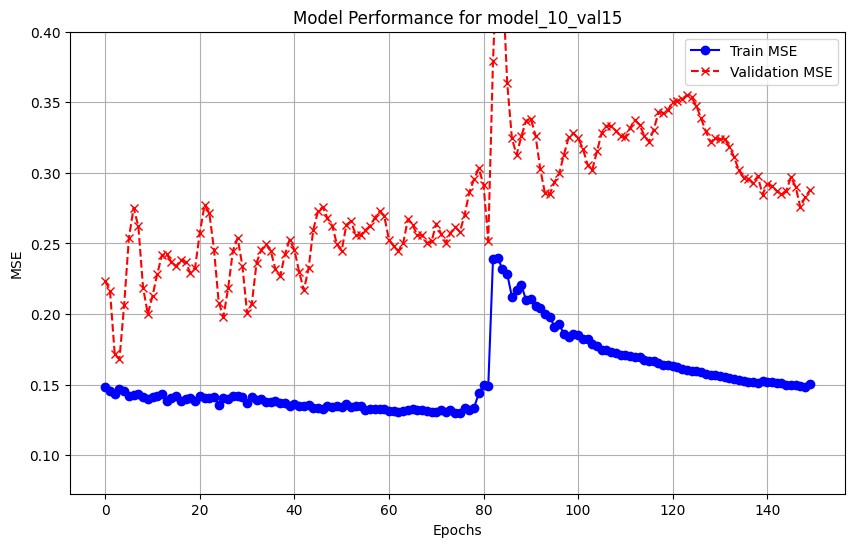

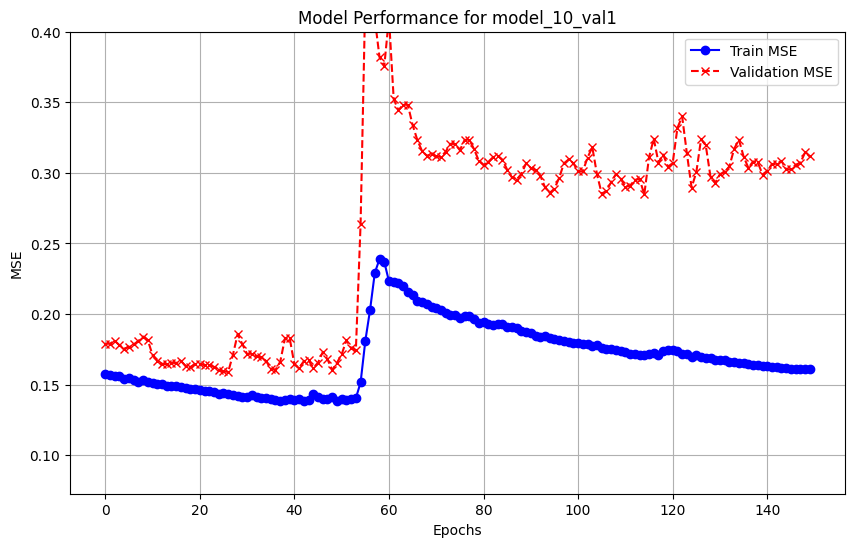

Plots saved in C:/Users/kacpe/Desktop/MSE_Plots


In [157]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Load the data
mse_train = pd.read_csv('C:/Users/kacpe/Desktop/lab_rotation_git/simple_model/MSE_train.csv')  # Replace with your actual path if needed
mse_val = pd.read_csv('C:/Users/kacpe/Desktop/lab_rotation_git/simple_model/MSE_val.csv')       # Replace with your actual path if needed

# Define the output directory for saving plots
output_dir = 'C:/Users/kacpe/Desktop/MSE_Plots'  # Change this to your actual path
os.makedirs(output_dir, exist_ok=True)

# Determine global y-axis limits for the plots
min_mse = min(mse_train.min().min(), mse_val.min().min())
max_mse = max(mse_train.max().max(), mse_val.max().max())

# Iterate through the columns (models) in the DataFrames
for model in mse_train.columns:
    plt.figure(figsize=(10, 6))

    # Plot MSE for training and validation
    plt.plot(mse_train.index, mse_train[model], label='Train MSE', color='blue', linestyle='-', marker='o')
    plt.plot(mse_val.index, mse_val[model], label='Validation MSE', color='red', linestyle='--', marker='x')

    # Customize the plot
    plt.title(f'Model Performance for {model}')
    plt.xlabel('Epochs')
    plt.ylabel('MSE')
    plt.ylim(min_mse, 0.4)  # Set the same y-axis limits for all plots
    plt.legend()
    plt.grid(True)

    # Save the plot
    
    plt.savefig(os.path.join(output_dir, f'{model}_performance_plot.png'))
    plt.show()
    plt.close()  # Close the plot to free memory

print(f"Plots saved in {output_dir}")

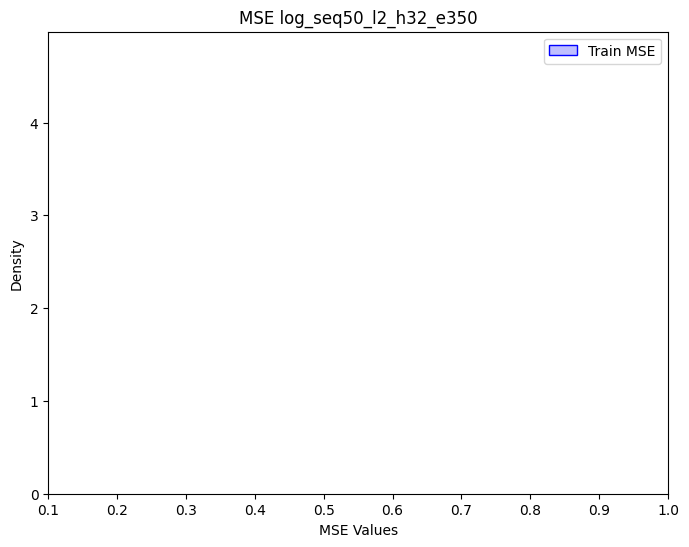

In [74]:
import matplotlib.pyplot as plt
import seaborn as sns

mse_train = df['baseline_model_seq50_e350_train']
mse_test = df['base_h32l1_seq50_e350_test']
# Set the figure size for clarity
plt.figure(figsize=(8, 6))

# Create KDE density plots
sns.kdeplot(mse_train, label='Train MSE', color='blue', fill=True, bw_adjust=0.5)
#sns.kdeplot(mse_test, label='Test MSE', color='red', fill=True, bw_adjust=0.5)

# Set x-axis limits (bins) from 0.1 to 1.0
plt.xlim(0.1, 1.0)

# Add labels and title
plt.xlabel('MSE Values')
plt.ylabel('Density')
plt.title('MSE log_seq50_l2_h32_e350')

# Display legend
plt.legend(loc='upper right')

# Show plot
plt.show()

# Proper Data Loader for different length sequences


In [ ]:
class TrialsDataset(Dataset):
    def __init__(self, trials):
        self.trials = trials
    
    def __len__(self):
        return len(self.trials)
    
    def __getitem__(self, idx):
        return self.trials[idx], self.trials[idx].size(0)  # Return trial and its length

# Function to create loaders
def create_dataloaders(trials, val_idx, test_idx):
    # Train: all trials except val and test
    train_trials = [trial for i, trial in enumerate(trials) if i != val_idx and i != test_idx]
    
    # Validation: select the trial at val_idx
    val_trial = trials[val_idx]
    
    # Test: select the trial at test_idx
    test_trial = trials[test_idx]
    
    # Create loaders
    train_loader = DataLoader(train_trials, batch_size=1, shuffle=True)
    val_loader = DataLoader([val_trial], batch_size=1)
    test_loader = DataLoader([test_trial], batch_size=1)
    
    return train_loader, val_loader, test_loader

# training loop 

In [ ]:
columns_to_drop = ['lKnee_x','lKnee_y','lKnee_z','lAnkle_x','lAnkle_y','lAnkle_z','rKnee_x','rKnee_y','rKnee_z','rAnkle_x','rAnkle_y','rAnkle_z']
data = "data_m_trials.csv"
# Read the CSV file
df = pd.read_csv(data)
df = df.drop(columns=columns_to_drop)
labels = ['s_1','s_2','s_3','s_4']
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]
cols_to_omit = ['trial']
columns_to_shift = ['s_1','s_2','s_3','s_4']
columns_to_shift

In [ ]:
# Hyperparameters
input_dim = 4
hidden_dim = 4
output_dim = 4
num_layers = 1
n_epochs =100
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.BCELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

In [ ]:
model_probabilities_s = {}

for j in np.arange(1,25):
    for i in np.arange(10,101,step=10):
        shift = i
        set_values = j
        model_name = 's_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in scaled_df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = scaled_df[scaled_df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        selected_columns = ['trial', 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, train_accs, val_losses, val_accs, train_predicted_labels, train_probs_final = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        state_dict = model.state_dict()

        # Specify the folder path and the model filename
        folder_path = os.path.join(current_dir, 'models')
        dir_name = "model_s_" + current_datetime
        folder_path = os.path.join(folder_path, dir_name)

        try:
            # Check if the directory exists, if not, create it
            if not os.path.exists(folder_path):
                os.makedirs(folder_path)

            # Combine the folder path and model filename
            model_filename = model_name + '.pth'
            full_model = os.path.join(folder_path, model_filename)

            # Save the model to the specified folder
            #torch.save(state_dict, full_model)
            print("Model saved successfully at:", full_model)
        except Exception as e:
            print("An error occurred:", e)

            # Evaluate the model on the test set and store the probabilities
        accs, train_probs = evaluate_model(model, train_dataloader, y_train)

        # Save the probabilities to the dictionary
        model_probabilities_s[model_name] = train_probs  
        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 's_results_train_' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")
            
        accs, test_probs = evaluate_model(model, test_dataloader, y_test)

        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 's_results_test' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")

In [ ]:
current_dir

In [ ]:
columns_to_drop = ['lKnee_x','lKnee_y','lKnee_z','lAnkle_x','lAnkle_y','lAnkle_z','rKnee_x','rKnee_y','rKnee_z','rAnkle_x','rAnkle_y','rAnkle_z']
file = "data_m_trials.csv"
# Read the CSV file

df = pd.read_csv(file)
df = df.drop(columns=columns_to_drop)
labels = ['s_1','s_2','s_3','s_4']
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial']] = df[['trial']]
cols_to_omit = ['trial']
columns_to_shift = scaled_df.drop(cols_to_omit, axis=1).columns
columns_to_shift

In [ ]:
scaled_df.columns

In [ ]:
# Hyperparameters
input_dim = 46
hidden_dim = 34
output_dim = 4
num_layers = 1
n_epochs =50
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

# Define loss function and optimizer
loss_fn = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=10, verbose=True, threshold=0.01, threshold_mode='rel')

In [ ]:
model_probabilities_sm = {}
for j in np.arange(1,25):
    for i in np.arange(10,101,step=20):
        shift = i
        set_values = j
        model_name = 's_m'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in scaled_df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = scaled_df[scaled_df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        selected_columns = ['trial','nose_x_minus_'+str(shift), 'nose_y_minus_'+str(shift),
        'nose_z_minus_'+str(shift), 'headTop_x_minus_'+str(shift), 'headTop_y_minus_'+str(shift),
        'headTop_z_minus_'+str(shift), 'neck_x_minus_'+str(shift), 'neck_y_minus_'+str(shift),
        'neck_z_minus_'+str(shift), 'tailBase_x_minus_'+str(shift), 'tailBase_y_minus_'+str(shift),
        'tailBase_z_minus_'+str(shift), 'lEar_x_minus_'+str(shift), 'lEar_y_minus_'+str(shift),
        'lEar_z_minus_'+str(shift), 'lShoulder_x_minus_'+str(shift), 'lShoulder_y_minus_'+str(shift),
        'lShoulder_z_minus_'+str(shift), 'lElbow_x_minus_'+str(shift), 'lElbow_y_minus_'+str(shift),
        'lElbow_z_minus_'+str(shift), 'lWrist_x_minus_'+str(shift), 'lWrist_y_minus_'+str(shift),
        'lWrist_z_minus_'+str(shift), 'lHip_x_minus_'+str(shift), 'lHip_y_minus_'+str(shift),
        'lHip_z_minus_'+str(shift), 'rEar_x_minus_'+str(shift), 'rEar_y_minus_'+str(shift), 'rEar_z_minus_'+str(shift),
        'rShoulder_x_minus_'+str(shift), 'rShoulder_y_minus_'+str(shift), 'rShoulder_z_minus_'+str(shift),
        'rElbow_x_minus_'+str(shift), 'rElbow_y_minus_'+str(shift), 'rElbow_z_minus_'+str(shift),
        'rWrist_x_minus_'+str(shift), 'rWrist_y_minus_'+str(shift), 'rWrist_z_minus_'+str(shift),
        'rHip_x_minus_'+str(shift), 'rHip_y_minus_'+str(shift), 'rHip_z_minus_'+str(shift), 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, train_accs, val_losses, val_accs, train_predicted_labels, train_probs_final = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)


        state_dict = model.state_dict()

        # Specify the folder path and the model filename
        folder_path = os.path.join(current_dir, 'models')
        dir_name = "model_sm_" + current_datetime
        folder_path = os.path.join(folder_path, dir_name)

        try:
            # Check if the directory exists, if not, create it
            if not os.path.exists(folder_path):
                os.makedirs(folder_path)

            # Combine the folder path and model filename
            model_filename = model_name + '.pth'
            full_model = os.path.join(folder_path, model_filename)

            # Save the model to the specified folder
            torch.save(state_dict, full_model)
            print("Model saved successfully at:", full_model)
        except Exception as e:
            print("An error occurred:", e)



                # Evaluate the model on the test set and store the probabilities
        accs, test_probs = evaluate_model(model, test_dataloader, y_test)

        # Save the probabilities to the dictionary
        model_probabilities_sm[model_name] = test_probs
        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 'sm_results_train_' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")
            
        accs, train_probs = evaluate_model(model, train_dataloader, y_train)

        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 'sm_results_test_' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")

In [ ]:
columns_to_drop = ['lKnee_x','lKnee_y','lKnee_z','lAnkle_x','lAnkle_y','lAnkle_z','rKnee_x','rKnee_y','rKnee_z','rAnkle_x','rAnkle_y','rAnkle_z']

df_human = pd.read_csv("data_h_trials.csv")
df_human = df_human.drop(columns=['s_1','s_2','s_3','s_4','trial'])
data = "data_m_trials.csv"
# Read the CSV file
df = pd.read_csv(data)
# List of column names to drop

df = df.drop(columns=columns_to_drop)
# Concatenate the two dataframes vertically (along rows)
df = pd.concat([df_human,df], axis=1)

# Reset the index of the concatenated dataframe
df.reset_index(drop=True, inplace=True)

labels = ['s_1','s_2','s_3','s_4']
data_to_scale = df.drop(columns=['trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
print(df.columns)

print(df[['trial']])
print(df.columns)
#df = df.drop(columns=['trial'])
scaled_df[['trial']] = df[['trial']]
scaled_df = scaled_df.dropna(axis=0)
cols_to_omit = ['trial']
# Use the drop method to exclude columns
columns_to_shift = scaled_df.drop(cols_to_omit, axis=1).columns
columns_to_shift

In [ ]:
# Hyperparameters
input_dim = 79
hidden_dim = 46
output_dim = 4
num_layers = 1
n_epochs =50
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.BCELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=5, verbose=True, threshold=0.01, threshold_mode='rel')

In [ ]:
scaled_df.columns

In [ ]:
model_probabilities_smh = {}
for j in np.arange(1,25):
    for i in np.arange(10,101,step=20):
        shift = i
        set_values = j
        model_name = 's_m_h'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in scaled_df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = scaled_df[scaled_df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
      
        selected_columns = ['trial','nose_x_minus_'+str(shift), 'nose_y_minus_'+str(shift),
        'nose_z_minus_'+str(shift), 'headTop_x_minus_'+str(shift), 'headTop_y_minus_'+str(shift),
        'headTop_z_minus_'+str(shift), 'neck_x_minus_'+str(shift), 'neck_y_minus_'+str(shift),
        'neck_z_minus_'+str(shift), 'tailBase_x_minus_'+str(shift), 'tailBase_y_minus_'+str(shift),
        'tailBase_z_minus_'+str(shift), 'lEar_x_minus_'+str(shift), 'lEar_y_minus_'+str(shift),
        'lEar_z_minus_'+str(shift), 'lShoulder_x_minus_'+str(shift), 'lShoulder_y_minus_'+str(shift),
        'lShoulder_z_minus_'+str(shift), 'lElbow_x_minus_'+str(shift), 'lElbow_y_minus_'+str(shift),
        'lElbow_z_minus_'+str(shift), 'lWrist_x_minus_'+str(shift), 'lWrist_y_minus_'+str(shift),
        'lWrist_z_minus_'+str(shift), 'lHip_x_minus_'+str(shift), 'lHip_y_minus_'+str(shift),
        'lHip_z_minus_'+str(shift), 'rEar_x_minus_'+str(shift), 'rEar_y_minus_'+str(shift), 'rEar_z_minus_'+str(shift),
        'rShoulder_x_minus_'+str(shift), 'rShoulder_y_minus_'+str(shift), 'rShoulder_z_minus_'+str(shift),
        'rElbow_x_minus_'+str(shift), 'rElbow_y_minus_'+str(shift), 'rElbow_z_minus_'+str(shift),
        'rWrist_x_minus_'+str(shift), 'rWrist_y_minus_'+str(shift), 'rWrist_z_minus_'+str(shift),
        'rHip_x_minus_'+str(shift), 'rHip_y_minus_'+str(shift), 'rHip_z_minus_'+str(shift), 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4','H_headTop_x_minus_'+str(shift), 'H_headTop_y_minus_'+str(shift), 'H_headTop_z_minus_'+str(shift), 
        'H_neck_x_minus_'+str(shift), 'H_neck_y_minus_'+str(shift),
       'H_neck_z_minus_'+str(shift), 'H_tailBase_x_minus_'+str(shift), 'H_tailBase_y_minus_'+str(shift), 'H_tailBase_z_minus_'+str(shift), 'H_lEar_x_minus_'+str(shift),
       'H_lEar_y_minus_'+str(shift), 'H_lEar_z_minus_'+str(shift), 'H_lShoulder_x_minus_'+str(shift), 'H_lShoulder_y_minus_'+str(shift),
       'H_lShoulder_z_minus_'+str(shift), 'H_lElbow_x_minus_'+str(shift), 'H_lElbow_y_minus_'+str(shift), 'H_lElbow_z_minus_'+str(shift), 'H_lWrist_x_minus_'+str(shift),
       'H_lWrist_y_minus_'+str(shift), 'H_lWrist_z_minus_'+str(shift), 'H_lHip_x_minus_'+str(shift), 'H_lHip_y_minus_'+str(shift), 'H_lHip_z_minus_'+str(shift),
       'H_rEar_x_minus_'+str(shift), 'H_rEar_y_minus_'+str(shift), 'H_rEar_z_minus_'+str(shift), 'H_rShoulder_x_minus_'+str(shift), 'H_rShoulder_y_minus_'+str(shift),
       'H_rShoulder_z_minus_'+str(shift), 'H_rHip_x_minus_'+str(shift), 'H_rHip_y_minus_'+str(shift), 'H_rHip_z_minus_'+str(shift)]
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, train_accs, val_losses, val_accs, train_predicted_labels, train_probs_final = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)


        state_dict = model.state_dict()

        # Specify the folder path and the model filename
        folder_path = os.path.join(current_dir, 'models')
        dir_name = "model_smh_" + current_datetime
        folder_path = os.path.join(folder_path, dir_name)

        try:
            # Check if the directory exists, if not, create it
            if not os.path.exists(folder_path):
                os.makedirs(folder_path)

            # Combine the folder path and model filename
            model_filename = model_name + '.pth'
            full_model = os.path.join(folder_path, model_filename)

            # Save the model to the specified folder
            torch.save(state_dict, full_model)
            print("Model saved successfully at:", full_model)
        except Exception as e:
            print("An error occurred:", e)



                # Evaluate the model on the test set and store the probabilities
        accs, test_probs = evaluate_model(model, train_dataloader, y_train)
        
        
        # Save the probabilities to the dictionary
        
        
        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 'smh_results_train_' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")
            
        accs, test_probs = evaluate_model(model, test_dataloader, y_test)
        model_probabilities_smh[model_name] = test_probs

        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 'smh_results_test_' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")

In [ ]:
df_human

In [ ]:
df = pd.read_csv("data_human_jarvis_oldlabels.csv")
df.rename(columns={'H_trial': 'trial'}, inplace=True)
# List of column names to drop
labels = ['s_1','s_2','s_3','s_4']
data_to_scale = df.drop(columns=['trial','s_1','s_2','s_3','s_4'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['trial','s_1','s_2','s_3','s_4']] = df[['trial','s_1','s_2','s_3','s_4']]
scaled_df = scaled_df.dropna(axis=0)
cols_to_omit = ['trial']
# Use the drop method to exclude columns
columns_to_shift = scaled_df.drop(cols_to_omit, axis=1).columns
columns_to_shift



In [ ]:
scaled_df.trial == 24


In [ ]:
# Hyperparameters
input_dim = scaled_df.shape[1]-1
hidden_dim = 11
output_dim = 4
num_layers = 1
n_epochs =100
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

# Define loss function and optimizer
#class_weights = torch.tensor([1.8]).to(device)
loss_fn = nn.BCEWithLogitsLoss(pos_weight=None)  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.9)

In [ ]:
for j in np.arange(1,25):
    for i in np.arange(0,101,step=10):
        shift = i
        set_values = j
        model_name = 's_h'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in scaled_df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = scaled_df[scaled_df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        selected_columns = ['trial', 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4','H_headFront_x_minus_'+str(shift), 'H_headFront_y_minus_'+str(shift), 
        'H_headFront_z_minus_'+str(shift), 'H_neck_x_minus_'+str(shift),'H_neck_y_minus_'+str(shift), 'H_neck_z_minus_'+str(shift), 'H_lowerBack_x_minus_'+str(shift), 'H_lowerBack_y_minus_'+str(shift),'H_lowerBack_z_minus_'+str(shift),
        'H_leftWrist_x_minus_'+str(shift), 'H_leftWrist_y_minus_'+str(shift), 'H_leftWrist_z_minus_'+str(shift),'H_leftShoulder_x_minus_'+str(shift), 'H_leftShoulder_y_minus_'+str(shift), 'H_leftShoulder_z_minus_'+str(shift),
       'H_leftElbow_x_minus_'+str(shift), 'H_leftElbow_y_minus_'+str(shift), 'H_leftElbow_z_minus_'+str(shift)]
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        train_losses, train_accs, val_losses, val_accs, train_predicted_labels, train_probs_final = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)


        state_dict = model.state_dict()

        # Specify the folder path and the model filename
        folder_path = os.path.join(current_dir, 'models')
        dir_name = "model_sh_" + current_datetime
        folder_path = os.path.join(folder_path, dir_name)

        try:
            # Check if the directory exists, if not, create it
            if not os.path.exists(folder_path):
                os.makedirs(folder_path)

            # Combine the folder path and model filename
            model_filename = model_name + '.pth'
            full_model = os.path.join(folder_path, model_filename)

            # Save the model to the specified folder
            torch.save(state_dict, full_model)
            print("Model saved successfully at:", full_model)
        except Exception as e:
            print("An error occurred:", e)



        accs = evaluate_model(model, train_dataloader, y_train, current_datetime)
        
        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 'sh_results_train_' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")
            
        accs = evaluate_model(model, test_dataloader, y_test, current_datetime)

        # Define the directory where you want to save the file relative to current_dir
        relative_dir = "results/"

        # Create the full directory path by joining current_dir and relative_dir
        full_dir_path = os.path.join(current_dir, relative_dir)

        # Ensure that the directory exists, if not, create it
        if not os.path.exists(full_dir_path):
            os.makedirs(full_dir_path)

        # Define the file name
        file_name = 'sh_results_test_' + current_datetime + '.txt'

        # Create the full file path by joining the directory path and the file name
        file_path = os.path.join(full_dir_path, file_name)

        # Define the value you want to save
        value_to_save = model_name + ": " + str(accs)

        try:
            # Open the file in append mode (create if it doesn't exist)
            with open(file_path, "a+") as file:
                # Move the file cursor to the beginning to check if the file is empty
                file.seek(0)
                # Read the first character of the file
                first_char = file.read(1)
                # If the first character is empty (file is empty), write a new line
                if not first_char:
                    file.write('\n')
                # Write the value to the file
                file.write(value_to_save + '\n')
                print(f"Value '{value_to_save}' saved to '{file_path}' successfully.")
        except Exception as e:
            print(f"An error occurred: {e}")

# Heatmaps

In [ ]:
model_probabilities

In [ ]:
all_probs_array = model_probabilities['model_10_val11'][:,5:9]

In [ ]:
model_probabilities['model_10_val11'][:,5:9].shape

In [ ]:
labels[4:]

In [ ]:
# Define the labels for the y-axis (predicted states)
y_labels = labels[5:]

# Create a figure and axis
fig, ax = plt.subplots()

# Create the heatmap plot
heatmap = ax.imshow(all_probs_array.T, cmap='coolwarm', aspect='auto', interpolation='none')

# Add colorbar
cbar = plt.colorbar(heatmap)

# Set the axis labels and title
ax.set_xlabel('Time Step')
ax.set_ylabel('Predicted State')
ax.set_title('Probabilities of Predicting Output States')

# Set the y-axis ticks and labels
ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels)

# Show the plot

In [ ]:
all_probs_array = model_probabilities_sm['s_m10_val11']
y_val = scaled_df[scaled_df['trial'] == 11][['s_1', 's_2', 's_3', 's_4']]

In [ ]:
y_val.shape

In [ ]:
# Create a figure with a grid of subplots (2 rows, 1 column)
fig, axs = plt.subplots(2, 1, figsize=(8, 10))

# Create the heatmap plot in the first subplot
heatmap = axs[0].imshow(all_probs_array.T, cmap='coolwarm', aspect='auto', interpolation='none')
heatmap2 = axs[1].imshow(y_val.T, cmap='coolwarm', aspect='auto', interpolation='none')
# Add colorbar to the heatmap subplot
cbar = plt.colorbar(heatmap, ax=axs[0])

# Set the axis labels and title for the heatmap subplot
axs[0].set_xlabel('Time Step')
axs[0].set_ylabel('Predicted State')
axs[0].set_title('Probabilities of Predicting Output States')

# Set the y-axis ticks and labels for the heatmap subplot
axs[0].set_yticks(np.arange(len(y_labels)))
axs[0].set_yticklabels(y_labels)
# Set the y-axis ticks and labels for the heatmap subplot
axs[1].set_yticks(np.arange(len(y_labels)))
axs[1].set_yticklabels(y_labels)
""" 
# Create the second plot (line plot) in the second subplot
axs[1].plot(np.arange(len(y_val)), y_val, color='green', label='Actual Values')
axs[1].set_xlabel('Time Step')
axs[1].set_ylabel('Actual Value')
axs[1].set_title('Actual Test Values for Y')
axs[1].legend()
 """
# Adjust spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

In [ ]:
actual_values = y_val
# Define the labels for the y-axis (predicted states)
y_labels = ['1', '2', '3', '4']

# Create a figure with a grid of subplots (2 rows, 1 column)
fig, axs = plt.subplots(2,1, figsize=(8,10))

# Create the first heatmap plot in the first subplot
heatmap1 = axs[0].imshow(all_probs_array.T, cmap='coolwarm', aspect='auto', interpolation='none')

# Add colorbar to the first heatmap subplot
cbar1 = plt.colorbar(heatmap1, ax=axs[0])

# Set the axis labels and title for the first heatmap subplot
#axs[0].set_xlabel('Time Step')
#axs[0].set_ylabel('Predicted State')
axs[0].set_title('Predicted States Probabilities')

# Set the y-axis ticks and labels for the first heatmap subplot
axs[0].set_yticks(np.arange(len(y_labels)))
axs[0].set_yticklabels(y_labels)

# Create the second heatmap plot in the second subplot
heatmap2 = axs[1].imshow(actual_values.T, cmap='coolwarm', aspect='auto', interpolation='none')

# Add colorbar to the second heatmap subplot
cbar2 = plt.colorbar(heatmap2, ax=axs[1])

# Set the axis labels and title for the second heatmap subplot
axs[1].set_xlabel('Time Step')
#axs[1].set_ylabel('Predicted State')
axs[1].set_title('True States')

# Set the y-axis ticks and labels for the second heatmap subplot
axs[1].set_yticks(np.arange(len(y_labels)))
axs[1].set_yticklabels(y_labels)

# Adjust spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# gates and hidden states

In [ ]:
class GRUCellNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        self.gru = nn.GRUCell(input_dim, hidden_dim, bias=True)                
        self.fc = nn.Linear(hidden_dim, output_dim)
        self.softplus = nn.Softplus()
        self.relu = nn.ReLU()

        self.gru_cells = nn.ModuleList([
            nn.GRUCell(input_dim, hidden_dim) if i == 0 else nn.GRUCell(hidden_dim, hidden_dim)
            for i in range(num_layers)
        ])
        self.batch_norm = nn.BatchNorm1d(hidden_dim)  # Add BatchNorm outside GRU cells

        
        
    def forward(self, x, h=None, hidden_states=None):
        if h is None:
            h = torch.zeros(x.size(0), self.hidden_dim)  # Initialize hidden state for the single layer

        hidden_states = []  # Initialize a list to store hidden states at each time step

        for t in range(x.size(1)):
            input_t = x[:, t, :]
            h = self.gru(input_t, h)  # Update the hidden state for the single layer
            hidden_states.append(h)  # Append the hidden state for the current time step

        h = self.batch_norm(h)  # Apply batch normalization to the final hidden state
        out = self.fc(self.softplus(h))  # Calculate the output based on the final hidden state
        out = torch.sigmoid(out)
        out = torch.round(out)

        # Return the output and the list of hidden states for the entire sequence
        return out, h, hidden_states

In [ ]:
def train(dataloader, model, optimizer, loss_fn, scheduler=None, device=None):
    epoch_loss = []
    epoch_correct, epoch_total = 0, 0
    model = model.to(device)
    model.train()
    predicted_probs = []
    predicted_labels = []
    hidden_states = []  # Initialize a list to store hidden states

    for x, y in dataloader:
        x = x.to(device).float()
        y = y.to(device).float()
        
        optimizer.zero_grad()
        
        out, last_hidden_states, hidden_states_batch = model(x)  # Collect hidden states here
        y_prob = torch.sigmoid(out)
        # Append the predicted probabilities to the list
        predicted_probs.append(y_prob.cpu().detach().numpy())
        loss = loss_fn(out, y)
        epoch_loss.append(loss.item())
        
        hidden_states.append(hidden_states_batch)  # Append hidden states to the list
        
        y_pred = torch.round(y_prob)
        epoch_correct += sum((y == y_pred).flatten()).item()
        epoch_total += y.numel()
        
        loss.backward()
        torch_utils.clip_grad_norm_(model.parameters(), max_norm=10)
        optimizer.step()

        predicted_labels.extend(zip(y_pred.cpu().detach().cpu().numpy(), y.cpu().numpy()))
        if scheduler:
            scheduler.step()
    
    return np.mean(epoch_loss), accuracy(epoch_correct, epoch_total), predicted_labels, predicted_probs, hidden_states

In [ ]:
def validate(dataloader, model, loss_fn, device=None):
    epoch_loss = []
    epoch_correct, epoch_total = 0, 0
    model = model.to(device).float()
    model.eval()
    predicted_probs = []
    predicted_labels = []
    hidden_states = []  # Initialize a list to store hidden states

    with torch.no_grad():
        for x, y in dataloader:
            x = x.to(device).float()
            y = y.to(device).float()
            
            out, last_hidden_states, hidden_states_batch = model(x)  # Collect hidden states here
            
            loss = loss_fn(out, y)
            epoch_loss.append(loss.item())
            
            hidden_states.append(hidden_states_batch)  # Append hidden states to the list
            
            y_pred = torch.sigmoid(out)
            predicted_probs.append(y_pred.cpu().detach().numpy())
            y_pred = torch.round(y_pred)
            epoch_correct += sum((y == y_pred).flatten())
            epoch_total += y.numel()
            predicted_labels.extend(zip(y_pred.cpu().numpy(), y.cpu().numpy()))
    
    return np.mean(epoch_loss), accuracy(epoch_correct, epoch_total), predicted_labels, predicted_probs, hidden_states

In [ ]:
def run_training(train_dataloader, val_dataloader, model, optimizer, loss_fn, num_epochs, scheduler=None, device=None, schedule_on_train=True, verbose=True):
    train_losses, train_accs = [], []
    val_losses, val_accs = [], []

    train_hidden_states, val_hidden_states = [], [] # Initialize lists to store hidden states
    
    for epoch in range(num_epochs):
        epoch_train_loss, epoch_train_acc, train_preds, train_probs, train_hidden = train(train_dataloader, model, optimizer, loss_fn, scheduler, device)
        
        train_losses.append(epoch_train_loss)
        train_accs.append(epoch_train_acc)

        train_hidden_states.extend(train_hidden)  # Append hidden states to the list
        
        if val_dataloader is not None:
            epoch_val_loss, epoch_val_acc, val_preds, val_probs, val_hidden = validate(val_dataloader, model, loss_fn, device)
        
            val_losses.append(epoch_val_loss)
            val_accs.append(epoch_val_acc)

            val_hidden_states.extend(val_hidden)  # Append hidden states to the list
        
        if isinstance(scheduler, ReduceLROnPlateau):
            scheduler.step(epoch_train_acc if schedule_on_train or val_dataloader is None else epoch_val_acc)
            
        if epoch % 50 == 0:
            val_str = f", val loss: {epoch_val_loss}, val acc: {epoch_val_acc}" if val_dataloader is not None else ""
            print(f"Epoch {epoch}, train loss: {epoch_train_loss}, train acc: {epoch_train_acc}{val_str}")
        if epoch == num_epochs - 1:  # Store values only for the final epoch
            train_predicted_labels = train_preds
            #val_predicted_labels = val_preds
            train_probs_final = train_probs
            #val_probs_final = val_probs
            if val_dataloader is not None:
                val_predicted_labels = val_preds
                val_probs_final = val_probs

    if val_dataloader is not None:        
        return train_losses, train_accs, val_losses, val_accs, train_predicted_labels, val_predicted_labels, train_probs_final, val_probs_final, train_hidden_states, val_hidden_states
    else: 
        return train_losses, train_accs, train_predicted_labels, train_probs_final, train_hidden_states

In [ ]:
columns_to_drop = ['lKnee_x','lKnee_y','lKnee_z','lAnkle_x','lAnkle_y','lAnkle_z','rKnee_x','rKnee_y','rKnee_z','rAnkle_x','rAnkle_y','rAnkle_z']
file = path + "data_model_v3.csv"
df = pd.read_csv(file)
df = df.drop(columns=columns_to_drop)
labels = ['s_1','s_2','s_3','s_4']
data_to_scale = df.drop(columns=['id', 'trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['id', 'trial']] = df[['id', 'trial']]
cols_to_omit = ['id','trial']
columns_to_shift = scaled_df.drop(cols_to_omit, axis=1).columns
columns_to_shift

In [ ]:
for x, y in train_dataloader:
        x = x.to(device).float()
        y = y.to(device).float()
        
        optimizer.zero_grad()
        
        out, last_hidden_states, batch_hidden_states = model(x)

In [ ]:
batch_hidden_states[0][0]

In [ ]:
print(batch_hidden_states[0][0].shape)

In [ ]:
hidden_states_array = batch_hidden_states[0][0].detach().numpy()
hidden_states_array = hidden_states_array.T 

In [ ]:
hidden_states_array.shape

In [ ]:
# Create a figure with a single subplot
fig, axs = plt.subplots(1, 1, figsize=(14,6))  # Adjust the figsize as needed

# Create the heatmap plot in the single subplot
heatmap = axs.imshow(hidden_states_array, cmap='coolwarm', aspect='auto', interpolation='none')

# Add colorbar to the heatmap subplot
cbar = plt.colorbar(heatmap, ax=axs)

# Set the axis labels and title for the heatmap subplot
axs.set_ylabel('hidden unit')
axs.set_xlabel('time step')
axs.set_title('Heatmap of hidden states')

# Adjust spacing between the subplot
plt.tight_layout()

# Show the plot
plt.show()

In [ ]:
scaled_df.shape[1]-2

In [ ]:
# Hyperparameters
input_dim = scaled_df.shape[1]-2
hidden_dim = 34
output_dim = 4
num_layers = 1
n_epochs =100
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

# Define loss function and optimizer
class_weights = torch.tensor([1.8]).to(device)
loss_fn = nn.BCEWithLogitsLoss(pos_weight=class_weights)  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.9)

In [ ]:
shift_values = np.array([10,80,130])

In [ ]:
#hidden_states_all = []
hidden_states_dict = {}
for j in np.arange(1,16):
    for i in shift_values:
        shift = i
        set_values = j
        model_name = 's_m'+str(shift)+'_'+'val'+str(set_values)+'_gates'


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in scaled_df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = scaled_df[scaled_df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        selected_columns = ['id', 'trial','nose_x_minus_'+str(shift), 'nose_y_minus_'+str(shift),
        'nose_z_minus_'+str(shift), 'headTop_x_minus_'+str(shift), 'headTop_y_minus_'+str(shift),
        'headTop_z_minus_'+str(shift), 'neck_x_minus_'+str(shift), 'neck_y_minus_'+str(shift),
        'neck_z_minus_'+str(shift), 'tailBase_x_minus_'+str(shift), 'tailBase_y_minus_'+str(shift),
        'tailBase_z_minus_'+str(shift), 'lEar_x_minus_'+str(shift), 'lEar_y_minus_'+str(shift),
        'lEar_z_minus_'+str(shift), 'lShoulder_x_minus_'+str(shift), 'lShoulder_y_minus_'+str(shift),
        'lShoulder_z_minus_'+str(shift), 'lElbow_x_minus_'+str(shift), 'lElbow_y_minus_'+str(shift),
        'lElbow_z_minus_'+str(shift), 'lWrist_x_minus_'+str(shift), 'lWrist_y_minus_'+str(shift),
        'lWrist_z_minus_'+str(shift), 'lHip_x_minus_'+str(shift), 'lHip_y_minus_'+str(shift),
        'lHip_z_minus_'+str(shift), 'rEar_x_minus_'+str(shift), 'rEar_y_minus_'+str(shift), 'rEar_z_minus_'+str(shift),
        'rShoulder_x_minus_'+str(shift), 'rShoulder_y_minus_'+str(shift), 'rShoulder_z_minus_'+str(shift),
        'rElbow_x_minus_'+str(shift), 'rElbow_y_minus_'+str(shift), 'rElbow_z_minus_'+str(shift),
        'rWrist_x_minus_'+str(shift), 'rWrist_y_minus_'+str(shift), 'rWrist_z_minus_'+str(shift),
        'rHip_x_minus_'+str(shift), 'rHip_y_minus_'+str(shift), 'rHip_z_minus_'+str(shift), 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        shifted_df = shifted_df[selected_columns]
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['id', 'trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['id', 'trial'])
        full_set = shifted_df.drop(columns=['id','trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)
        #print(X_train.shape[0])
        

        train_losses, train_accs, train_predicted_labels, train_probs_final, train_hidden_states = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        
        #hidden_states_dict[(shift, set_values)] = train_hidden_states
        
        all_preds = []
        all_probs = []
        hidden_states = []

        # Iterate through the test data batches
        for inputs, _ in train_dataloader:
            inputs = inputs.float()
            # Forward pass to get predictions
            with torch.no_grad():
                predictions, h, test_hidden_states = model(inputs)
                probabilities = torch.sigmoid(predictions)
                preds = torch.round(probabilities)

            # Append predictions to the list
            all_preds.append(preds)
            all_probs.append(probabilities)
            hidden_states.append(test_hidden_states)
        
        #print(hidden_states[0][0])    
        hidden_states_array = hidden_states[0][0].detach().numpy()
        hidden_states_array = hidden_states_array.T
        #print(hidden_states_array.shape) 
        
        # Concatenate the predicted batches
        all_preds = torch.cat(all_preds, dim=0)
        all_probs = torch.cat(all_probs, dim=0)

        all_preds_array = all_preds.numpy()
        all_probs_array = all_probs.numpy()


        columns = ['s_1','s_2','s_3','s_4']
        all_probs_df = pd.DataFrame(all_probs_array)
        all_probs_df.columns = columns
        # Convert the tensor of predictions to a DataFrame
        predictions_df = pd.DataFrame(all_preds_array, columns=y_train.columns, index=y_train.index)
        # Calculate accuracy for each output state
        
        # Create a figure with a single subplot
        fig, axs = plt.subplots(2, 1, figsize=(16,10))  # Adjust the figsize as needed

        # Create the heatmap plot in the single subplot
        heatmap = axs[0].imshow(hidden_states_array, cmap='seismic', aspect='auto', interpolation='none')

        # Add colorbar to the heatmap subplot
        #cbar = plt.colorbar(heatmap, ax=axs)

        # Set the axis labels and title for the heatmap subplot
        axs[0].set_ylabel('hidden unit')
        axs[0].set_xlabel('time step')
        axs[0].set_title('Heatmap of hidden states for s='+str(i)+' trial='+str(j))
        
        axs[1].imshow(all_probs_array.T, cmap='seismic', aspect='auto', interpolation='none')
        y_labels = ['1', '2', '3', '4']
        axs[1].set_yticks(np.arange(len(y_labels)))
        axs[1].set_yticklabels(y_labels)
        
        # Add colorbar to the heatmap subplot
        #cbar = plt.colorbar(heatmap, ax=axs)
        plot_title = 'solo_s'+str(i)+'_val'+str(j)
        #plt.title(plot_title)
        # Set the axis labels and title for the heatmap subplot
        axs[0].set_ylabel('predictions')
        axs[0].set_xlabel('time step')
        #axs[0].set_title()
        # Adjust spacing between the subplot
        plt.tight_layout()
        # Show the plot
        # Specify the file path
        # Specify the directory where you want to save the plots
        save_directory = r'C:\Users\kacpe\Desktop\study\research lab\lab_rotation_git\hidden_states_heatmaps_train'

        # Create the directory if it doesn't exist
        os.makedirs(save_directory, exist_ok=True)

        # Define the plot title
        plot_title = f'solo_s{i}_val{j}'

        # Specify the file path using os.path.join
        file_path = os.path.join(save_directory, f'{plot_title}.png')

        # Save the plot to the specified path
        fig.savefig(file_path)
        #plt.show()
        plt.close()
                
        
       
    
    

In [ ]:
# Hyperparameters
input_dim = scaled_df.shape[1]-2
hidden_dim = 34
output_dim = 4
num_layers = 1
n_epochs =100
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

# Define loss function and optimizer
class_weights = torch.tensor([1.8]).to(device)
loss_fn = nn.BCEWithLogitsLoss(pos_weight=class_weights)  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.9)

In [ ]:
#hidden_states_all = []
hidden_states_dict = {}
for j in np.arange(13,15):
    for i in shift_values:
        shift = i
        set_values = j
        model_name = 's_m'+str(shift)+'_'+'val'+str(set_values)+'_gates'


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in scaled_df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = scaled_df[scaled_df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        selected_columns = ['id', 'trial','nose_x_minus_'+str(shift), 'nose_y_minus_'+str(shift),
        'nose_z_minus_'+str(shift), 'headTop_x_minus_'+str(shift), 'headTop_y_minus_'+str(shift),
        'headTop_z_minus_'+str(shift), 'neck_x_minus_'+str(shift), 'neck_y_minus_'+str(shift),
        'neck_z_minus_'+str(shift), 'tailBase_x_minus_'+str(shift), 'tailBase_y_minus_'+str(shift),
        'tailBase_z_minus_'+str(shift), 'lEar_x_minus_'+str(shift), 'lEar_y_minus_'+str(shift),
        'lEar_z_minus_'+str(shift), 'lShoulder_x_minus_'+str(shift), 'lShoulder_y_minus_'+str(shift),
        'lShoulder_z_minus_'+str(shift), 'lElbow_x_minus_'+str(shift), 'lElbow_y_minus_'+str(shift),
        'lElbow_z_minus_'+str(shift), 'lWrist_x_minus_'+str(shift), 'lWrist_y_minus_'+str(shift),
        'lWrist_z_minus_'+str(shift), 'lHip_x_minus_'+str(shift), 'lHip_y_minus_'+str(shift),
        'lHip_z_minus_'+str(shift), 'rEar_x_minus_'+str(shift), 'rEar_y_minus_'+str(shift), 'rEar_z_minus_'+str(shift),
        'rShoulder_x_minus_'+str(shift), 'rShoulder_y_minus_'+str(shift), 'rShoulder_z_minus_'+str(shift),
        'rElbow_x_minus_'+str(shift), 'rElbow_y_minus_'+str(shift), 'rElbow_z_minus_'+str(shift),
        'rWrist_x_minus_'+str(shift), 'rWrist_y_minus_'+str(shift), 'rWrist_z_minus_'+str(shift),
        'rHip_x_minus_'+str(shift), 'rHip_y_minus_'+str(shift), 'rHip_z_minus_'+str(shift), 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        shifted_df = shifted_df[selected_columns]
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['id', 'trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['id', 'trial'])
        full_set = shifted_df.drop(columns=['id','trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)
        #print(X_train.shape[0])
        

        train_losses, train_accs, train_predicted_labels, train_probs_final, train_hidden_states = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        
        #hidden_states_dict[(shift, set_values)] = train_hidden_states
        
        all_preds = []
        all_probs = []
        hidden_states = []

        # Iterate through the test data batches
        for inputs, _ in test_dataloader:
            inputs = inputs.float()
            # Forward pass to get predictions
            with torch.no_grad():
                predictions, h, test_hidden_states = model(inputs)
                probabilities = torch.sigmoid(predictions)
                preds = torch.round(probabilities)

            # Append predictions to the list
            all_preds.append(preds)
            all_probs.append(probabilities)
            hidden_states.append(test_hidden_states)
        
        #print(hidden_states[0][0])    
        hidden_states_array = hidden_states[0][0].detach().numpy()
        hidden_states_array = hidden_states_array.T
        #print(hidden_states_array.shape) 
        
        # Concatenate the predicted batches
        all_preds = torch.cat(all_preds, dim=0)
        all_probs = torch.cat(all_probs, dim=0)

        all_preds_array = all_preds.numpy()
        all_probs_array = all_probs.numpy()
        h_name = 'hidden_s'+str(i)+'_trial'+str(j)
        p_name = 'probs_s'+str(i)+'_trial'+str(j)
        np.save(h_name, hidden_states_array)
        np.save(p_name, all_probs_array)



                
        
       
    
    

In [ ]:
np.save('hidden_states.npy', hidden_states_array)

In [ ]:
first_value = list(hidden_states_dict.values())[0]
type(first_value)
hidden_states_array = first_value[0][0].detach().numpy()
hidden_states_array = hidden_states_array.T 

In [ ]:
# Create a figure with a single subplot
fig, axs = plt.subplots(2, 1, figsize=(14,6))  # Adjust the figsize as needed

# Create the heatmap plot in the single subplot
heatmap = axs[0].imshow(hidden_states_array, cmap='seismic', aspect='auto', interpolation='none')

# Add colorbar to the heatmap subplot
cbar = plt.colorbar(heatmap, ax=axs)

# Set the axis labels and title for the heatmap subplot
axs[0].set_ylabel('hidden unit')
axs[0].set_xlabel('time step')
axs[0].set_title('Heatmap of hidden states')



# Adjust spacing between the subplot
plt.tight_layout()

# Show the plot
plt.show()

In [ ]:
        # Specify the folder path and the model filename
        folder_path = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/models' 
        model_filename = model_name + '.pth'  

        # Combine the folder path and model filename
        full_model = os.path.join(folder_path, model_filename)

        # Save the model to the specified folder
        torch.save(state_dict, full_model)

# gradients

In [ ]:
columns_to_drop = ['lKnee_x','lKnee_y','lKnee_z','lAnkle_x','lAnkle_y','lAnkle_z','rKnee_x','rKnee_y','rKnee_z','rAnkle_x','rAnkle_y','rAnkle_z']
file_path = os.path.join(data_folder, "data_model_v3.csv")
df = pd.read_csv(file_path)
df = df.drop(columns=columns_to_drop)
labels = ['s_1','s_2','s_3','s_4']
data_to_scale = df.drop(columns=['id', 'trial'])
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data_to_scale)
scaled_df = pd.DataFrame(scaled_data, columns=data_to_scale.columns)
scaled_df[['id', 'trial']] = df[['id', 'trial']]
cols_to_omit = ['id','trial']
columns_to_shift = scaled_df.drop(cols_to_omit, axis=1).columns

columns_to_shift

In [ ]:
# Hyperparameters
input_dim = scaled_df.shape[1]-2
hidden_dim = 34
output_dim = 4
num_layers = 1
n_epochs =10
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

# Define loss function and optimizer
class_weights = torch.tensor([1.8]).to(device)
loss_fn = nn.BCEWithLogitsLoss(pos_weight=class_weights)  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.9, mode="min", patience=5)

In [ ]:
print(GRUCellNet.forward)

In [ ]:
#hidden_states_all = []
hidden_states_dict = {}
predictions_dict_sm = {}

for j in np.arange(12,13):
    for i in np.arange(10,11,10):
        shift = i
        set_values = j
        model_name = 's_m'+str(shift)+'_'+'val'+str(set_values)+'_gates'


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in scaled_df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = scaled_df[scaled_df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        selected_columns = ['id', 'trial','nose_x_minus_'+str(shift), 'nose_y_minus_'+str(shift),
        'nose_z_minus_'+str(shift), 'headTop_x_minus_'+str(shift), 'headTop_y_minus_'+str(shift),
        'headTop_z_minus_'+str(shift), 'neck_x_minus_'+str(shift), 'neck_y_minus_'+str(shift),
        'neck_z_minus_'+str(shift), 'tailBase_x_minus_'+str(shift), 'tailBase_y_minus_'+str(shift),
        'tailBase_z_minus_'+str(shift), 'lEar_x_minus_'+str(shift), 'lEar_y_minus_'+str(shift),
        'lEar_z_minus_'+str(shift), 'lShoulder_x_minus_'+str(shift), 'lShoulder_y_minus_'+str(shift),
        'lShoulder_z_minus_'+str(shift), 'lElbow_x_minus_'+str(shift), 'lElbow_y_minus_'+str(shift),
        'lElbow_z_minus_'+str(shift), 'lWrist_x_minus_'+str(shift), 'lWrist_y_minus_'+str(shift),
        'lWrist_z_minus_'+str(shift), 'lHip_x_minus_'+str(shift), 'lHip_y_minus_'+str(shift),
        'lHip_z_minus_'+str(shift), 'rEar_x_minus_'+str(shift), 'rEar_y_minus_'+str(shift), 'rEar_z_minus_'+str(shift),
        'rShoulder_x_minus_'+str(shift), 'rShoulder_y_minus_'+str(shift), 'rShoulder_z_minus_'+str(shift),
        'rElbow_x_minus_'+str(shift), 'rElbow_y_minus_'+str(shift), 'rElbow_z_minus_'+str(shift),
        'rWrist_x_minus_'+str(shift), 'rWrist_y_minus_'+str(shift), 'rWrist_z_minus_'+str(shift),
        'rHip_x_minus_'+str(shift), 'rHip_y_minus_'+str(shift), 'rHip_z_minus_'+str(shift), 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        shifted_df = shifted_df[selected_columns]
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['id', 'trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['id', 'trial'])
        full_set = shifted_df.drop(columns=['id','trial'])
        
        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        #print(X_train.columns)
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 
        #print(X_train.columns)
        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)
        #print(X_train.shape[0])
        

        train_losses, train_accs, val_losses, val_accs, train_predicted_labels, train_probs_final = run_training(
            train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)
        
        
        
        state_dict = model.state_dict()

        # Specify the folder path and the model filename
        folder_path = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/models_gradient/' 
        model_filename = model_name + '.pth'  

        # Combine the folder path and model filename
        full_model = os.path.join(folder_path, model_filename)

        # Save the model to the specified folder
        torch.save(state_dict, full_model)


        
        model.eval()  # Set the model to evaluation mode
        # Initialize an empty list to store predictions
        all_preds = []
        all_probs = []
        

        # Iterate through the test data batches
        for inputs, _ in test_dataloader:
            inputs = inputs.float()
            # Forward pass to get predictions
            with torch.no_grad():
                predictions, _ = model(inputs)
                probabilities = torch.sigmoid(predictions)
                preds = torch.round(probabilities)

            # Append predictions to the list
            all_preds.append(preds)
            all_probs.append(probabilities)

        # Concatenate the predicted batches
        all_preds = torch.cat(all_preds, dim=0)
        all_probs = torch.cat(all_probs, dim=0)

        all_preds_array = all_preds.numpy()
        all_probs_array = all_probs.numpy()


        columns = ['s_1','s_2','s_3','s_4']
        all_probs_df = pd.DataFrame(all_probs_array)
        all_probs_df.columns = columns
        # Convert the tensor of predictions to a DataFrame
        predictions_df = pd.DataFrame(all_preds_array, columns=y_test.columns, index=y_test.index)
        # Calculate accuracy for each output state
        accuracies = (predictions_df == y_test).mean()
        # Construct the key for the combination
        key = f"sm_shift{shift}_set{set_values}"

        # Store the predictions as NumPy arrays in the dictionary
        predictions_dict_sm[key] = all_preds_array 

        print(model_name)
        print(np.mean(accuracies))


#

In [ ]:
# Assuming you have a dictionary named predictions_dict
# and you want to extract values associated with the first key
first_key = next(iter(predictions_dict_sm))  # Get the first key

# Access the values associated with the first key
values_for_first_key = predictions_dict_sm[first_key]

In [ ]:
print(first_key)
print(values_for_first_key)

In [ ]:
y_hat = values_for_first_key
len(y_hat)

In [ ]:
file = "y_tilda.csv"


y_tilda = pd.read_csv(file)
y_tilda = y_tilda[y_tilda['trial']==12].drop(columns=['trial','id'])
#y_tilda = y_tilda.to_numpy()

In [ ]:
y_tilda.shape

In [ ]:
# Create an empty DataFrame to store the shifted data
file_path = os.path.join(data_folder, "data_model_v3.csv")
y_tilda = pd.read_csv(file_path)
y_tilda = y_tilda[y_tilda['trial']==12].drop(columns=['trial','id'])
shift = 10 
col_shift = ['s_1', 's_2', 's_3', 's_4']
# Loop through unique trial values
    # Create shifted columns for each column in columns_to_shift
for col in col_shift:
    new_col_name = col + '_minus_' + str(shift)
    y_tilda[new_col_name] = y_tilda[col].shift(shift)

# Drop the last 'i' records for each trial
y_tilda = y_tilda.dropna()
print(y_tilda.columns)
y_tilda = y_tilda.drop(columns=['s_1', 's_2', 's_3', 's_4'])
new_column_names = {'s_1_minus_10': 's_1',
                    's_2_minus_10': 's_2',
                    's_3_minus_10': 's_3',
                    's_4_minus_10': 's_4'}

y_tilda = y_tilda.rename(columns=new_column_names)
y_tilda = y_tilda.to_numpy()
print(y_tilda.shape)
y_tilda = torch.tensor(y_tilda)
y_hat = torch.tensor(y_hat, dtype=torch.float32, requires_grad=True)
y_tilda = torch.tensor(y_tilda, dtype=torch.float32, requires_grad=True)
#y_hat = torch.tensor(y_hat)

In [ ]:
y_hat = torch.tensor(y_hat, dtype=torch.float32, requires_grad=True)
y_tilda = torch.tensor(y_tilda, dtype=torch.float32, requires_grad=True)

In [ ]:
(X_test.columns)

In [ ]:
# Assuming you have 'y_hat' and 'y_tilda' as tensors containing binary values (0 or 1)
y_hat = torch.tensor(y_hat, dtype=torch.float32)  # Convert to float
y_tilda = torch.tensor(y_tilda, dtype=torch.float32)  # Convert to float

y_hat = y_hat.requires_grad_(True)
y_tilda = y_tilda.requires_grad_(True)

# Define the loss function
loss_fn = nn.BCELoss()

# Calculate the loss
binary_cross_entropy_loss = loss_fn(y_hat, y_tilda)
input = torch.tensor(X_test.values)
input = input.unsqueeze(1)
input = input.float()
# set input to require_grad
input = input.requires_grad_(True)
model.eval()
output, f = model(input)

# calculating loss 
output = output.requires_grad_(True)
loss_fn = nn.BCEWithLogitsLoss()
loss = loss_fn(output, y_tilda)
loss.backward()
#print(input)

# Access the gradients for the input data
input_gradients = input.grad.squeeze(1)
print(input_gradients.shape)

In [ ]:
X_test.columns[-10]

In [ ]:
lWrist_x_gradient = input_gradients[:,21].numpy()
rWrist_x_gradient = input_gradients[:,-10].numpy()

In [ ]:
rWrist_x_gradient

In [ ]:
np.sum(rWrist_x_gradient > lWrist_x_gradient)/len(rWrist_x_gradient)

In [ ]:
# Define the folder and model filename
load_folder = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/gradient_models'
model_filename = 's_m80_val13_gates.pth'

# Iterate through the test data batches
for inputs, _ in train_dataloader:
    inputs = inputs.float()
    inputs.requires_grad = True  # Set requires_grad to True
    # Forward pass to get predictions
    with torch.no_grad():
        predictions, h, test_hidden_states = model(inputs)
        probabilities = torch.sigmoid(predictions)
        output = torch.round(probabilities)
inputs.grad

In [ ]:
output

In [ ]:
model(input)[0]

In [ ]:

input = torch.tensor(X_train.values)
input = input.unsqueeze(1)
input = input.float()
input.shape 

In [ ]:
output

In [ ]:
output.size

In [ ]:
model(input)

In [ ]:
output

In [ ]:
model(input)

In [ ]:
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        selected_columns = ['id', 'trial','nose_x_minus_'+str(shift), 'nose_y_minus_'+str(shift),
        'nose_z_minus_'+str(shift), 'headTop_x_minus_'+str(shift), 'headTop_y_minus_'+str(shift),
        'headTop_z_minus_'+str(shift), 'neck_x_minus_'+str(shift), 'neck_y_minus_'+str(shift),
        'neck_z_minus_'+str(shift), 'tailBase_x_minus_'+str(shift), 'tailBase_y_minus_'+str(shift),
        'tailBase_z_minus_'+str(shift), 'lEar_x_minus_'+str(shift), 'lEar_y_minus_'+str(shift),
        'lEar_z_minus_'+str(shift), 'lShoulder_x_minus_'+str(shift), 'lShoulder_y_minus_'+str(shift),
        'lShoulder_z_minus_'+str(shift), 'lElbow_x_minus_'+str(shift), 'lElbow_y_minus_'+str(shift),
        'lElbow_z_minus_'+str(shift), 'lWrist_x_minus_'+str(shift), 'lWrist_y_minus_'+str(shift),
        'lWrist_z_minus_'+str(shift), 'lHip_x_minus_'+str(shift), 'lHip_y_minus_'+str(shift),
        'lHip_z_minus_'+str(shift), 'rEar_x_minus_'+str(shift), 'rEar_y_minus_'+str(shift), 'rEar_z_minus_'+str(shift),
        'rShoulder_x_minus_'+str(shift), 'rShoulder_y_minus_'+str(shift), 'rShoulder_z_minus_'+str(shift),
        'rElbow_x_minus_'+str(shift), 'rElbow_y_minus_'+str(shift), 'rElbow_z_minus_'+str(shift),
        'rWrist_x_minus_'+str(shift), 'rWrist_y_minus_'+str(shift), 'rWrist_z_minus_'+str(shift),
        'rHip_x_minus_'+str(shift), 'rHip_y_minus_'+str(shift), 'rHip_z_minus_'+str(shift), 's_1_minus_'+str(shift),
        's_2_minus_'+str(shift), 's_3_minus_'+str(shift), 's_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        shifted_df = shifted_df[selected_columns]
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['id', 'trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['id', 'trial'])
        full_set = shifted_df.drop(columns=['id','trial'])

In [ ]:
# y_tilda instead of target 
#output = y_hat 
# creating input
input = torch.tensor(X_test.values)
input = input.unsqueeze(1)
input = input.float()
# set input to require_grad
input = input.requires_grad_(True)
model.eval()
output, f, f = model(input)

# calculating loss 
output = output.requires_grad_(True)
loss = loss_fn(output, target)
loss.backward()

# Access the gradients for the input data
input_gradients = input.grad.squeeze(1)

In [ ]:
input_gradients

In [ ]:
input.grad.squeeze(1)

In [ ]:
        # Define the folder and model filename
load_folder = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/gradient_models'
model_filename = 's_m80_val13_gates.pth'

# Load the model
checkpoint = torch.load(os.path.join(load_folder, model_filename))
model.load_state_dict(checkpoint)

# Set the model in evaluation mode
model.eval()
# Set the model in evaluation mode


# Access the model's state dictionary
model_state_dict = model.state_dict()

# Now you can access the weights of the nn.GRUCell layers
gru_cell_weights = {
    key: value
    for key, value in model_state_dict.items()
    if key.startswith('gru_cells.')
}
print(len(gru_cell_weights))
# Print or access the weights as needed
for key, value in gru_cell_weights.items():
    print(key)
    print(value)
    


# Extract and assign the weights to separate variables
weight_ih = gru_cell_weights['gru_cells.0.weight_ih']
weight_hh = gru_cell_weights['gru_cells.0.weight_hh']


In [ ]:
len(weight_ih[0])

In [ ]:
weight_ih_np = weight_ih.numpy()

In [ ]:
features = ['nose_x_minus_80', 'nose_y_minus_80', 'nose_z_minus_80',
       'headTop_x_minus_80', 'headTop_y_minus_80', 'headTop_z_minus_80',
       'neck_x_minus_80', 'neck_y_minus_80', 'neck_z_minus_80',
       'tailBase_x_minus_80', 'tailBase_y_minus_80', 'tailBase_z_minus_80',
       'lEar_x_minus_80', 'lEar_y_minus_80', 'lEar_z_minus_80',
       'lShoulder_x_minus_80', 'lShoulder_y_minus_80', 'lShoulder_z_minus_80',
       'lElbow_x_minus_80', 'lElbow_y_minus_80', 'lElbow_z_minus_80',
       'lWrist_x_minus_80', 'lWrist_y_minus_80', 'lWrist_z_minus_80',
       'lHip_x_minus_80', 'lHip_y_minus_80', 'lHip_z_minus_80',
       'rEar_x_minus_80', 'rEar_y_minus_80', 'rEar_z_minus_80',
       'rShoulder_x_minus_80', 'rShoulder_y_minus_80', 'rShoulder_z_minus_80',
       'rElbow_x_minus_80', 'rElbow_y_minus_80', 'rElbow_z_minus_80',
       'rWrist_x_minus_80', 'rWrist_y_minus_80', 'rWrist_z_minus_80',
       'rHip_x_minus_80', 'rHip_y_minus_80', 'rHip_z_minus_80', 's_1_minus_80',
       's_2_minus_80', 's_3_minus_80', 's_4_minus_80']

In [ ]:
weight_ih_np.shape

In [ ]:
weights = pd.DataFrame(weight_ih_np, columns=features)

In [ ]:
weights['rWrist_x_minus_80']

In [ ]:
weights['lWrist_x_minus_80']

In [ ]:
# Hyperparameters
input_dim = 1
hidden_dim = 1
output_dim = 4
num_layers = 1
n_epochs =151
lr = 0.01

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

# Define loss function and optimizer
class_weights = torch.tensor([1.8]).to(device)
loss_fn = nn.BCEWithLogitsLoss(pos_weight=class_weights)  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.9)

In [ ]:
rwrist_df = scaled_df[['rWrist_x','trial','id','s_1','s_2','s_3','s_4']]
lwrist_df = scaled_df[['lWrist_x','trial','id','s_1','s_2','s_3','s_4']]
labels = ['s_1','s_2','s_3','s_4']

In [ ]:
y_train.to_numpy()

In [ ]:
output.shape

In [ ]:
rWrist_loss.requires_grad_(True)

In [ ]:
load_folder = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/gradient_models'
model_filename = 's_m80_val13_gates.pth'

# Load the model
checkpoint = torch.load(os.path.join(load_folder, model_filename))
model.load_state_dict(checkpoint)

In [ ]:
#filtered_df = scaled_df[scaled_df['trial'] != 14]
#target = filtered_df[['s_1','s_2','s_3','s_4']] 
target = torch.from_numpy(y_test.to_numpy())
target.shape

In [ ]:
input.grad

In [ ]:
model_loss = loss_fn(output, target)
model_loss.requires_grad_(True)
model_loss.backward()


# Access gradients for specific parameters
gru_weight_ih_gradients = model.gru.weight_ih.grad  # Gradients for input-hidden weights of GRU
gru_weight_hh_gradients = model.gru.weight_hh.grad  # Gradients for hidden-hidden weights of GRU
linear_weight_gradients = model.fc.weight.grad  # Gradients for the weight of the linear layer

In [ ]:
model_loss

In [ ]:
gradients_array = gru_weight_ih_gradients.numpy()
gradients = pd.DataFrame(gradients_array, columns=features)
gradients[['rWrist_x_minus_80','lWrist_x_minus_80']]



In [ ]:
np.round(np.mean(np.round(gradients['rWrist_x_minus_80'] - gradients['lWrist_x_minus_80'],5)),15)

In [ ]:
# Perform the backward pass on the combined loss
combined_loss = rWrist_loss + lWrist_loss
combined_loss.backward()
gradients = combined_loss.grad
print(gradients)

In [ ]:
lWrist_gradients

In [ ]:
        # Iterate through the test data batches
        for inputs, _ in test_dataloader:
            inputs = inputs.float()
            # Forward pass to get predictions
            with torch.no_grad():
                predictions, h, test_hidden_states = model(inputs)
                probabilities = torch.sigmoid(predictions)
                preds = torch.round(probabilities)

In [ ]:
        # Define the folder and model filename
load_folder = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/gradient_models'
model_filename = 'lWrist_model.pth'

# Load the model
checkpoint = torch.load(os.path.join(load_folder, model_filename))
model.load_state_dict(checkpoint)

# Set the model in evaluation mode
model.eval()
# Set the model in evaluation mode


# Access the model's state dictionary
model_state_dict = model.state_dict()

# Now you can access the weights of the nn.GRUCell layers
gru_cell_weights = {
    key: value
    for key, value in model_state_dict.items()
    if key.startswith('gru_cells.')
}

    


# Extract and assign the weights to separate variables
lWrist_weights_ih = gru_cell_weights['gru_cells.0.weight_ih']
lWrist_weights_hh = gru_cell_weights['gru_cells.0.weight_hh']


        # Define the folder and model filename
load_folder = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/gradient_models'
model_filename = 'rWrist_model.pth'

# Load the model
checkpoint = torch.load(os.path.join(load_folder, model_filename))
model.load_state_dict(checkpoint)

# Set the model in evaluation mode
model.eval()
# Set the model in evaluation mode


# Access the model's state dictionary
model_state_dict = model.state_dict()

# Now you can access the weights of the nn.GRUCell layers
gru_cell_weights = {
    key: value
    for key, value in model_state_dict.items()
    if key.startswith('gru_cells.')
}

    


# Extract and assign the weights to separate variables
rWrist_weights_ih = gru_cell_weights['gru_cells.0.weight_ih']
rWrist_weights_hh = gru_cell_weights['gru_cells.0.weight_hh']

In [ ]:
print(lWrist_weights_ih)
print(rWrist_weights_ih)

In [ ]:
rwrist_df = scaled_df[['rWrist_x','trial','id','s_1','s_2','s_3','s_4']]
lwrist_df = scaled_df[['lWrist_x','trial','id','s_1','s_2','s_3','s_4']]
labels = ['s_1','s_2','s_3','s_4']

#rwrist_df = lwrist_df.copy()
set_values = 13 
train_set = rwrist_df[rwrist_df['trial']!=set_values].drop(columns=['id', 'trial'])
test_set = rwrist_df[rwrist_df['trial']==set_values].drop(columns=['id', 'trial'])
full_set = rwrist_df.drop(columns=['id','trial'])

# split data into x and y 
X_train, y_train = train_set.drop(columns=labels), train_set[labels]
X_test, y_test = test_set.drop(columns=labels), test_set[labels]
X, y = full_set.drop(columns=labels), full_set[labels]
print(X_train.columns)
# reset index 
X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
X, y = X.reset_index(drop=True), y.reset_index(drop=True) 
print(X_train.columns)
# Create custom datasets for training, validation, and testing
full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)
#print(X_train.shape[0])


train_losses, train_accs, train_predicted_labels, train_probs_final, train_hidden_states = run_training(
    train_dataloader, val_dataloader=None, model=model, optimizer=optimizer, loss_fn=loss_fn, num_epochs=n_epochs, scheduler=scheduler)


state_dict = model.state_dict()
folder_path = 'C:/Users/kacpe/Desktop/study/research lab/lab_rotation_git/gradient_models' 
model_filename = 'rWrist_model.pth'  

# Combine the folder path and model filename
full_model = os.path.join(folder_path, model_filename)

        # Save the model to the specified folder
torch.save(state_dict, full_model)

# Iterate through the test data batches
for inputs, _ in train_dataloader:
    inputs = inputs.float()
    inputs.requires_grad = True  # Set requires_grad to True
    # Forward pass to get predictions
    with torch.no_grad():
        predictions, h, test_hidden_states = model(inputs)
        probabilities = torch.sigmoid(predictions)
        rWrist_output = torch.round(probabilities)

In [164]:
class MyDataset(torch.utils.data.Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

def load_test_data(shift, set_values):
    """
    Function to load the test data based on shift and set values.

    Args:
    - shift: The shift value used to generate data.
    - set_values: The set value used to identify the test trial.

    Returns:
    - X_test: Test input data (features).
    - y_test: Test target labels.
    """
    # Placeholder implementation, replace this with your actual loading logic
    return X_test, y_test  # Replace with the actual data loading logic

def load_test_dataloader(model_name):
    """
    Extract shift and set_values from the model name, and load the corresponding test dataloader.

    Args:
    - model_name: The name of the model used to derive shift and set_values.

    Returns:
    - test_dataloader: DataLoader containing the test data.
    """
    # Extract `shift` and `set_values` from model name
    shift_value = int(model_name.split('_')[1][1:])  # Extract value after `s_m`
    set_value = int(model_name.split('_')[2][3:])    # Extract value after `val`

    # Load the corresponding test dataset
    X_test, y_test = load_test_data(shift_value, set_value)

    # Create the DataLoader with the test dataset
    test_dataset = MyDataset(torch.tensor(X_test), torch.tensor(y_test))
    return DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)

def evaluate_model(model, dataloader):
    """
    Evaluate the given model on the provided dataloader and produce probabilities.

    Args:
    - model: The PyTorch model to evaluate.
    - dataloader: DataLoader containing the test data.

    Returns:
    - probabilities_df: DataFrame containing output probabilities.
    """
    model.eval()
    all_probs = []
    with torch.no_grad():
        for inputs, _ in dataloader:
            inputs = inputs.float()
            probabilities, _ = model(inputs)
            all_probs.append(probabilities.numpy())

    # Concatenate all batches
    all_probs_array = np.concatenate(all_probs, axis=0)

    # Adjust columns according to your model's output labels
    columns = ['s_1', 's_2', 's_3', 's_4']
    return pd.DataFrame(all_probs_array, columns=columns)





In [168]:
data = 'data_model_v1.csv'
df = pd.read_csv(data)

labels = ['aDistReach_3']
columns_to_shift = ['aDistReach_3']

# Hyperparameters
input_dim = 1
hidden_dim = 1
output_dim = 1
num_layers = 1
n_epochs = 100
lr = 0.001

# Create an instance of GRUCellNet
model = GRUCellNet(input_dim, hidden_dim, output_dim, num_layers)

loss_fn = nn.MSELoss()  
optimizer = optim.Adam(model.parameters(), lr=lr)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.9, patience=50, verbose=True, threshold=0.01, threshold_mode='rel')

eval_functions = {
    'MSE': mean_squared_error,
    'MAE': mean_absolute_error,
    'R2': r2_score
}

current_dir = "C:/Users/kacpe/Desktop/lab_rotation_git/u_h36_e750_l1_lr001_scchange_p50"
if not os.path.exists(current_dir):
    os.makedirs(current_dir)
    
    
model_probabilities = {}
model_probabilities_train = {}
for i in np.arange(10,101,step=10):
    for j in np.arange(1,16):
        shift = i
        set_values = j
        model_name = 'model_'+str(shift)+'_'+'val'+str(set_values)


        # Create an empty DataFrame to store the shifted data
        shifted_df = pd.DataFrame()

        # Loop through unique trial values
        for trial_value in df['trial'].unique():
            # Filter the DataFrame for the current trial
            trial_df = df[df['trial'] == trial_value].copy()

            # Create shifted columns for each column in columns_to_shift
            for col in columns_to_shift:
                new_col_name = col + '_minus_' + str(shift)
                trial_df[new_col_name] = trial_df[col].shift(shift)

            # Drop the last 'i' records for each trial
            trial_df = trial_df.dropna()

            # Append the modified trial_df to the shifted_df
            shifted_df = shifted_df.append(trial_df, ignore_index=True)
        
        #selected_columns = ['id', 'trial','s_1_minus_'+str(shift),'s_2_minus_'+str(shift),'s_3_minus_'+str(shift),'s_4_minus_'+str(shift),'s_1','s_2','s_3','s_4']
        print(shifted_df.columns)

        selected_columns = ['trial','aDistReach_3', 'aDistReach_3_minus_10']
        shifted_df = shifted_df[selected_columns]
        
        trial_groups = shifted_df.groupby('trial')
        
        # Get a list of trial group names (trial IDs)
        trial_ids = list(trial_groups.groups.keys())
        
        # Shuffle the trial IDs randomly 
        random.shuffle(trial_ids)
        # Create an empty list to store shuffled trial DataFrames
        shuffled_trial_dfs = []
        
        # Iterate through the shuffled trial IDs and add the corresponding trial DataFrames to the list
        for trial_id in trial_ids:
            shuffled_trial_dfs.append(trial_groups.get_group(trial_id))
            
        # Step 5: Split the data into training and test sets based on the 'trial' column
        train_set = shifted_df[shifted_df['trial']!=set_values].drop(columns=['trial'])
        test_set = shifted_df[shifted_df['trial']==set_values].drop(columns=['trial'])
        full_set = shifted_df.drop(columns=['trial'])

        # split data into x and y 
        X_train, y_train = train_set.drop(columns=labels), train_set[labels]
        X_test, y_test = test_set.drop(columns=labels), test_set[labels]
        X, y = full_set.drop(columns=labels), full_set[labels]
        
        # reset index 
        X_train, y_train = X_train.reset_index(drop=True), y_train.reset_index(drop=True)
        X_test, y_test = X_test.reset_index(drop=True), y_test.reset_index(drop=True)
        X, y = X.reset_index(drop=True), y.reset_index(drop=True) 

        # Create custom datasets for training, validation, and testing
        full_dataset = MyDataset(torch.tensor(X.values), torch.tensor(y.values))
        train_dataset = MyDataset(torch.tensor(X_train.values), torch.tensor(y_train.values))
        test_dataset = MyDataset(torch.tensor(X_test.values), torch.tensor(y_test.values))

        fullset_dataloader = DataLoader(full_dataset, batch_size=X.shape[0], shuffle=False)
        train_dataloader = DataLoader(train_dataset, batch_size=X_train.shape[0], shuffle=False)
        test_dataloader = DataLoader(test_dataset, batch_size=X_test.shape[0], shuffle=False)


        for epoch in range(n_epochs):
            model.train()  # Set the model to training mode
            total_loss = 0  # Initialize total loss for the epoch
            y_train_true = []
            y_train_pred = []

            # Training phase
            for X_batch, y_batch in train_dataloader:
                # Move inputs and targets to the same device
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                optimizer.zero_grad()  # Clear gradients
                y_pred, _ = model(X_batch)  # Forward pass

                loss = loss_fn(y_pred, y_batch)  # Calculate loss
                loss.backward()  # Backward pass
                #nn.utils.clip_grad_norm_(model.parameters(), clip_value)
                optimizer.step()  # Update weights

                total_loss += loss.item()  # Accumulate loss
                y_train_true.append(y_batch.detach().cpu().numpy())  # Append the true values
                y_train_pred.append(y_pred.detach().cpu().numpy())  # Append the predicted values

            # Calculate metrics for training
            y_train_true = np.concatenate(y_train_true, axis=0)
            y_train_pred = np.concatenate(y_train_pred, axis=0)
            avg_mae = mean_absolute_error(y_train_true, y_train_pred)
            avg_r2 = r2_score(y_train_true, y_train_pred)
            avg_loss = total_loss / len(train_dataloader)

            mse_train[model_name].append(avg_loss)
            mae_train[model_name].append(avg_mae)
            r2_train[model_name].append(avg_r2)

            # Validation phase
            model.eval()  # Set the model to evaluation mode
            total_val_loss = 0
            y_val_true = []
            y_val_pred = []

            with torch.no_grad():  # Disable gradient calculation for validation
                for X_val_batch, y_val_batch in val_dataloader:
                    # Move inputs and targets to the same device
                    X_val_batch, y_val_batch = X_val_batch.to(device), y_val_batch.to(device)

                    y_pred, _ = model(X_val_batch)
                    val_loss = loss_fn(y_pred, y_val_batch)  # Calculate validation loss
                    total_val_loss += val_loss.item()  # Accumulate validation loss

                    y_val_true.append(y_val_batch.detach().cpu().numpy())
                    y_val_pred.append(y_pred.detach().cpu().numpy())

            # Calculate validation metrics
            y_val_true = np.concatenate(y_val_true, axis=0)
            y_val_pred = np.concatenate(y_val_pred, axis=0)
            avg_val_loss = total_val_loss / len(val_dataloader)
            avg_val_mae = mean_absolute_error(y_val_true, y_val_pred)
            avg_val_r2 = r2_score(y_val_true, y_val_pred)

            mse_val[model_name].append(avg_val_loss)
            mae_val[model_name].append(avg_val_mae)
            r2_val[model_name].append(avg_val_r2)

            if (epoch + 1) % 10 == 0:
                print(f'Epoch {epoch + 1}/{n_epochs}, Training Loss: {avg_loss}, Validation Loss: {avg_val_loss}')

        # Evaluation on test set
        model.eval()  # Set the model to evaluation mode
        with torch.no_grad():  # Disable gradient tracking
            for X_test_batch, y_test_batch in test_dataloader:
                X_test_batch, y_test_batch = X_test_batch.to(device), y_test_batch.to(device)
                y_test_pred, _ = model(X_test_batch)
                test_loss = loss_fn(y_test_pred, y_test_batch)  # Calculate test loss
            for X_train_batch, y_train_batch in train_dataloader:
                X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)
                y_train_pred, _ = model(X_train_batch)
                train_loss = loss_fn(y_train_pred, y_train_batch)
        line_train_dir = "line_plots_train/"
        #line_test_dir = "line_plots_test/"
        line_val_dir = "line_plots_val/"

        line_plots_train_path = os.path.join(current_dir, line_train_dir)
        #line_plots_test_path = os.path.join(current_dir, line_test_dir)
        line_plots_val_path = os.path.join(current_dir, line_val_dir)

        #if not os.path.exists(line_plots_test_path):
         #   os.makedirs(line_plots_test_path)
        if not os.path.exists(line_plots_train_path):
            os.makedirs(line_plots_train_path)

        if not os.path.exists(line_plots_val_path):
            os.makedirs(line_plots_val_path)

        train_plot_path = os.path.join(line_plots_train_path, plot_train_name)
        #test_plot_path = os.path.join(line_plots_test_path, plot_test_name)
        val_plot_path = os.path.join(line_plots_val_path, plot_val_name)
        # Save the results and metrics
        #create_lineplots(np.exp(y_test_pred.cpu().detach().numpy()), np.exp(y_test_batch.cpu().detach().numpy()), labels, trial=test_set, shift=shift, file_path=test_plot_path, size=(12, 18), show_plot=True)
        create_lineplots(np.exp(y_train_pred.cpu().detach().numpy()), np.exp(y_train_batch.cpu().detach().numpy()), labels, trial=test_set, shift=shift, file_path=train_plot_path, size=(12, 18), show_plot=True)
        create_lineplots(np.exp(y_val_pred), np.exp(y_val_true), labels, trial=val_set, shift=shift, file_path=val_plot_path, size=(12, 18), show_plot=True)

        # Saving metrics
        save_metrics_to_csv('MSE_train', model_name, mse_train[model_name], current_dir)
        save_metrics_to_csv('MAE_train', model_name, mae_train[model_name], current_dir)
        save_metrics_to_csv('R2_train', model_name, r2_train[model_name], current_dir)

        save_metrics_to_csv('MSE_val', model_name, mse_val[model_name], current_dir)
        save_metrics_to_csv('MAE_val', model_name, mae_val[model_name], current_dir)
        save_metrics_to_csv('R2_val', model_name, r2_val[model_name], current_dir)

        # Define the directory where you want to save the file relative to current_dir
        results_train_dir = "results_train/"
        #results_test_dir = "results_test/"
        results_val_dir = "results_val/"

        # Create the full directory path by joining current_dir and relative_dir
        results_train_dir_path = os.path.join(current_dir, results_train_dir)
        #results_test_dir_path = os.path.join(current_dir, results_test_dir)
        results_val_dir_path = os.path.join(current_dir, results_val_dir)
        # Ensure that the directory exists, if not, create it
        if not os.path.exists(results_train_dir_path):
            os.makedirs(results_train_dir_path)
        if not os.path.exists(results_test_dir_path):
            os.makedirs(results_test_dir_path)
        if not os.path.exists(results_val_dir_path):
            os.makedirs(results_val_dir_path)

        plot_train_name = model_name + '_train_.png'
        #plot_test_name = model_name + "_test_.png"
        # Save training results into txt file
        save_results(results_val_dir_path, model_name, avg_val_loss)
        save_results(results_train_dir_path, model_name, train_loss)
        #save_results(results_test_dir_path, model_name, test_loss)
        

Index(['id', 'trial', 'aAngHG_oHead', 'aAngHG_oMid', 'aAngHG_oReach',
       'aAngHGFeed1', 'aAngHGFeed2', 'aAngHGFeed3', 'aAngHGFeed4',
       'aDistReach_1', 'aDistReach_2', 'aDistReach_3', 'aDistReach_4',
       'oAngHGFeed1', 'oAngHGFeed2', 'oAngHGFeed3', 'oAngHGFeed4',
       'oDistReach1', 'oDistReach2', 'oDistReach3', 'oDistReach4', 's_1',
       's_2', 's_3', 's_4', 'b_1', 'b_2', 'b_3', 'b_4',
       'aDistReach_3_minus_10'],
      dtype='object')


RuntimeError: expected scalar type Float but found Double